# **Conception d'une application au service de la santé publique**
*Sofia Chevrolat (Juin 2020)*
___
Cette étude en deux notebooks vise à estimer la faisabilité d'exploiter la base de données de  l’organisme <i>“Open Food Facts”</i>, contenant des informations – nutritionnelles notamment – sur plus d'1 millions d'aliments, dans le cadre d'un appel à projets par Santé publique France. 
Agence nationale de santé publique en France, Santé publique France souhaite trouver des idées innovantes d’applications en lien avec l'alimentation. 

Compte tenu du focus de l'appel à projet, cette pré-analyse se focalisera sur trois points :
- **Les catégories des aliments** : leur groupe et sous-groupe PNNS, ainsi que leur groupe NOVA.
- **Les valeurs nutritionnelles des aliments** : en particulier les grands groupes nutritionnels (protéines, lipides et carbohydrates)

L'étude portant sur une application pour Santé Publique France, nous prendrons pour référence les produits vendus en France. 
___
_**Remerciements**:<br>
Merci à mon compagnon [J. Duplan](https://www.linkedin.com/in/julian-duplan-64844a41/) pour les discussions intéressantes.<br>
Merci également à mon mentor [Samia Drappeau](https://www.linkedin.com/in/samiadrappeau) pour les échanges d'idées, les conseils sur les graphiques et les encouragements!_
___

Cette étude est organisée en 2 notebooks: 
- Notebook de nettoyage
- Notebook d'analyse

___
## Notebook 2 : Analyse des données

Ce notebook est organisé comme suit:

**0. Mise en place**
- 0.1 Chargement des librairies nécessaires
- 0.2 Définition des fonctions utiles
- 0.3 Chargement du jeu de données
- 0.4 Description du jeu de données
- 0.5 Sélection des variables d'intérêt

**1. Analyse Univariée**
- 1.1 Mesures de tendance centrale
    * 1.1.1 Variables qualitatives
    * 1.1.2 Variables quantitatives
- 1.2 Mesures de dispersion
    * 1.2.1 Variables qualitatives
    * 1.2.2 Variables quantitatives
- 1.3 Mesures de forme
    * 1.3.1 Skewness
    * 1.3.2 Kurtosis
- 1.4 Mesures de concentration
    * 1.4.1 Courbes de Lorenz
    * 1.4.2 Indices de Gini

**2. Analyse Multivariée**
- 2.0 Mise en place
    * 2.0.1 Restriction et séparation du jeu de données
    * 2.0.2 Sélection des colonnes pertinentes
- 2.1 Étude des relations entre variables qualitatives 
    * 2.1.1 Entre la lettre du Nutri-Score et le groupe PNNS 1
    * 2.1.2 Entre la lettre du Nutri-Score et le groupe PNNS 2
    * 2.1.3 Entre la lettre du Nutri-Score et la classification NOVA
- 2.2 Étude des relations entre variables qualitatives
    * 2.2.1 Diagramme par paires de l'ensemble des variables qualitatives
    * 2.2.2 Coefficient de corrélation de Pearson
    * 2.2.3 Coefficient de corrélation de Spearman
- 2.3 Étude des relations entre variables qualitatives et quantitatives
    * 2.3.1 Entre les valeurs qualitatives et le score Nutri-Score
    * 2.3.2 Entre les variables quantitatives et la lettre du Nutri-Score
- 2.4 Conclusions de l'analyse multivariée

**3. Application**
- 3.1 Prédiction du score Nutri-Score
    * 3.1.1 Modèle global sur l'ensemble des données
    * 3.1.2 Modèle amélioré avec composante sur chaque groupe PNNS 2
    * 3.1.3 Graphiques valeurs test et prédites
- 3.2 Prédiction de la lettre Nutri-Score
    * 3.2.1 Classification à partir des valeurs nutritionnelles
    * 3.2.2 Classification à partirr du score Nutri-Score
- 3.3 Validation du modèle
    * 3.3.1 Set de validation du modèle de prédiction du score Nutri-Score
    * 3.3.2 Set de validation de la classification pour la lettre Nutri-Score
- 3.4 Le cas des boissons alcoolisées
    * 3.4.1 Affinement du modèle pour tenir compte des boissons alcoolisées
    * 3.4.2 Tests finaux

**4. Annexes**

___
### 0. MISE EN PLACE

Dans cette première étape, le cadre de travail est mis en place, c'est-à-dire :
- Les librairies et packages Python nécessaires sont chargés
- Les fonctions utiles sont définies
- Le jeu de données est chargé
___

___
#### 0.1 CHARGEMENT DES LIBRAIRIES NÉCESSAIRES

In [1]:
import pandas as pd
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.metrics import r2_score
from scipy.stats import chi2_contingency
from scipy.stats import chi2
from sklearn import neighbors
from collections import Counter
from itertools import takewhile

___
#### 0.2 CHARGEMENT DES FONCTIONS UTILES

Ces fonctions ont été écrites dans le cadre de cette étude afin d'automatiser certaines étapes des traitements et visualisations mises en œuvre.

In [2]:
import helper_functions as hf

**_N.B : Le code de ces fonctions est également disponible en fin de notebook, section "Annexes"_**

___
#### 0.3 CHARGEMENT DU JEU DE DONNÉES

On s'intéresse uniquement aux données ayant trait au Nutri-Score.

In [3]:
food_data = pd.read_csv("data_nutriscore_clean.csv")

In [4]:
food_data = food_data.iloc[:,1:]

___
#### 0.4 DESCRIPTION DU JEU DE DONNÉES

In [5]:
hf.descriptionJeuDeDonnees({'Final Data':[food_data, "Données Sélectionnées"]})

Les données se décomposent en 1 fichier(s): 



,Nom du fichier,Nb de lignes,Nb de colonnes,Description
1,Final Data,109409,19,Données Sélectionnées


___
#### 0.5 RESTRICTION DU JEU DE DONNÉES

Pour une analyse aussi qualitative que possible, le jeu de données est restreint aux produits alimentaires pour lesquels les deux composantes du Nutri-Score sont connues.

In [6]:
# Remove rows where the Nutri-Score is not known in both components

data_nutri = food_data.dropna(subset=["nutriscore_score", "nutriscore_grade"], how="any")

___
#### 0.5 SÉLECTION DES VARIABLES D'INTÉRÊT

L'analyse a prévu de se concentrer sur les groupes alimentaires (PNNS et NOVA), les valeurs nutritionnelles et le Nutri-Score.
Les colonnes n'appartenant pas à ces 2 groupes sont donc supprimées.

In [7]:
#--------------------------------------------------
# Division of the dataset between quantitative and
# qualitative data for more convenience
#--------------------------------------------------

# Quantitative data

ind_quants = ['nutriscore_score',
              'energy_100g', 'fat_100g', 'saturated-fat_100g', 
              'carbohydrates_100g','sugars_100g', 
              'proteins_100g', 'salt_100g'
             ]

data_quants = data_nutri[data_nutri.columns.intersection(ind_quants)]


# Qualitative data

ind_quals = ['pnns_groups_1', 'pnns_groups_2', 
             'nova_group', 'nutriscore_grade']

data_quals = data_nutri[data_nutri.columns.intersection(ind_quals)]

___
### 1. ANALYSE UNIVARIÉE

___
#### 1.1 MESURES DE TENDANCE CENTRALE

Les valeurs suivantes seront utilisées pour décrire les mesures de tendance centrale des indicateurs :
- le mode (classe modale) pour les indicateurs qualitatifs
- la médiane pour les indicateurs quantitatifs

##### _<u>1.1.1 Valeurs qualitatives</u>_

In [8]:
data_quals.mode().T.rename(columns={0:"Mode"})

,Mode
nutriscore_grade,c
nova_group,4
pnns_groups_1,Cereals and potatoes
pnns_groups_2,One-dish meals


Sur l'ensemble des aliments considérés:
- la lettre Nutri-Score qui revient le plus souvent est le C, une note moyenne.
- le groupe nova qui revient le plus souvent est le 4, soit des "Produits alimentaires et boissons ultra-transformés" (source : https://fr.openfoodfacts.org/nova)
- le groupe pnns 1 le plus représenté sont les "Cereals and potatotes"
- le groupe pnns 2 le plus représenté sont les "One-dish meals".

> **Le jeu de données semble comporter une majorité de produits ultra-transformés, moyens d'un point de vue nutritionnel, sous la forme de plats préparés contenant une proportion importante de céréales ou de pommes de terre.**

##### _<u>1.1.2 Valeurs quantitatives</u>_

In [9]:
pd.concat([data_quants.mode().T.rename(columns={0:"Mode"}),
           data_quants.median(),
           data_quants.mean()], axis=1).rename(columns={0:"Médiane", 1:"Moyenne"})

,Mode,Médiane,Moyenne
nutriscore_score,0.0,4.00,6.514059
energy_100g,0.0,740.00,908.710136
fat_100g,0.0,5.00,9.594424
saturated-fat_100g,0.0,1.40,3.374177
carbohydrates_100g,0.0,13.00,24.434362
sugars_100g,0.0,3.70,8.862752
proteins_100g,0.0,5.90,7.237810
salt_100g,0.0,0.55,0.678563


Sur l'ensemble des aliments considérés : 
- des valeurs de Nutri-Score autour de 6.5, cohérentes avec le mode = c obtenu sur la lettre du Nutri-Score.
- des valeurs énergétiques relativement élevées par aliment, autour de 908,71 calories pour 100g.
- des aliments avec une large tendance vers les carbohydrates (24,43% de carbohydrates en moyenne, vs 7,23% de protéines et 9,59% de graisses en moyenne), ce qui est cohérent avec les groupes pnns 1 et 2 les plus représentés ("Cereals and Potatoes" et "One-dish meals").

De plus, les 3 valeurs mode, médiane et moyenne nous permettent également de donner une première caractéristique de la distribution suivant les critères suivants :
- Si mode < mediane < mean => distribution étalée à droite
- Si mode > mediane > mean => distribution étalée à gauche
- Si mode = mediane = mean => distribution symétrique

> **L'ensemble des valeurs quantitatives étudiées montre des valeurs mode < médiane < mean. Elles suivent donc toutes une distribution plus ou moins étalée sur la droite.**

___
#### 1.2 MESURES DE DISPERSION

##### _<u>1.1.1 Valeurs qualitatives</u>_

La représentation graphique de la répartition des valeurs parmi les différentes modalités de l'indicateur permet d'appréhender la dispersion des valeurs au sein d'un indicateur qualitatif.

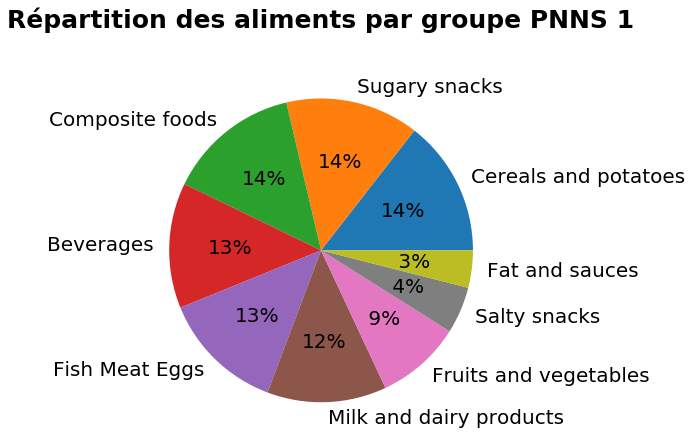

In [10]:
hf.plotPieChart(data_quals, "pnns_groups_1", 6, 6, 
                "Répartition des aliments par groupe PNNS 1", 
                "repartitionAlimentsParGroupePNNS1.png")

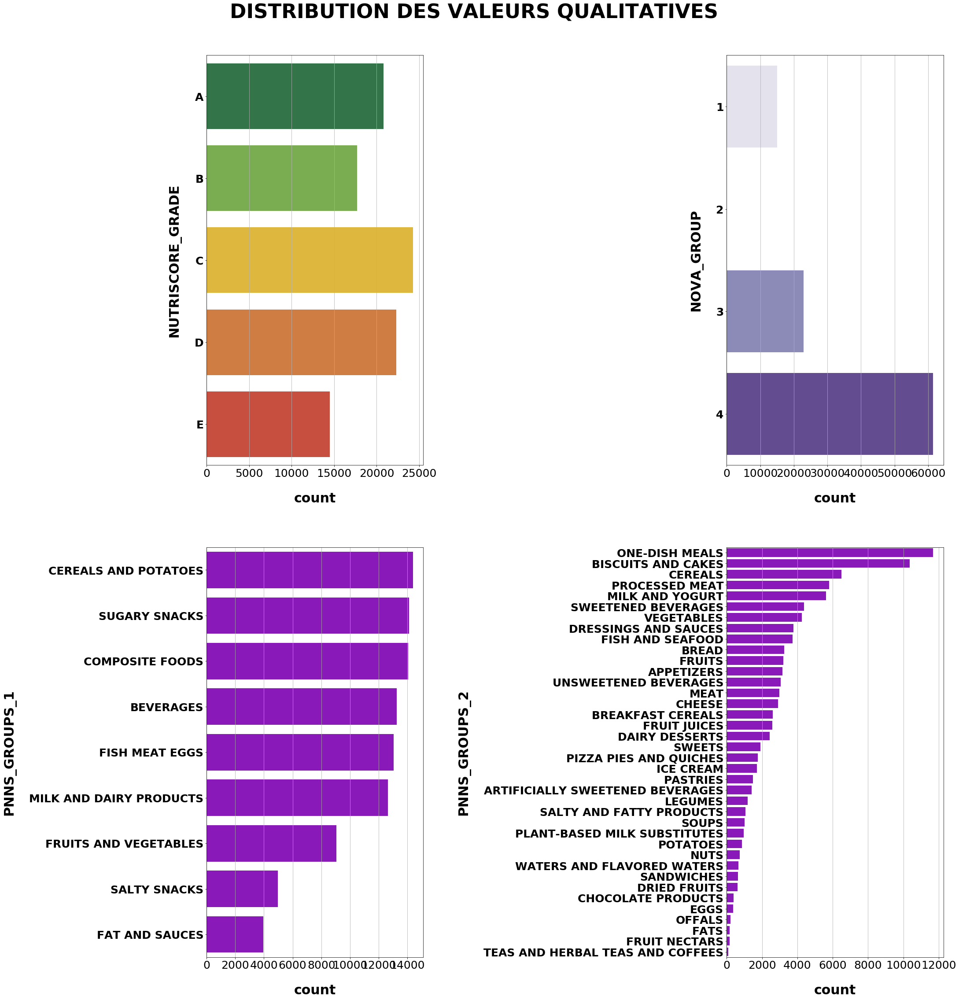

In [11]:
hf.plotQualitativeDist(data_quals, 30, 30)

Sur l'ensemble des aliments considérés : 
- les aliments sont répartis de manière relativement homogène sur l'ensemble des groupes PNNS 1, excepté "Fat and sauces" et "Salty snacks", qui sont comparativement peu représentés.
<br><br>
- On distingue 2 pics dans les groupes PNNS 2 : "Biscuits and cakes" et "One-dish meals". On pourrait caractériser la distribution de bi-modale ici. On distingue plus loin derrière (~/2 par rapport aux premiers pics) 3 plus petits pics : "Cereals", "Milk and yogurt", "Processed meat".
<br><br>
- Une écrasante majorité se trouve dans le groupe NOVA 4, soit les produits ultra-transformés.
- Le Nutri-Score possède une répartition relativement homogène sur les 5 lettres, avec une majorité d'aliments classée 'C', et une minorité classée 'E'.

##### _<u>1.1.2 Valeurs quantitatives</u>_

Pour obtenir une mesure de la dispersion des valeurs pour chaque variable qualitative, nous utiliserons deux outils:
- la représentation graphique des valeurs dans des boîtes à moustaches
- le calcul de la variance et de l'écart-type

_**Boxplots**_

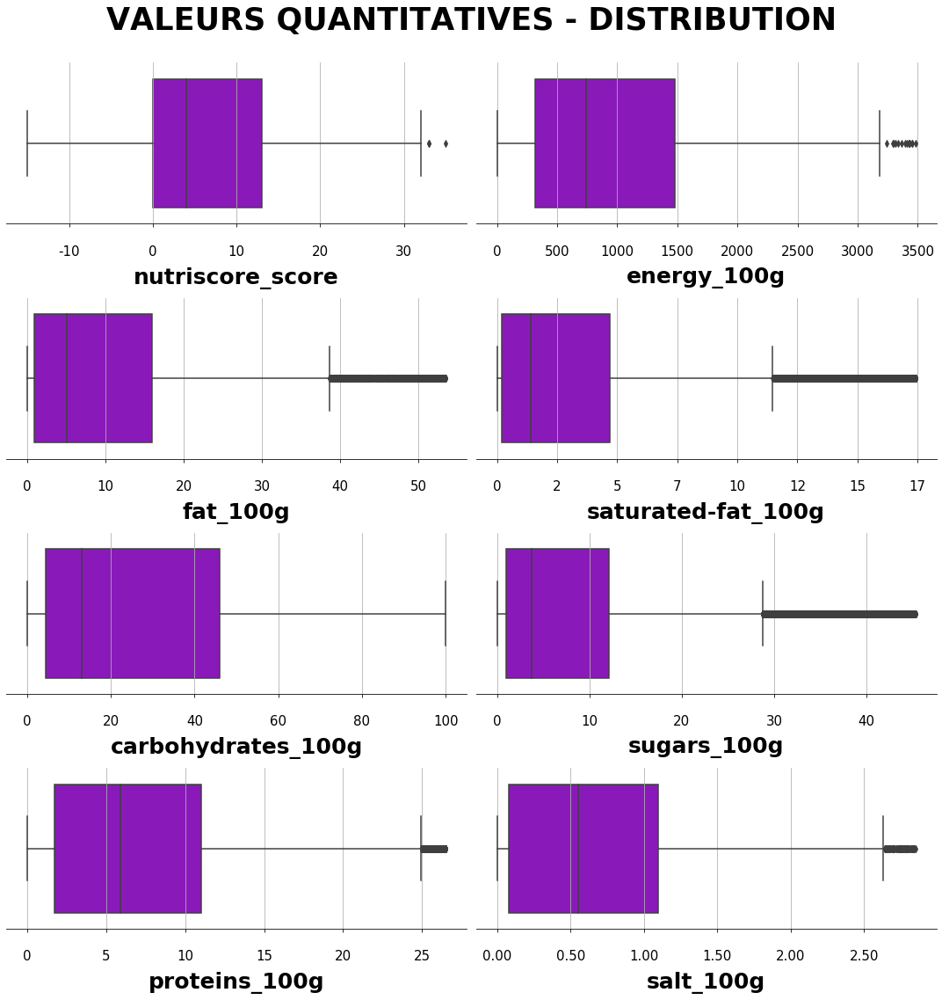

In [12]:
hf.plotBoxPlots(data_quants, 15, 15, 4, 2)

##### Variance et écart-type

In [13]:
pd.concat([pd.DataFrame(data_quants.mean()).rename(columns={0:"Moyenne"}),
           pd.DataFrame(data_quants.var()).rename(columns={0:"Variance"}),
           pd.DataFrame(data_quants.std()).rename(columns={0:"Écart-type"}),
           pd.DataFrame(data_quants.std()/data_quants.mean()).rename(columns={0:"Coeff de Variation"})], 
          axis=1)

,Moyenne,Variance,Écart-type,Coeff de Variation
nutriscore_score,6.514059,68.890868,8.300052,1.274175
energy_100g,908.710136,455625.584501,675.000433,0.742812
fat_100g,9.594424,120.886761,10.994852,1.145963
saturated-fat_100g,3.374177,19.407900,4.405440,1.305634
carbohydrates_100g,24.434362,624.840694,24.996814,1.023019
sugars_100g,8.862752,121.875813,11.039738,1.245633
proteins_100g,7.237810,41.939299,6.476056,0.894753
salt_100g,0.678563,0.453164,0.673175,0.992060


> **Sur l'ensemble des aliments observés, les valeurs des variables considérées sont très dispersées autour de la moyenne.**
>- Les variables <i>saturated-fat_100g</i>, <i>nutriscore_score</i> et <i>sugars_100g</i> présentent la dispersion la plus importante (coeffs de variation de 1.30, 1.27 et 1.24 respectivement).
- La variable <i>energy_100g</i> présente la dispersion la moins importante (coeff de variation = 0.74)

___
#### 1.3 MESURES DE FORME

Des indications sur la forme des distributions nous sont données via deux grandeurs :
- le skewness : donne une mesure de la symétrie de la distribution, et du sens de son étalement dans le cas asymétrique.
- le Kurtosis : donne une mesure de l'aplatissement de la distribution.

In [14]:
pd.concat([pd.DataFrame(data_quants.skew()).rename(columns={0:"Skewness"}),
           pd.DataFrame(data_quants.kurtosis()).rename(columns={0:"Kurtosis"})], axis=1)

,Skewness,Kurtosis
nutriscore_score,0.420048,-0.722101
energy_100g,0.558368,-0.834368
fat_100g,1.419401,1.723234
saturated-fat_100g,1.543597,1.397138
carbohydrates_100g,0.885182,-0.636383
sugars_100g,1.523659,1.365339
proteins_100g,0.967186,0.160139
salt_100g,0.881005,-0.019148


##### _<u>1.3.1 Skewness</u>_
- Si γ1=0 alors la distribution est symétrique.
- Si γ1>0 alors la distribution est étalée à droite.
- Si γ1<0 alors la distribution est étalée à gauche.

> **Les distributions de l'ensemble des variables considérées pour les aliments observés sont toutes plus ou moins étalées sur la droite.**

##### _<u>1.3.2 Kurtosis</u>_
- Si γ2=0, alors la distribution a le même aplatissement que la distribution normale.
- Si γ2>0, alors elle est moins aplatie que la distribution normale : les observations sont plus concentrées.
- Si γ2<0, alors les observations sont moins concentrées : la distribution est plus aplatie.


> - <b>Les distributions suivantes possèdent un aplatissement similaire à celui de la distribution normale :
    * la teneur en protéines
    * la teneur en sel
- Les distributions suivantes possèdent un aplatissement moindre que celui de la distribution normale :
    * la teneur en gras
    * la teneur en graisses saturées
    * la teneur en sucre
- Les distributions suivantes possèdent un aplatissement supérieur à celui de la distribution normale : 
    * le score Nutri-Score
    * la teneur calorique
    * la teneur en carbohydrates</b>

___
#### 1.4 MESURES DE CONCENTRATION

Deux indicateurs sont utilisés pour obtenir une indication de la concentration des distributions:
- la courbe de Lorenz de la variable : plus la courbe de Lorenz est proche de la 1ère bissectrice, plus la répartition est égalitaire, et inversement : plus la courbe de Lorenz s'éloigne de la 1ère bissectrice, plus la répartition est inégalitaire.
- l'indice de Gini de la variable, qui représente 2 fois l'aire présente entre la 1ère bissectrice et la courbe de Lorenz de la variable. Compris dans l'intervalle [0;1], plus l'indice de Gini est élevé, plus la répartition des valeurs au sein de la variable est inégalitaire.

##### _<u>1.4.1 Courbes de Lorenz</u>_

In [15]:
lorenzs, ginis = hf.getLorenzsGinis(data_quants)

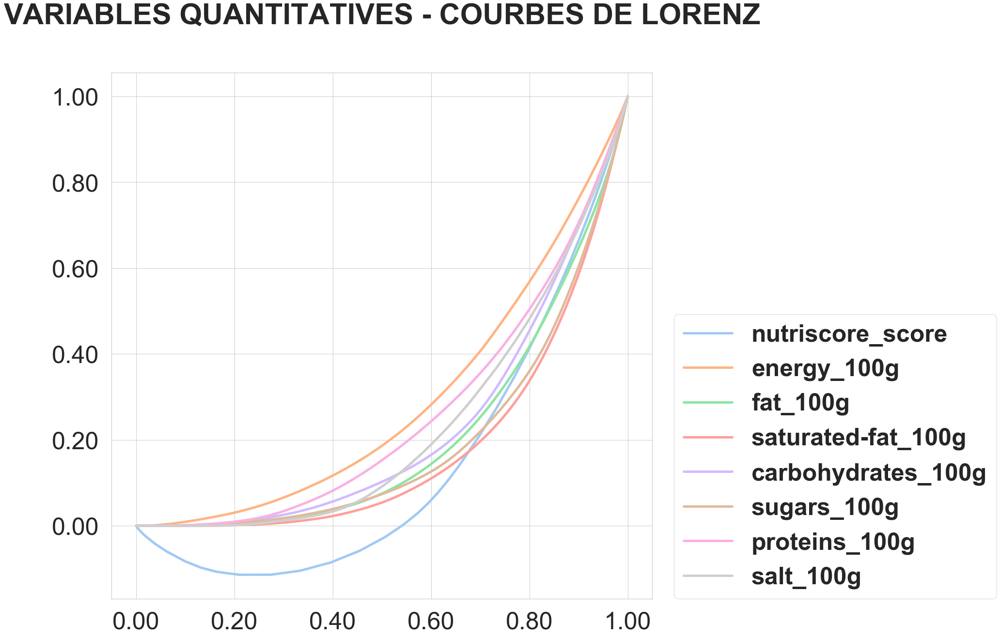

In [16]:
hf.plotLorenz(lorenzs, 20, 20)

Plus la courbe de Lorenz est proche de la première bissectrice, plus la répartition est égalitaire.

> **L'ensemble des valeurs présente une distribution relativement inégalitaire.**

##### _<u>1.4.2 Indice de Gini</u>_

In [17]:
ginis

,Indice Gini
nutriscore_score,0.722966
energy_100g,0.419270
fat_100g,0.591572
saturated-fat_100g,0.645595
carbohydrates_100g,0.549589
sugars_100g,0.619302
proteins_100g,0.488522
salt_100g,0.542160


L'indice de Gini, dont la valeur minimale sur l'ensemble des variables observées est de 0.42, et la valeur maximale est de 0.72, confirme le caractère inégal de la répartition des valeurs des variables sur l'ensemble des aliments observés.

La valeur énergétique (indice de Gini = 0.42) et la teneur en protéines (indice de Gini = 0.49) sont les features ayant la répartition la plus égalitaire sur les aliments considérés.

Le score Nutri-Score (indice de Gini = 0.72) et la teneur en graisse saturées (indice de Gini = 0.65) sont les features ayant la répartition la plus inégalitaire sur les aliments considérés.

___
#### 1.5 CONFIRMATION DES OBSERVATIONS DE L'ANALYSE UNIVARIÉE

L'ensemble des observations obtenues durant l'analyse univariée peut être confirmé en affichant l'histogramme de la distribution avec l'estimation par noyau et le rug plot pour chacune des variables quantitatives.

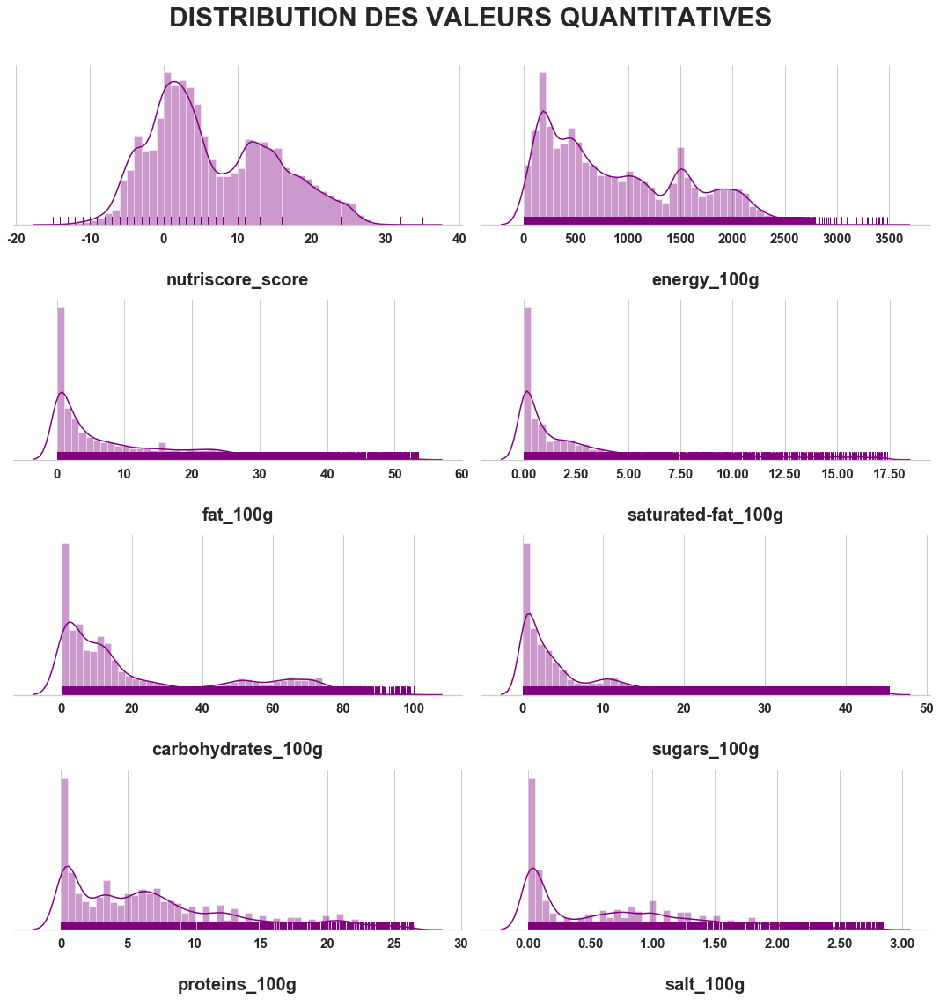

In [18]:
hf.plotDistplotsWithRug(data_quants, 15, 15, 4, 2)

>- **Les informations fournies par les indicateurs de tendance centrale et de dispersion sont confirmés :<br>
l'ensemble des variables montrent des distributions très inégalitaires, étalées sur la droite, avec une dispersion importante des valeurs, et un aplatissement supérieur à celui de la distribution normale.**

>- <b>On constate également que deux variables présentent une distribution bi-modale.</b>

La <u><i>section 1.1.2</i></u> nous avait donné la première valeur modale pour chacune de ces variables. <br>

Recherchons maintenant la 2ème valeur modale pour chacune de ces deux variables :

_<u>SCORE NUTRI-SCORE</u>_

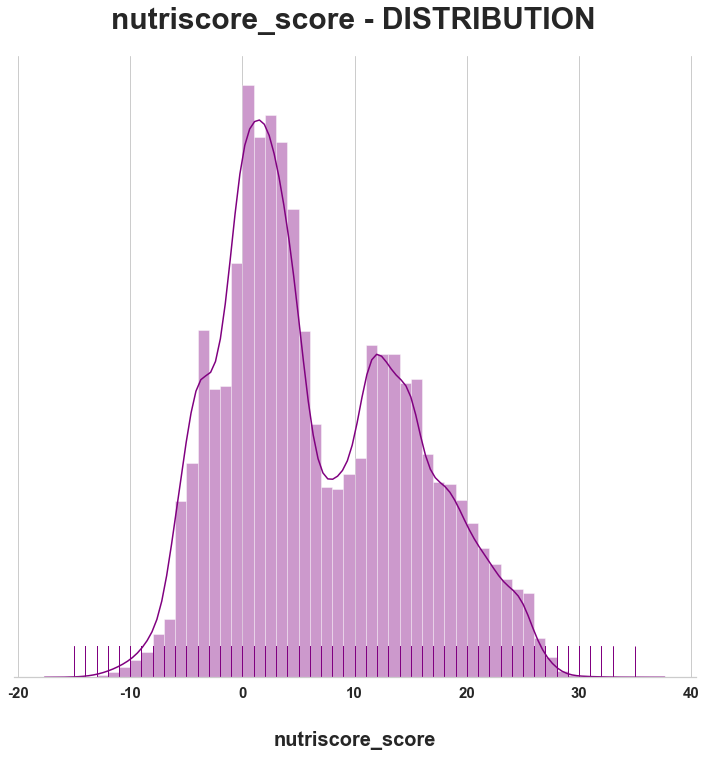

In [19]:
hf.plotDistplotWithRug(data_quants, "nutriscore_score", 10, 10)

In [20]:
mostCommon_nutriscore = pd.DataFrame(Counter(data_quants["nutriscore_score"]).most_common())

In [21]:
# Premier pic 

mostCommon_nutriscore[(mostCommon_nutriscore[0]<= 500) \
                      & 
                      (mostCommon_nutriscore[1] >= 500)].sort_values(by=[1], ascending=False).head(2)

,0,1
0,0.0,6481
1,2.0,6156


In [22]:
# Recherche du deuxième pic

mostCommon_nutriscore[(mostCommon_nutriscore[0]<= 15) & (mostCommon_nutriscore[0]>= 10) \
                      & (mostCommon_nutriscore[1] >= 100)].sort_values(by=[1], ascending=False).head(2)

,0,1
8,11.0,3636
9,12.0,3538


_<u>TENEUR CALORIQUE</u>_

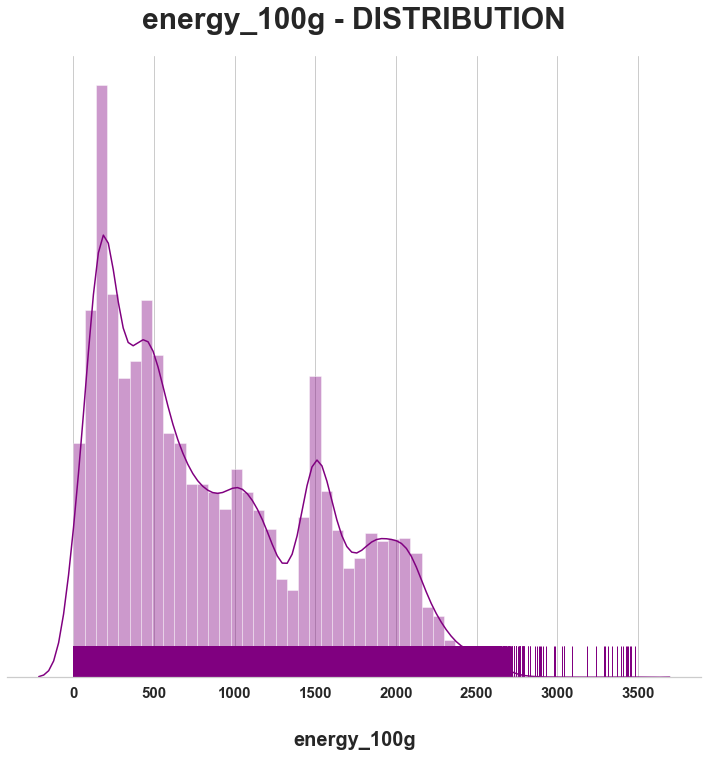

In [23]:
hf.plotDistplotWithRug(data_quants, "energy_100g", 10, 10)

In [24]:
mostCommon_energy = pd.DataFrame(Counter(data_quants["energy_100g"]).most_common())

In [25]:
# Recherche du premier pic 

mostCommon_energy[(mostCommon_energy[0]<= 400) \
                  & 
                  (mostCommon_energy[1] >= 400)].sort_values(by=[1], ascending=False).head(2)

,0,1
0,0.0,1080
1,192.0,765


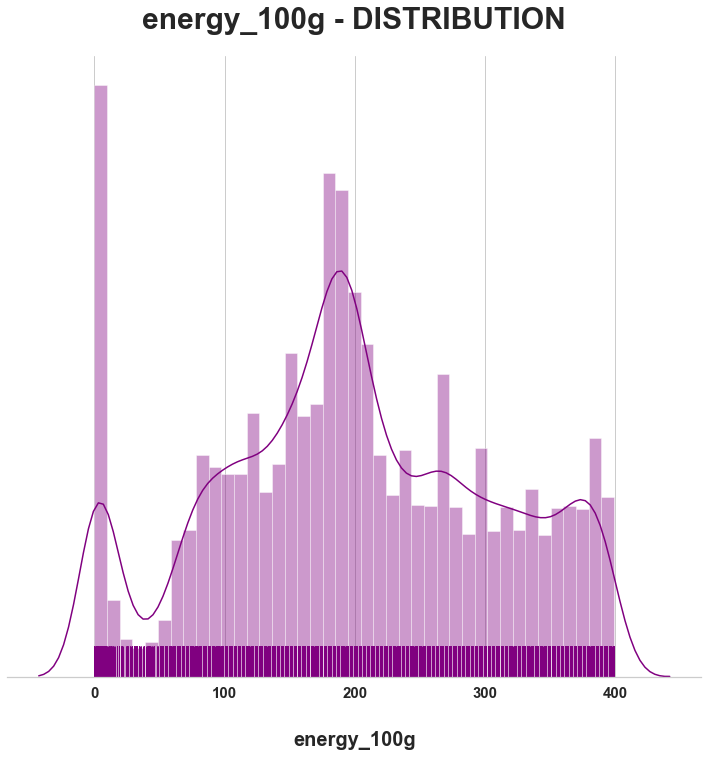

In [26]:
x = data_quants[data_quants["energy_100g"]<400]

hf.plotDistplotWithRug(x, "energy_100g", 10, 10)

In [27]:
# Recherche du deuxième pic

mostCommon_energy[(mostCommon_energy[0]<= 2000) \
                  & (mostCommon_energy[0]>= 1000) \
                  & (mostCommon_energy[1] >= 100)].sort_values(by=[1], ascending=False).head(2)

,0,1
20,1464.0,282
32,1485.0,259


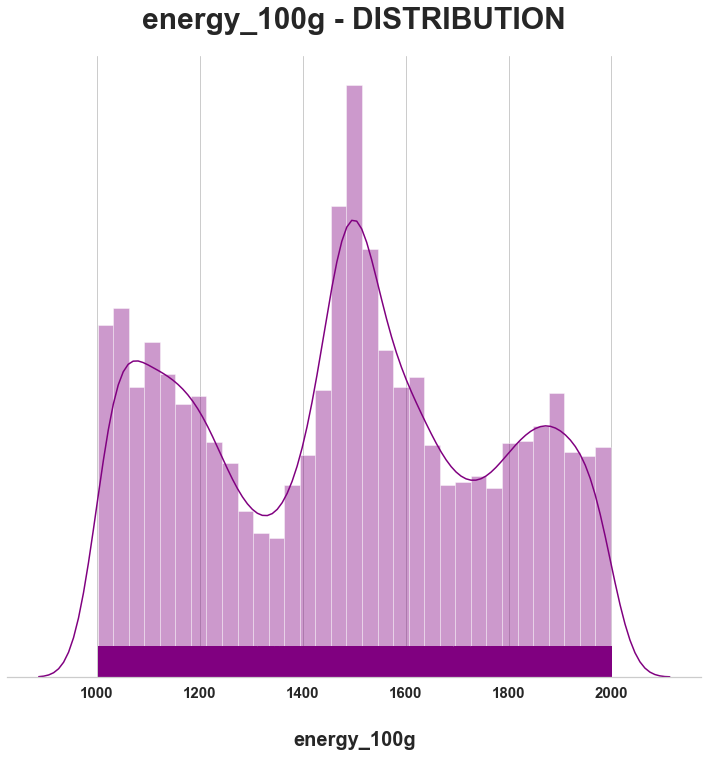

In [28]:
x = data_quants[(data_quants["energy_100g"]<2000) & (data_quants["energy_100g"]>1000)]

hf.plotDistplotWithRug(x, "energy_100g", 10, 10)

>- <b>Les deux valeurs modales du score Nutri-Score (<i>nutriscore_score</i>) sont situées en 0 pour le pic le plus important et en 11 pour le pic plus petit.
- Les deux valeurs modalees de la teneur calorique (<i>energy_100g</i>) sont situées en 0 pour le pic le plus important et en 1464 pour le pic plus petit.

___
### 2. ANALYSE MULTIVARIÉE

___
#### 2.0. MISE EN PLACE

___
##### _<u>2.0.1 Sélection des colonnes pertinentes</u>_

On restreint les colonnes observées : 
- aux groupes PNNS et NOVA
- aux valeurs nutritionnelles
- aux composantes du Nutri-Score (score et lettre)

In [29]:
# Quantitative data

ind_quants = ['nutriscore_score',
              'energy_100g', 'fat_100g', 'saturated-fat_100g', 
              'carbohydrates_100g','sugars_100g',
              'proteins_100g', 'salt_100g'
             ]

data_quants = data_nutri[ind_quants]

In [30]:
# Qualitative data

ind_quals = ['pnns_groups_1', 'pnns_groups_2', 
             'nova_group', 'nutriscore_grade']

data_quals = data_nutri[ind_quals]

In [31]:
data = pd.concat([data_quants, data_quals], axis=1)

___
#### 2.1. ÉTUDE DES RELATIONS ENTRE VARIABLES QUALITATIVES

Pour mettre en lumière les relations éventuelles entre variables qualitatives, l'analyse aura recours à 2 outils : 
- le tableau de contingence, qui montre les effectifs par combinaisons de modalités.
- le test du Khi-2, qui permet de rejeter ou non l'hypothèse d'indépendance des variables.

**Test du Khi-2 d'indépendance**

Ce test permet de vérifier l'absence de lien statistique entre deux variables X et Y. 

L'hypothèse nulle H0 dans ce test est que les variables considérées sont indépendantes, c'est-à-dire que la connaissance de l'une ne permet en aucune manière de se prononcer sur l'autre.

<i><u>Interprêtation de la valeur du test statistique</u></i>

Pour interprêter la valeur du Khi-2, on récupère la valeur de la distribution Khi-2 pour un nombre de degrés de liberté et une probabilité donnée de ne pas se tromper en rejetant l'hypothèse nulle.

Par convention, on rejette le plus souvent l'hypothèse d'indépendance lorsque l'on a au maximum 5% de chance de se tromper. On va donc dire que l'on rejette l'hypothèse d'indépendance au seuil de 95%, qui représente notre valeur critique. Autrement dit, on rejette l'hypothèse d'indépendance entre les lignes et les colonnes de notre tableau avec 95% de chances de ne pas se tromper ou bien avec 5% (qui est la valeur p) de chance de se tromper.

<i><u>Interprêtation de la valeur de la valeur p</u></i>

La valeur p est la probabilité pour qu'un modèle statistique donné sous l'hypothèse nulle obtienne la même valeur ou une valeur encore plus extrême que celle proposée.

En termes de valeur p, l'hypothèse nulle est généralement rejetée lorsque p ≤ 0,05.

##### _<u>2.1.1 Entre la lettre du Nutri-Score et le groupe PNNS 1</u>_

In [32]:
(pnns1_contingency, table_khi2_pnns1, 
stat_pnns1, p_pnns1, dof_pnns1, 
expected_table_pnns1) = hf.getContingencyKhi2Data(data, "nutriscore_grade", "pnns_groups_1")

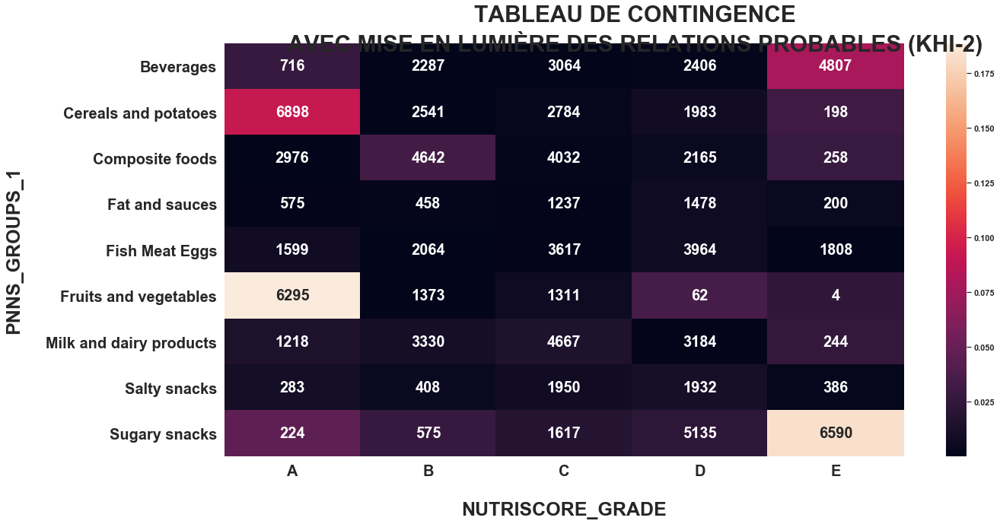

In [33]:
hf.plotContingencyTableHeatmap(pnns1_contingency, table_khi2_pnns1, 20, 10)

En lisant la table dans le sens des colonnes, on observe que :
- la majeure partie des aliments notés "A" sont situés dans les groupes PNNS 1 "Cereals and potatoes" et "Fruits and vegetables"
- la majeure partie des aliments notés "B" sont situés dans le groupe PNNS 1 "Composite foods" puis "Milk and dairy products"
- la majeure partie des aliments notés "C" sont situés dans les groupes PNNS 1 "Milk and dairy products" et "Composite foods"
- la majeure partie des aliments notés "D" sont situés dans les groupes PNNS 1 "Sugary snacks" et "Fish Meat Eggs"
- la majeure partie des aliments notés "E" sont situés dans les groupes PNNS 1 "Sugary snacks" puis "Beverages"

En lisant la table dans le sens des lignes, on peut également dire que : 
- la majeure partie des produits du groupe PNNS 1 "Beverages" sont notés "E"
- la majeure partie des produits du groupe PNNS 1 "Cereals and potatoes" sont notés "A"
- la majeure partie des produits du groupe PNNS 1 "Composite foods" sont notés "B"
- la majeure partie des produits du groupe PNNS 1 "Fat and sauces" sont notés "D" et "C"
- la majeure partie des produits du groupe PNNS 1 "Fish Meat Eggs" sont notés "D" et "C"
- la majeure partie des produits du groupe PNNS 1 "Fruits and vegetables" sont notés "A"
- la majeure partie des produits du groupe PNNS 1 "Milk and dairy products" sont notés "C"
- la majeure aprtie des produits du groupe PNNS 1 "Salty snacks" sont notés "C" et "D"
- la majeure partie des produits du groupe PNNS 1 "Sugary snacks" sont notés "E"

> **Il semble y avoir une corrélation entre l'appartenance à un groupe PNNS 1 et la lettre Nutri-Score obtenue, en particulier pour les 2 extrêmes A et E.**

On peut le vérifier à l'aide du test Khi-2 :

_<u>Interprêtation du test du Khi-2</u>_

Le Khi-2 nous fournit les valeurs suivantes :

In [34]:
print("Test statistique : ", stat_pnns1)
print("P-value : ", p_pnns1)

Test statistique :  54541.90633984219
P-value :  0.0


Ces valeurs peuvent être interprêtées pour permettre de rejeter ou non l'hypothèse d'indépendance entre les variables _<b>pnns_groups_1</b> et _<b>nutriscore_grade</b>_ :

In [35]:
hf.areDependent(stat_pnns1, dof_pnns1, p_pnns1, prob=0.95)

The variables are dependent - H0 rejected


Sur la base du seuil fourni et des valeurs du test statistique et de la p-value, le test du Khi-2 permet de déterminer que les variables _<b>pnns_groups_1</b>_ et _<b>nutriscore_grade</b>_ ont une relation de dépendance.

##### _<u>2.1.2 Entre la lettre du Nutri-Score et le groupe PNNS 2</u>_

In [36]:
(pnns2_contingency, table_khi2_pnns2, 
stat_pnns2, p_pnns2, dof_pnns2, 
expected_table_pnns2) = hf.getContingencyKhi2Data(data, "nutriscore_grade", "pnns_groups_2")

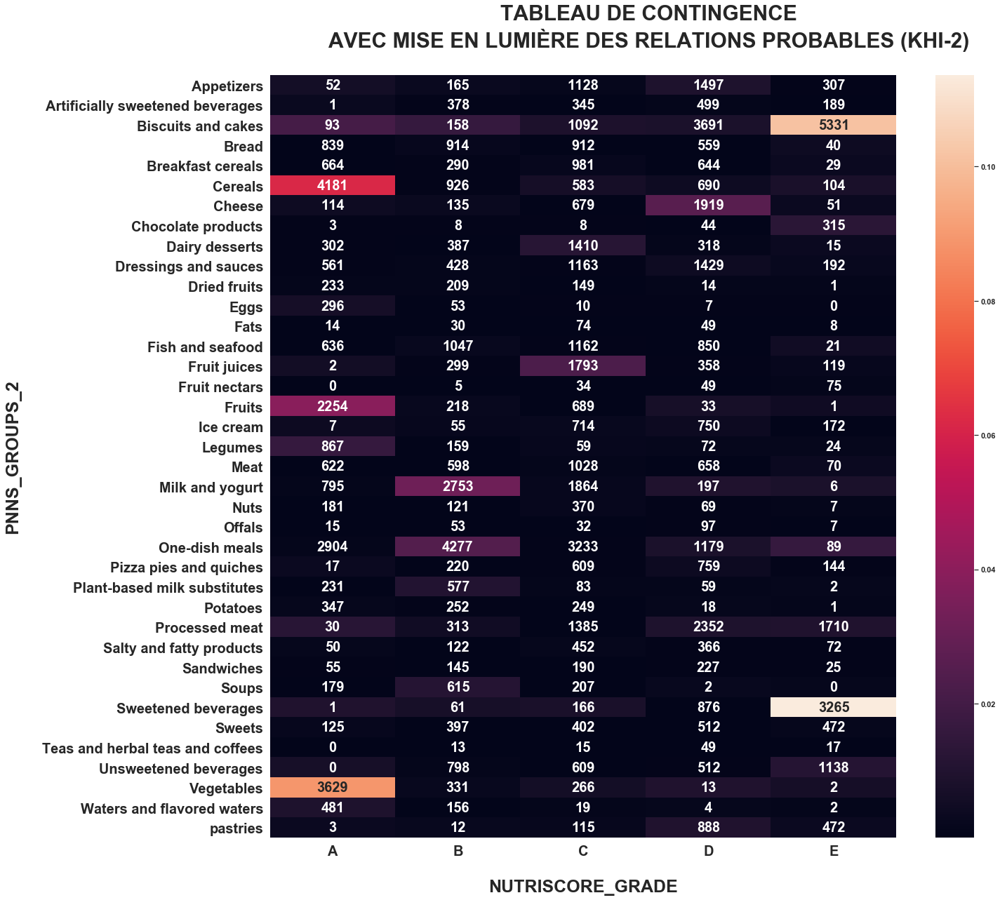

In [37]:
hf.plotContingencyTableHeatmap(pnns2_contingency, table_khi2_pnns2, 20, 20)

En lisant la table dans le sens des colonnes, on observe que :
- la majeure partie des aliments notés "A" sont situés dans les groupes PNNS 2 "Cereals" puis "Vegetables"
- la majeure partie des aliments notés "B" sont situés dans le groupe PNNS 2 "One-dish meals" puis "Milk and yogurt"
- la majeure partie des aliments notés "C" sont situés dans le groupe PNNS 2 "One-dish meals"
- la majeure partie des aliments notés "D" sont situés dans les groupes PNNS 2 "Biscuits and cakes" puis "Processed Meat"
- la majeure partie des aliments notés "E" sont situés dans le groupe PNNS 2 "Biscuits and cakes", puis "Sweetened beverages"

En lisant la table dans le sens des lignes, on peut également dire que : 
- la majeure partie des produits du groupe PNNS 2 "Biscuits and cakes" sont notés "E" et "D"
- la majeure partie des produits du groupe PNNS 2 "Cereals" sont notés "A"
- la majeure partie des produits du groupe PNNS 2 "Fruits" sont notés "A"
- la majeure partie des produits du groupe PNNS 2 "Milk and yoghurt" sont notés "B"
- la majeure partie des produits du groupe PNNS 2 "One-dish meals" sont notés "B"
- la majeure partie des produits du groupe PNNS 2 "Processed meat" sont notés "D" (puis "E", puis "C")
- la majeure partie des produits du groupe PNNS 2 "Sweetened beverages" sont notés "E"
- la majeure partie des produits du groupe PNNS 2 "Vegetables" sont notés "A"

> **Il semble y avoir une corrélation entre l'appartenance à un groupe PNNS 2 et la lettre Nutri-Score obtenue.**

_<u>Interprêtation du test du Khi-2</u>_

Le Khi-2 nous fournit les valeurs suivantes :

In [38]:
print("Test statistique : ", stat_pnns2)
print("P-value : ", p_pnns2)

Test statistique :  95609.6136380486
P-value :  0.0


Ces valeurs peuvent être interprêtées pour permettre de rejeter ou non l'hypothèse d'indépendance entre les variables _<b>pnns_groups_2</b>_ et _<b>nutriscore_grade</b>_ :

In [39]:
hf.areDependent(stat_pnns2, dof_pnns2, p_pnns2, prob=0.95)

The variables are dependent - H0 rejected


Sur la base du seuil fourni et des valeurs du test statistique et de la p-value, le test du Khi-2 permet de déterminer que les variables _<b>pnns_groups_2</b>_ et _<b>nutriscore_grade</b>_ ont une relation de dépendance.

##### _<u>2.1.3 Entre la lettre du Nutri-Score et la classification nova</u>_

In [40]:
(nova_contingency, table_khi2_nova, 
stat_nova, p_nova, dof_nova, 
expected_table_nova) = hf.getContingencyKhi2Data(data, "nutriscore_grade", "nova_group")

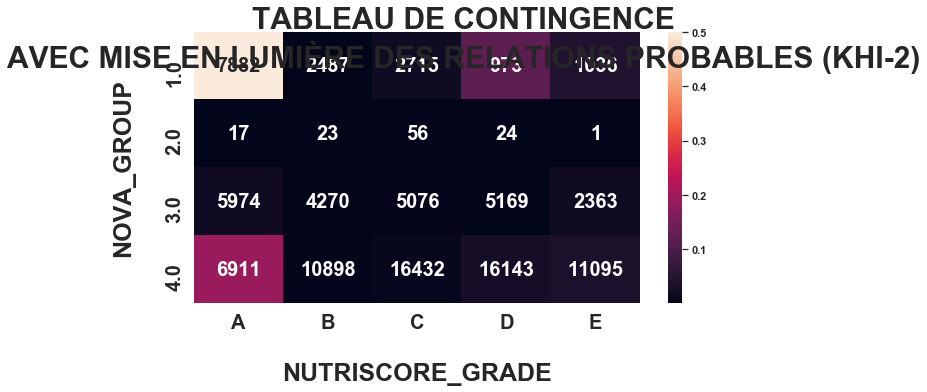

In [41]:
hf.plotContingencyTableHeatmap(nova_contingency, table_khi2_nova, 10, 5)

En lisant la table dans le sens des colonnes, on observe que :
- la majeure partie des aliments notés "A" sont classés 1, puis 4 et 3
- la majeure partie des aliments notés "B", "C", "D" ou "E" sont classés 4

En lisant la table dans le sens des lignes, on peut également dire que : 
- la majeure partie des produits classés 1 sont notés "A"
- la majeure partie des produits sont classés 4, quelle que soit leur lettre Nutri-Score.

> **Il semble exister une légère corrélation entre le classement NOVA et la lettre Nutri-Score obtenue.**

_<u>Interprêtation du test du Khi-2</u>_

Le Khi-2 nous fournit les valeurs suivantes :

In [42]:
print("Test statistique : ", stat_nova)
print("P-value : ", p_nova)

Test statistique :  14172.929015076643
P-value :  0.0


Ces valeurs peuvent être interprêtées pour permettre de rejeter ou non l'hypothèse d'indépendance entre les variables _<b>nova_group</b>_ et _<b>nutriscore_grade</b>_ :

In [43]:
hf.areDependent(stat_nova, dof_nova, p_nova, prob=0.95)

The variables are dependent - H0 rejected


Sur la base du seuil fourni et des valeurs du test statistique et de la p-value, le test du Khi-2 permet de déterminer que les variables _<b>nova_group</b>_ et _<b>nutriscore_grade</b>_ ont une relation de dépendance.

___
#### 2.2. ÉTUDE DES RELATIONS ENTRE VARIABLES QUANTITATIVES

##### _<u>2.2.1 Diagramme par paires de l'ensemble des variables qualitatives</u>_

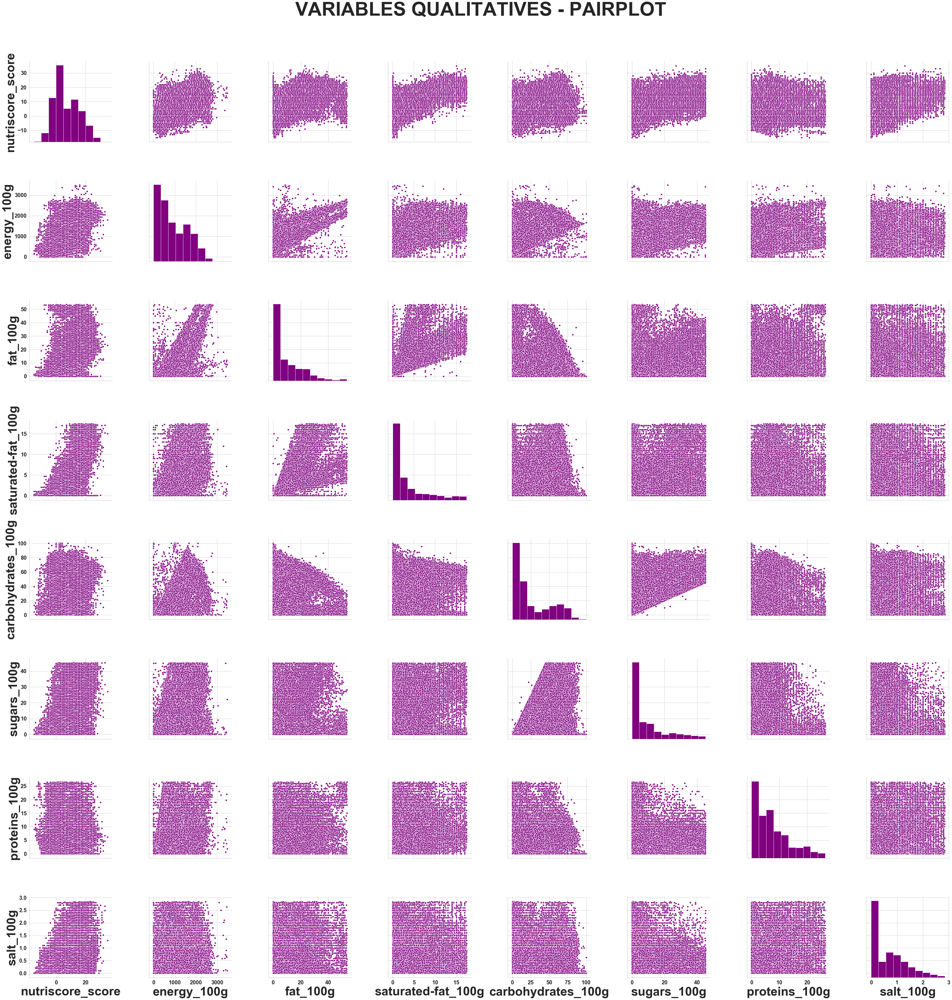

In [44]:
hf.plotPairplot(data_quants, 6)

Cette vue d'ensemble permet de suggérer l'existence d'une relation entre certaines variables, en particulier entre : 
- la teneur en gras et le score Nutri-Score : plus la teneur en gras est importante, plus le score Nutri-Score est mauvais.
- la teneur en gras saturés et le score Nutri-Score : plus la teneur en gras saturé est importante, plus le score Nutri-Score est mauvais. L'effet est plus accentué que celui de la simple teneur en gras.
- la teneur en sucres et le score Nutri-Score : plus la teneur en sucres est importante, plus le score Nutri-Score est mauvais. L'effet est moins accentué que celui de la teneur en gras.
- la teneur en protéines et le score Nutri-Score : plus la teneur en protéiens est importante, plus le score Nutri-Score est bon. L'effet est moins accentué que celui de la teneur en sucre.

On observe également les relations attendues, à savoir entre : 
- la teneur en carbohydrates et la teneur en sucres : plus la teneur en carbohydrates est importante, plus la teneur en sucres est importante.
- la teneur en gras et la teneur en gras saturé : plus la teneur en gras est importante, plus la teneur en gras saturé est importante.

Vérifions ces observations mathématiquement.

##### _<u>2.2.2 Coefficient de corrélation de Pearson</u>_

Le coefficient de Pearson est la division de la covariance par le produit des écarts-types. Prenant des valeurs entre sur [-1,1], ce coefficient traduit les relations linéaires entre variables.<br>
_<u>Plus sa valeur est proche de 1, plus les variables concernées ont une relation linéaire entre elles.</u>_

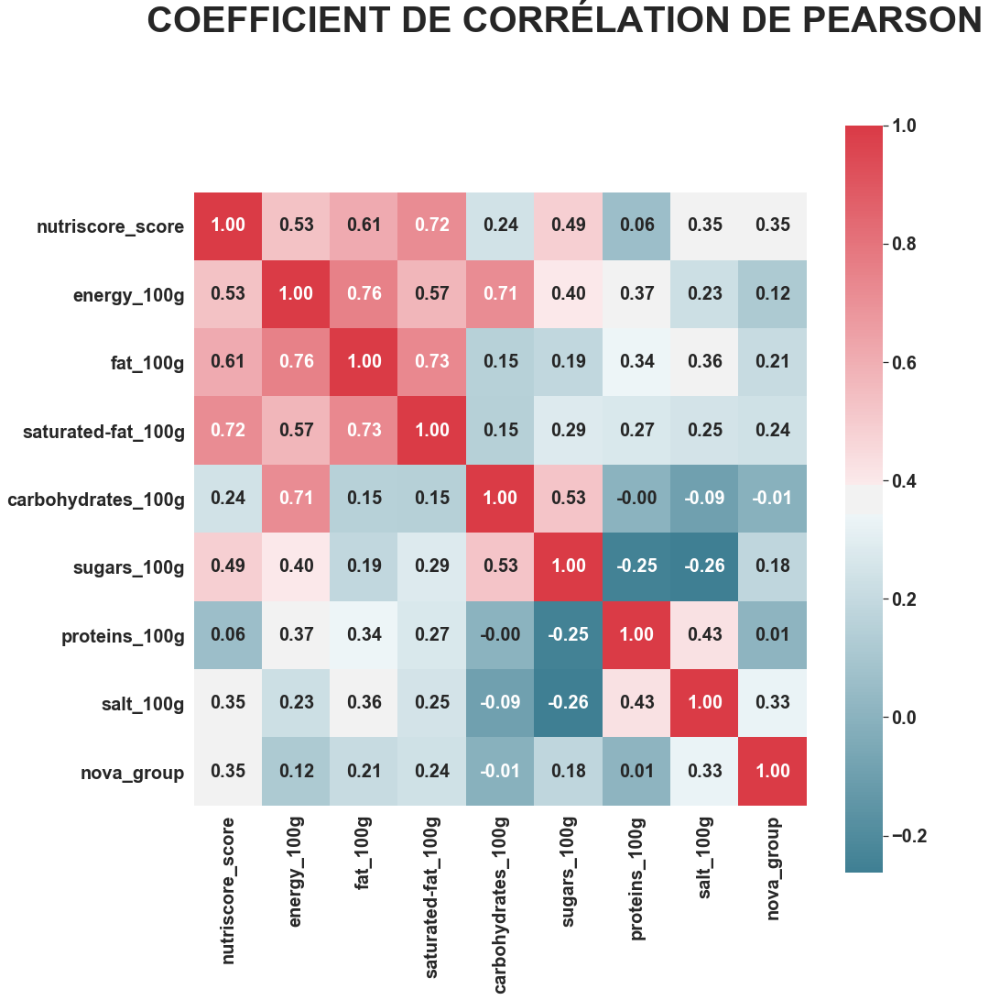

In [45]:
hf.plotCorrelationHeatMap(data, "pearson", 15, 15)

À première vue, les zones rouges / roses traduisant des corrélations linéaires fortes se concentrent essentiellement dans le cadran en haut à gauche. Il s'agit des colonnes:
- _nutriscore_score_
- _energy_100g_
- _fat_100g_
- _saturated-fat_100g_

Des paires de variables corrélées sont également visibles le long de la diagonale, à savoir :
- la teneur en carbohydrates et la teneur en sucres
- la teneur en protéines et la teneur en sel

L'observation de la ligne du _nutriscore_score_ met en lumière les relations linéaires avec les colonnes suivantes :
- importante avec la teneur en graisses saturées et en graisses (0.72 et 0.61 respectivement)
- relation linéaire avec la valeur énergétique et la teneur en sucre (0.53 et 0.49 respectivement)
- relation linéaire légère avec la teneur en sel et le classement nova, le nombre d'additifs)
- relation linéaire très faible avec la teneur en protéines

##### _<u>2.2.3 Coefficient de corrélation de Spearman</u>_

Le coefficient de Pearson traduit l'existence d'une relation parfaitement monotone entre deux variables, que cette relation soit linéaire ou non.<br>
Comme le coefficient de corrélation de Pearson, il prend des valeurs entre sur [-1;1], et plus sa valeur est proche de 1, plus les variables concernées ont une relation monotone entre elles.

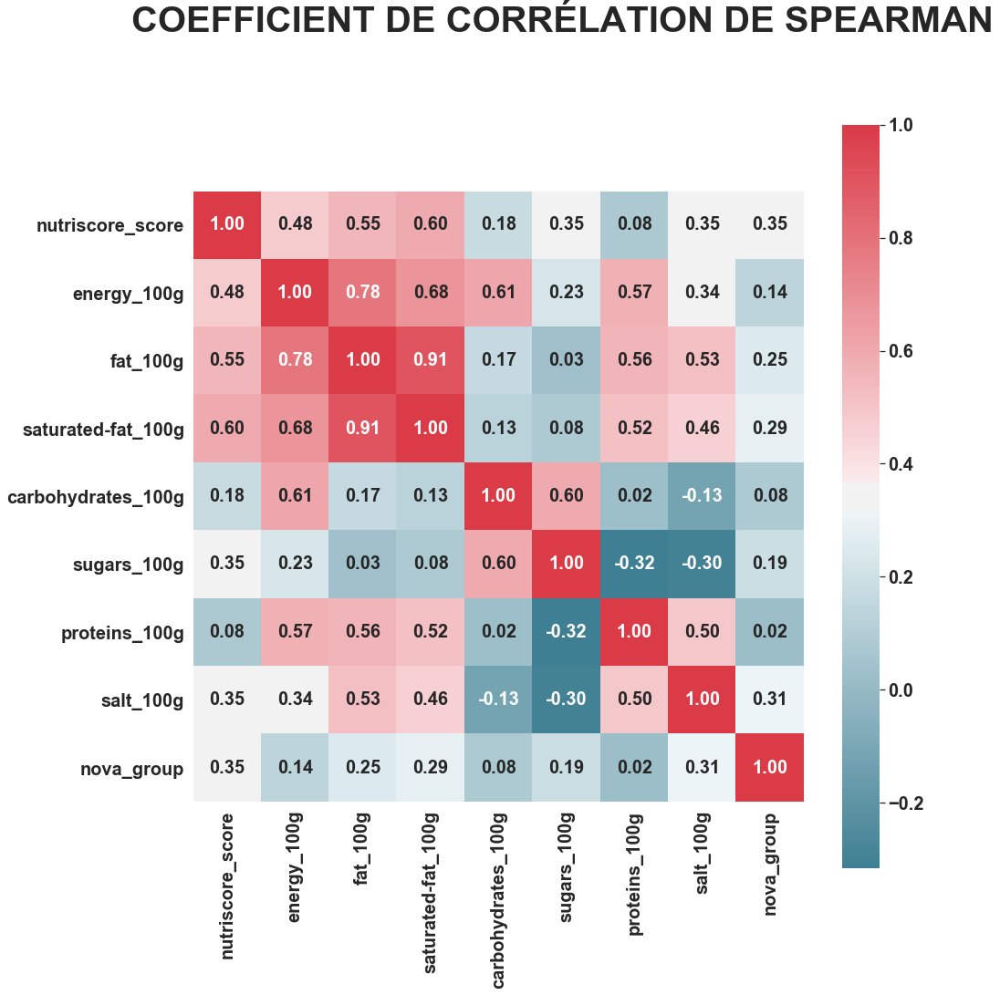

In [46]:
hf.plotCorrelationHeatMap(data, "spearman", 15, 15)

Tout comme le diagramme pour le coefficient de corrélation de Pearson, on constate que les zones rouges / roses traduisant des corrélations linéaires fortes se concentrent essentiellement dans le cadran en haut à gauche.
On retrouve les mêmes colonnes que pour le coefficient de corrélation de Pearson:
- _nutriscore_score_ 
- _energy_100g_
- _fat_100g_ 
- _saturated-fat_100g_

On retrouve également les mêmes paires de variables corrélées le long de la diagonale, à savoir :
- la teneur en carbohydrates et la teneur en sucre
- la teneur en protéines et la teneur en sel

À ces observations vient s'ajouter la mise en évidence de nouvelles corrélations entre :
- la teneur en protéines et la valeur énergétique (0.57)
- la teneur en protéines et les teneurs en graisses et graisses saturées (0.56 et 0.52 respectivement)
- la teneur en sel et les teneurs en graisses et graisses saturées (0.53 et 0.46 respectivement)

L'observation de la ligne du _nutriscore_score_ met en lumière les mêmes relations que celles du coefficient de corrélation de Pearson, avec une baisse globale du coefficient sur les valeurs les plus élevées, mais une hausse de la corrélation avec la teneur en protéines, et l'apparition de nouvelles relations monotones entre le sel et les teneurs en gras et gras saturé.

___
#### 2.3. ÉTUDE DES RELATIONS ENTRE VARIABLES QUALITATIVES ET QUANTITATIVES

##### _<u>2.3.1 Entre les valeurs qualitatives et le score Nutri-Score</u>_

###### Entre PNNS 1 et le score Nutri-Score

<Figure size 432x288 with 0 Axes>

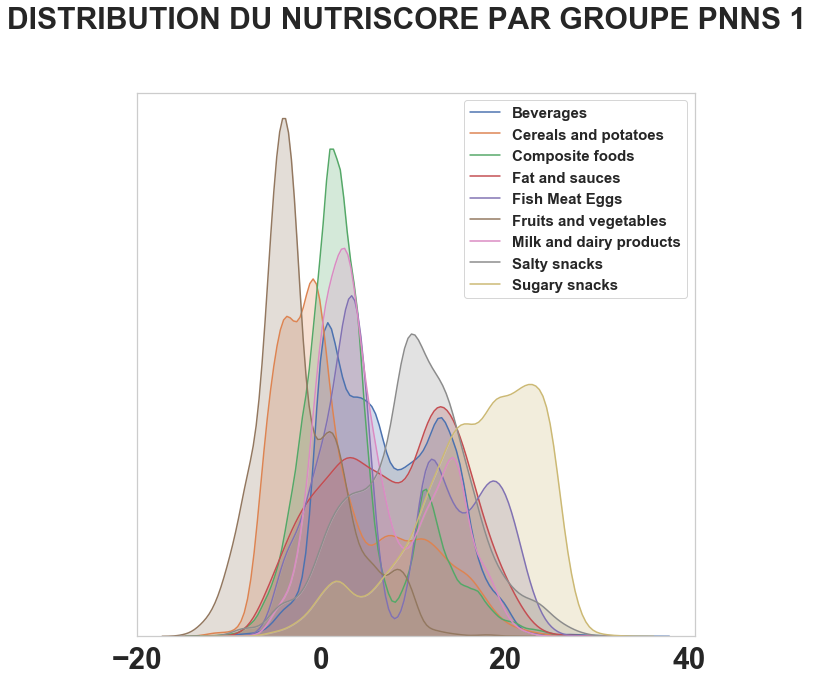

In [47]:
hf.plotKDE(data, "nutriscore_score", "pnns_groups_1", 10, 10)

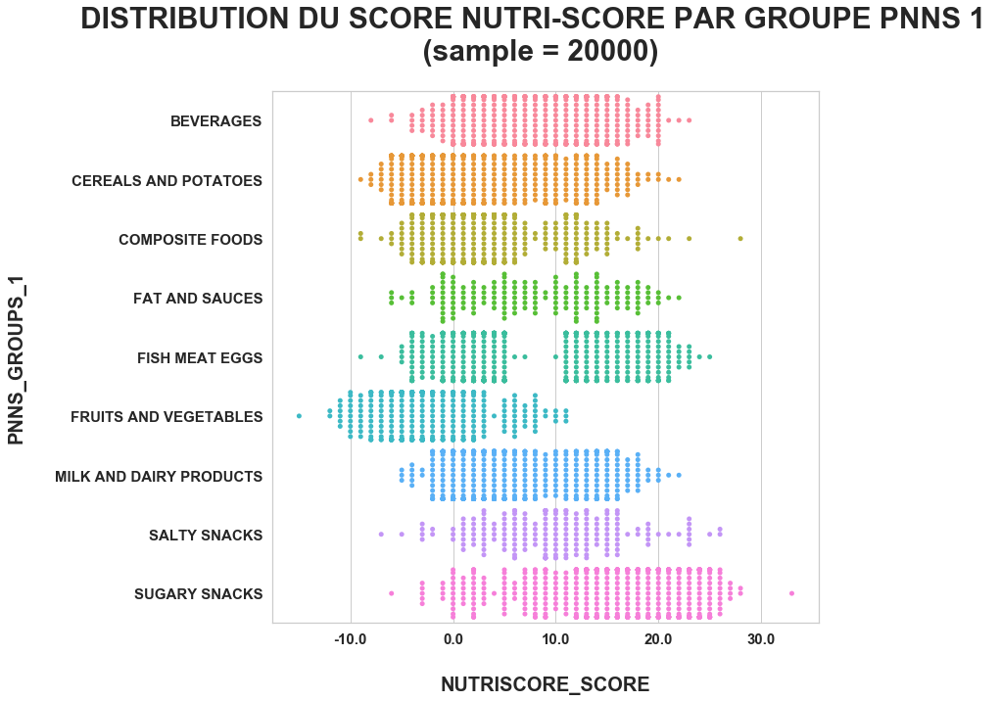

In [48]:
hf.plotSwarmplot(data, "nutriscore_score", "pnns_groups_1", 
                 "DISTRIBUTION DU SCORE NUTRI-SCORE PAR GROUPE PNNS 1 \n (sample = 20000)",
                 10, 10, 0)

Les observations suivantes ressortent des graphiques ci-dessus : 
- les aliments du groupe PNNS 1 "Fruits and vegetables" ont majoritairement de très bons scores Nutri-Score (entre 0 et -10)
- les aliments du groupe PNNS 1 "Sugary snacks" ont majoritairement de très mauvais scores Nutri-Score(>11)
- les aliments du groupe PNNS 1 "Fish Meat Eggs" sont divisés en 2 groupes à peu près égaux, avec de bonnes valeurs de scores Nutri-Score pour l'un (entre 5 et -5) et de mauvaises valeurs de scores Nutri-Scores pour l'autre (entre 11 et 25)

Observons de plus près les composantes nutritionnelles pour ces groupes extrêmes : 

In [49]:
data_df1 = data.query("pnns_groups_1 == 'Sugary snacks'")
data_df2 = data.query("pnns_groups_1 == 'Fruits and vegetables'")
data_df3 = data.query("pnns_groups_1 == 'Fish Meat Eggs'")

_<u>TENEUR EN SUCRES</u>_

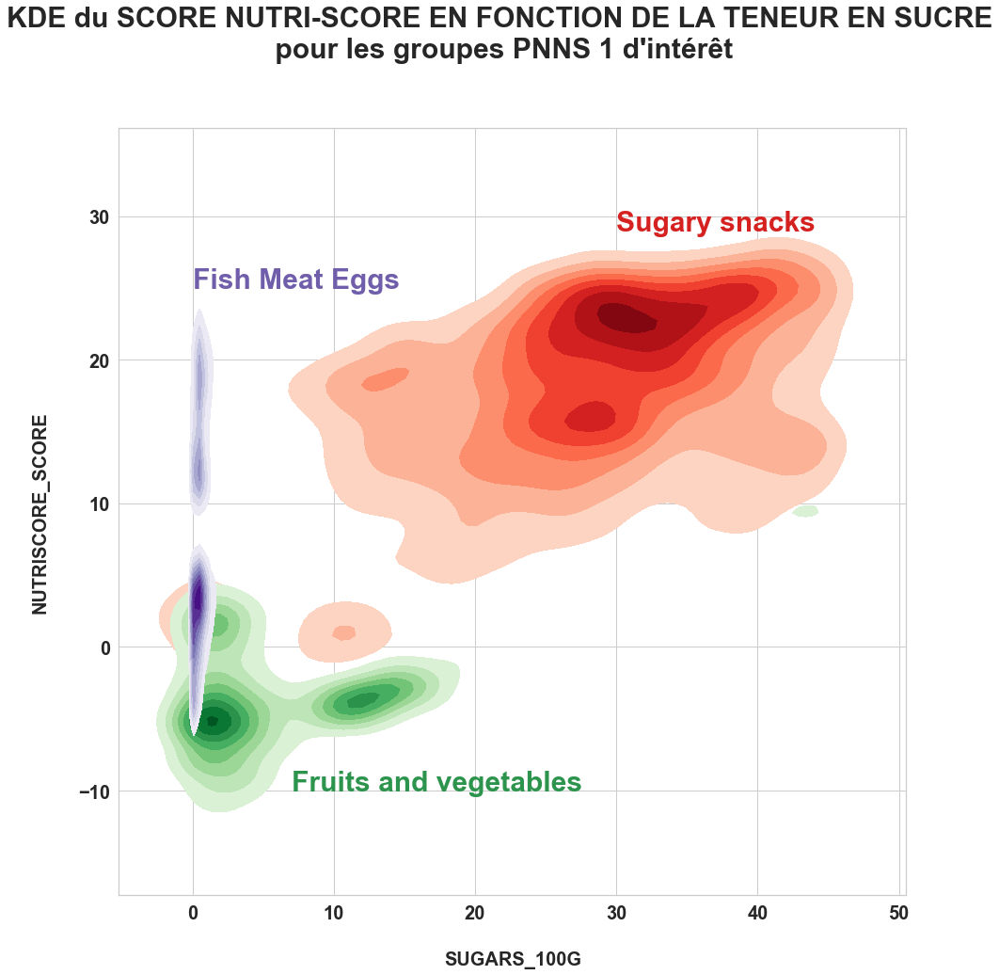

In [50]:
data_kdeplotShades = {
    
    "Sugary snacks":{"data":data_df1,
                     "legend_info" : (30, 29),
                     "palette": "Reds"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (7, -10),
                             "palette": "Greens"},
    
    "Fish Meat Eggs":{"data":data_df3,
                      "legend_info" : (0, 25),
                      "palette": "Purples"},
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "sugars_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SUCRE\n pour les groupes PNNS 1 d'intérêt",
                          15, 15)

>- **Les observations semblent indiquer que plus la teneur en sucres d'un produit est élevée, plus son score Nutri-Score est mauvais.**
- **Toutefois, la teneur en sucres semble ne pas être le seul facteur déterminant puisqu'une partie de la catégorie "Fish Meat Eggs", bien que pauvres en sucres, a également de mauvais scores Nutri-Score.**

_<u>TENEUR EN GRAISSES SATURÉES</u>_

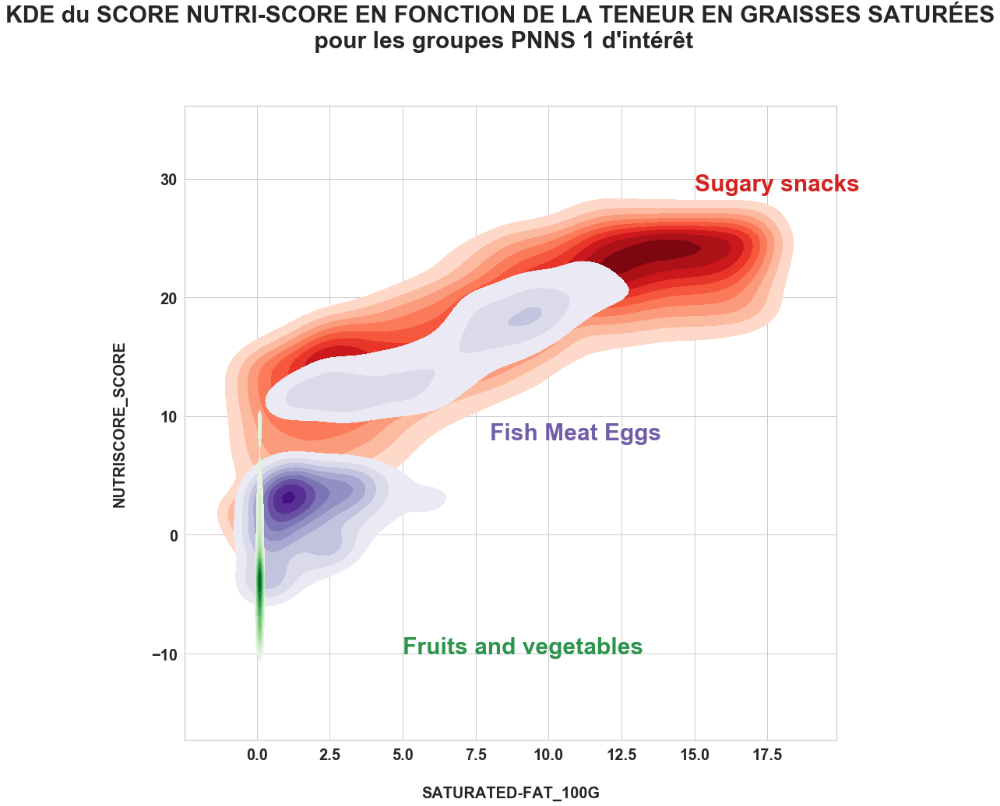

In [51]:
data_kdeplotShades = {
    
    "Sugary snacks":{"data":data_df1,
                     "legend_info" : (15, 29),
                     "palette": "Reds"},
    
    "Fish Meat Eggs":{"data":data_df3,
                      "legend_info" : (8, 8),
                      "palette": "Purples"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (5, -10),
                             "palette": "Greens"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "saturated-fat_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN GRAISSES SATURÉES\n pour les groupes PNNS 1 d'intérêt",
                          15, 15)

>- **Les observations semblent indiquer que plus la teneur en gras saturé d'un produit est élevée, plus son score Nutri-Score est mauvais.**

_<u>TENEUR EN PROTÉINES</u>_

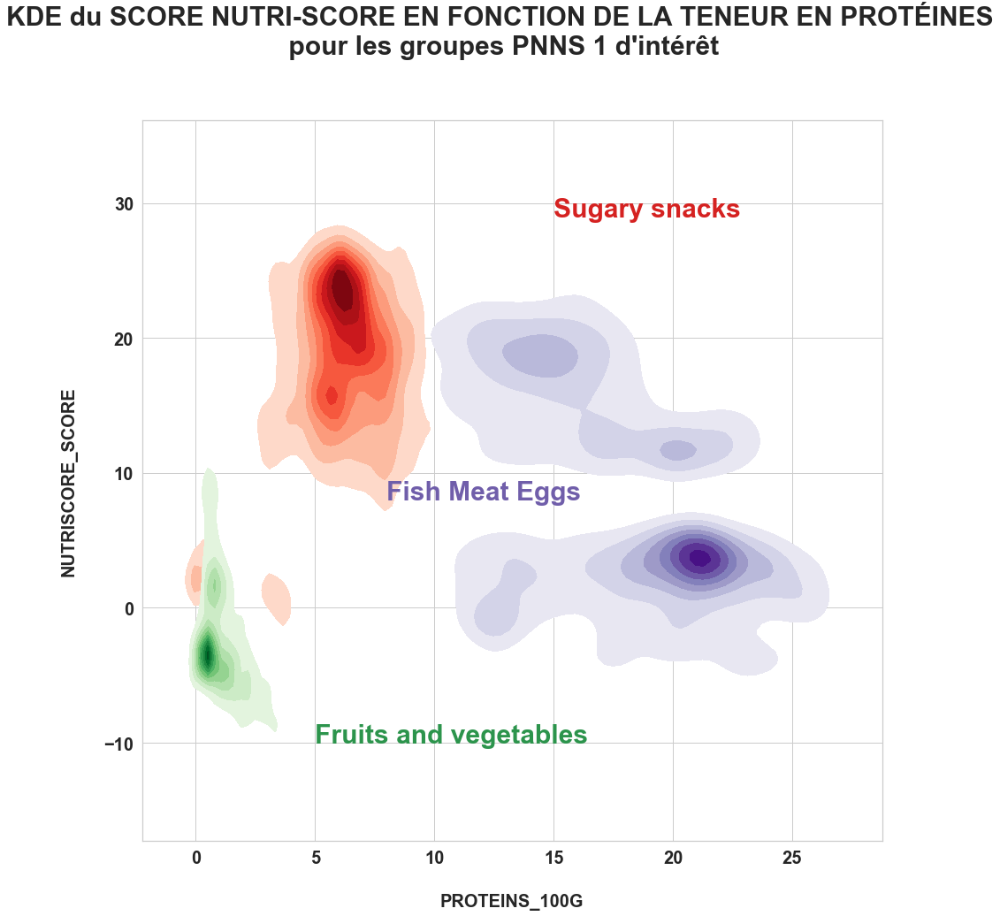

In [52]:
data_kdeplotShades = {
    
    "Sugary snacks":{"data":data_df1,
                     "legend_info" : (15, 29),
                     "palette": "Reds"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (5, -10),
                             "palette": "Greens"},
    
    "Fish Meat Eggs":{"data":data_df3,
                      "legend_info" : (8, 8),
                      "palette": "Purples"},
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "proteins_100g", "nutriscore_score", 1,
                         "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN PROTÉINES\n pour les groupes PNNS 1 d'intérêt",
                         15, 15)

>- **Les observations semblent indiquer une influence méliorative de la teneur en protéines sur le score Nutri-Score.**
- **Toutefois, cette influence positive ne semble pas pouvoir compenser l'impact négatif d'une teneur en sucres ou en graisses saturées importante.**

_<u>TENEUR EN SEL</u>_

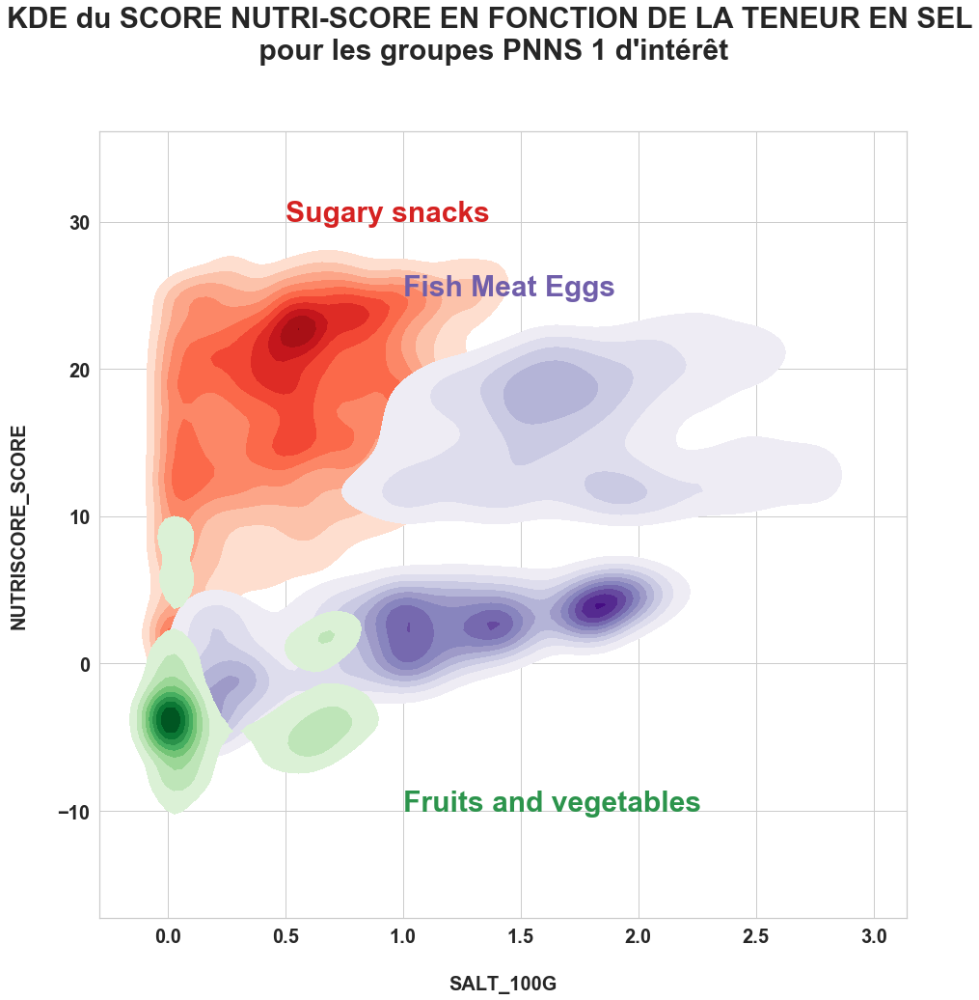

In [53]:
data_kdeplotShades = {
    
    "Sugary snacks":{"data":data_df1,
                     "legend_info" : (0.5, 30),
                     "palette": "Reds"},
    
    "Fish Meat Eggs":{"data":data_df3,
                      "legend_info" : (1, 25),
                      "palette": "Purples"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (1, -10),
                             "palette": "Greens"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "salt_100g", "nutriscore_score", 1,
                         "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SEL\n pour les groupes PNNS 1 d'intérêt",
                         15, 15)

>- **Les observations semblent indiquer une influence péjorative de la teneur en sel sur le score Nutri-Score.**
- **Toutefois, cette influence péjorative n'est pas le seul facteur, puisqu'à taux de sel égal, les "Sugary snacks"présentent des scores Nutri-Score bien pires que les "Fish Meat Eggs" ou les "Fruits and vegetables".**

<u>Carré du rapport de corrélation</u>

In [54]:
hf.eta_squared(data, "pnns_groups_1","nutriscore_score")

0.3960461918414948

>**La différence entre groupes PNNS 1 rend compte de 39,6% de la variabilité totale du score Nutri-Score.**

###### Entre PNNS 2 et le score Nutri-Score

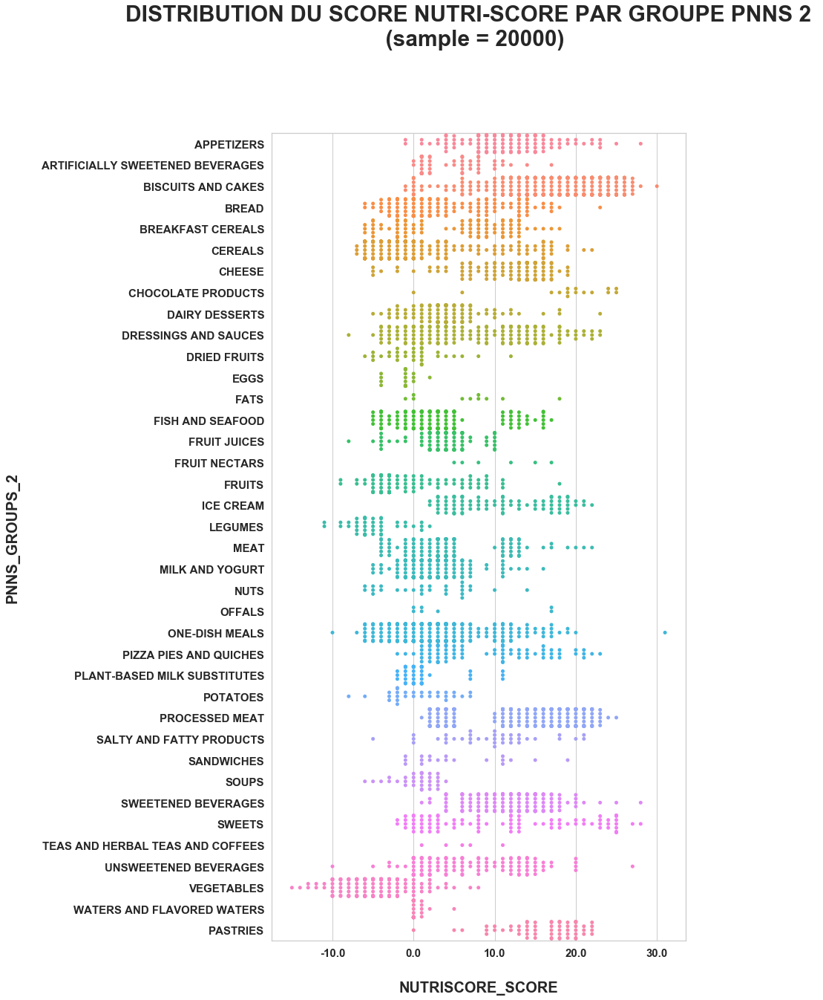

In [55]:
hf.plotSwarmplot(data, "nutriscore_score", "pnns_groups_2", 
              "DISTRIBUTION DU SCORE NUTRI-SCORE PAR GROUPE PNNS 2 \n (sample = 20000)", 10, 20, 0)

On retrouve les observations évoquées sur les groupes PNNS 1 : 
- **les aliments du groupe PNNS 2 "Vegetables" ont majoritairement de très bons scores Nutri-Score (entre -5 et -10)**
- **les aliments du groupe PNNS 2 "Fruits" ont majoritairement de très bons scores Nutri-Score (entre 0 et -5)**


- **les aliments du groupe PNNS 2 "Biscuits and cakes" ont majoritairement de très mauvais scores Nutri-Score ( > 15)**


- **les aliments du groupe PNNS 2 "Processed meat" ont majoritairement de très mauvais scores Nutri-Score ( > 15)**
- **les aliments du groupe PNNS 2 "Fish and seafood" ont majoritairement de bonnes valeurs de scores Nutri-Score (entre 5 et -5)**

Observons de plus près les composantes nutritionnelles pour ces groupes extrêmes : 

In [56]:
data_df1 = data.query("pnns_groups_2 == 'Biscuits and cakes'")
data_df2 = data[(data["pnns_groups_2"]=="Fruits") | (data["pnns_groups_2"]=="Vegetables")]
data_df3 = data.query("pnns_groups_2 == 'Processed meat'")
data_df4 = data.query("pnns_groups_2 == 'Fish and seafood'")

_<u>TENEUR EN SUCRES</u>_

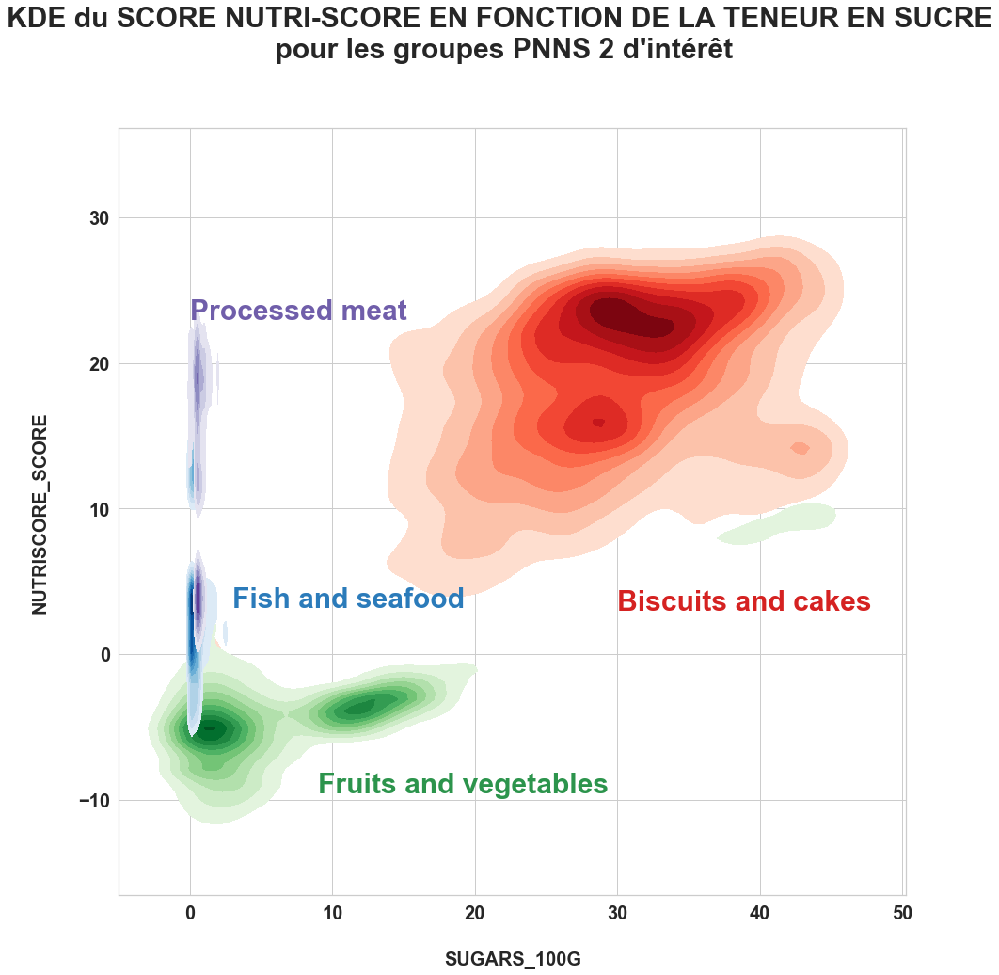

In [57]:
data_kdeplotShades = {
    
    "Biscuits and cakes":{"data":data_df1,
                          "legend_info" : (30, 3),
                          "palette": "Reds"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (9, -9.5),
                             "palette": "Greens"},
    
    "Fish and seafood":{"data":data_df4,
                      "legend_info" : (3, 3.2),
                      "palette": "Blues"},
    
    
        "Processed meat":{"data":data_df3,
                      "legend_info" : (0, 23),
                      "palette": "Purples"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "sugars_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SUCRE\n pour les groupes PNNS 2 d'intérêt",
                          15, 15)

>- **Les observations réalisées sur le groupe PNNS 1 se retrouvent au niveau des groupes PNNS 2 : le poisson et les fruits de mer, généralement moins riches en sucres, représentaient donc la portion du groups PNNS 1 dont les scores Nutri-Score étaient bons.**

_<u>TENEUR EN GRAISSES SATURÉES</u>_

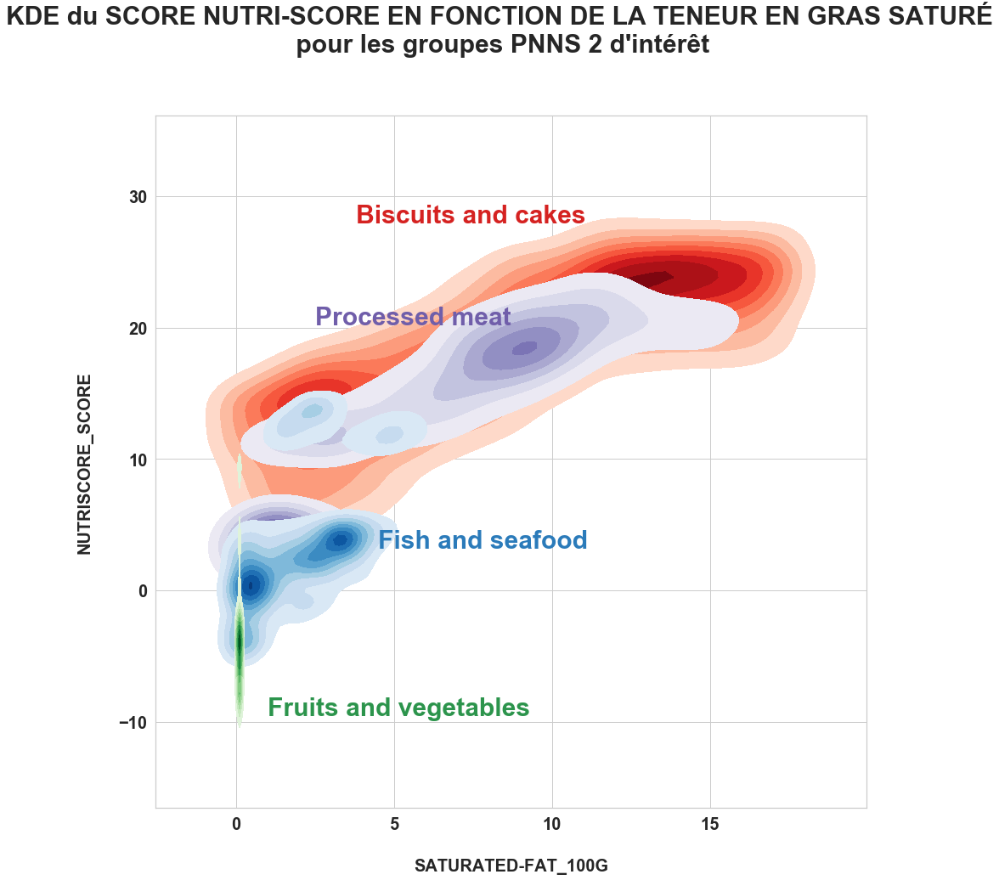

In [58]:
data_kdeplotShades = {
    
    "Biscuits and cakes":{"data":data_df1,
                          "legend_info" : (3.8, 28),
                          "palette": "Reds"},
    
    "Processed meat":{"data":data_df3,
                      "legend_info" : (2.5, 20.2),
                      "palette": "Purples"},
    
    "Fish and seafood":{"data":data_df4,
                      "legend_info" : (4.5, 3.2),
                      "palette": "Blues"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (1, -9.5),
                             "palette": "Greens"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "saturated-fat_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN GRAS SATURÉ\n pour les groupes PNNS 2 d'intérêt",
                          15, 15)

>- **Les observations réalisées sur le groupe PNNS 1 se retrouvent au niveau des groupes PNNS 2 : le poisson et les fruits de mer, généralement moins riches en acides gras saturés, représentaient donc la portion du groups PNNS 1 dont les scores Nutri-Score étaient bons.**

_<u>TENEUR EN PROTÉINES</u>_

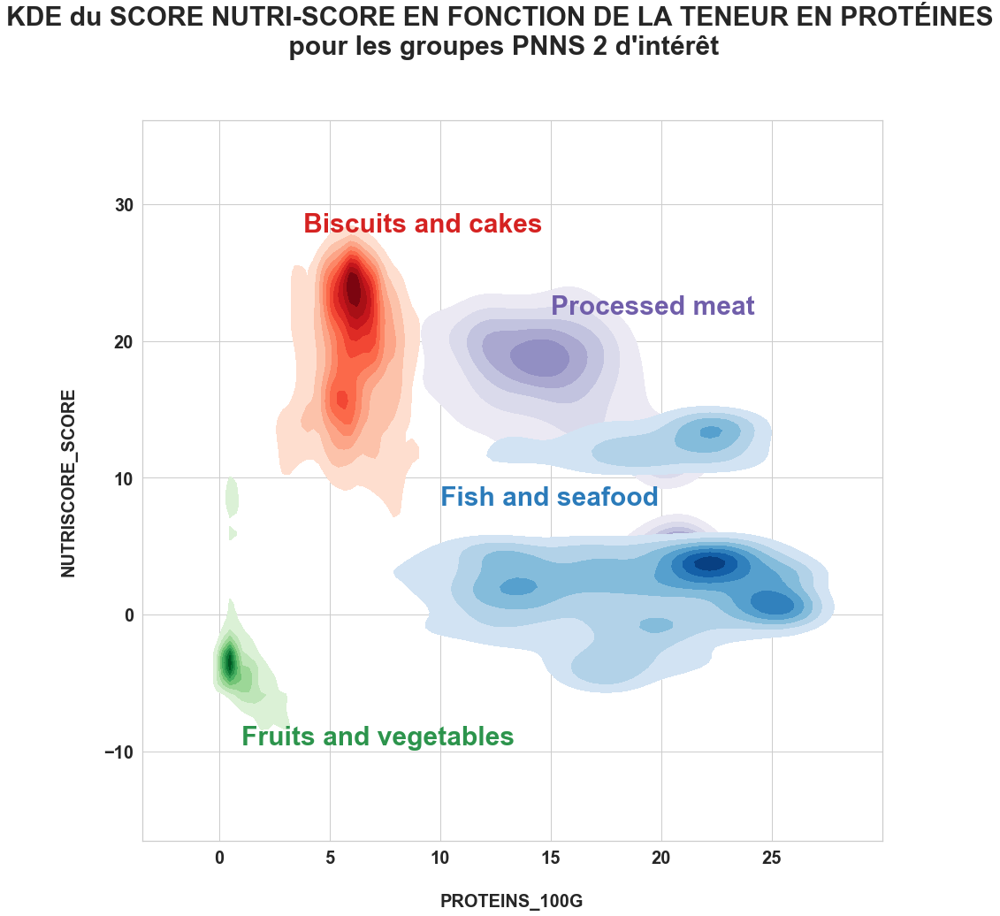

In [59]:
data_kdeplotShades = {
    
    "Biscuits and cakes":{"data":data_df1,
                          "legend_info" : (3.8, 28),
                          "palette": "Reds"},
    
    "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (1, -9.5),
                             "palette": "Greens"},
    
    "Processed meat":{"data":data_df3,
                      "legend_info" : (15, 22),
                      "palette": "Purples"},
    
    "Fish and seafood":{"data":data_df4,
                      "legend_info" : (10, 8),
                      "palette": "Blues"},
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "proteins_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN PROTÉINES\n pour les groupes PNNS 2 d'intérêt",
                          15, 15)

**Les observations réalisées sur le groupe PNNS 1 se retrouvent au niveau des groupes PNNS 2 :** 
>- **Le poisson et les fruits de mer, riches en protéines, et possédant généralement une faible teneur en sucres et en acides gras saturés, ont de bons scores Nutri-Score.**
- **La viande transformée a un mauvais score Nutri-Score, dû à sa teneur importantes en acides gras saturés, mais un score qui reste toutefois meilleur que celui la catégorie "Biscuits and cakes", plus pauvre en protéines**

_<u>TENEUR EN SEL</u>_

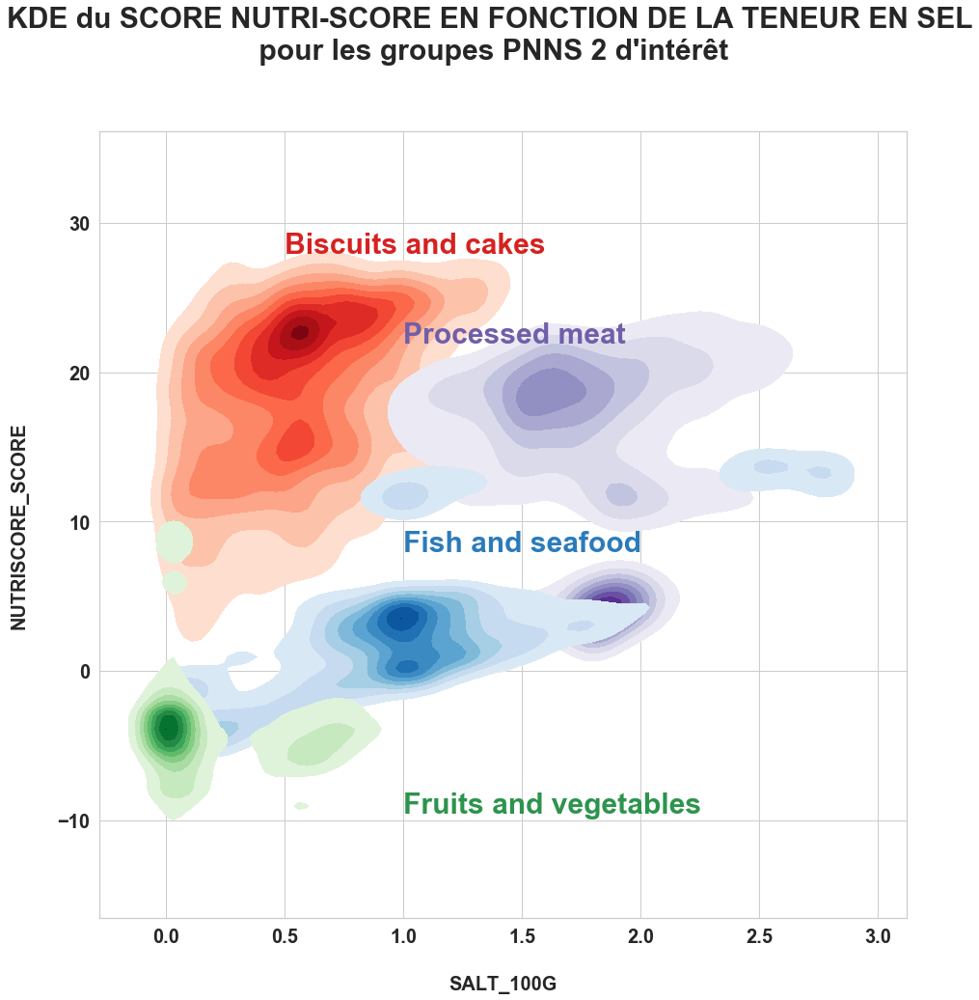

In [60]:
data_kdeplotShades = {
    
    "Biscuits and cakes":{"data":data_df1,
                          "legend_info" : (0.5, 28),
                          "palette": "Reds"},
    
    "Processed meat":{"data":data_df3,
                      "legend_info" : (1, 22),
                      "palette": "Purples"},
    
    "Fish and seafood":{"data":data_df4,
                      "legend_info" : (1, 8),
                      "palette": "Blues"},
    
        "Fruits and vegetables":{"data":data_df2,
                             "legend_info" : (1, -9.5),
                             "palette": "Greens"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "salt_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SEL\n pour les groupes PNNS 2 d'intérêt",
                          15, 15)

**Les observations réalisées sur le groupe PNNS 1 se retrouvent au niveau des groupes PNNS 2 :** 
>- **Pour les catégories où l'on retrouve des produits ayant de très mauvais scores Nutri-Score, ce sont les produits ayant le taux de sel le plus important qui ont les pires Nutri-Scores.**

<u>Carré du rapport de corrélation</u>

In [61]:
hf.eta_squared(data, "pnns_groups_2","nutriscore_score")

0.546574383487491

>**La différence entre groupes PNNS 2 rend compte de 54,7% de la variabilité totale du score Nutri-Score.**

###### Entre la classification nova et le score Nutri-Score

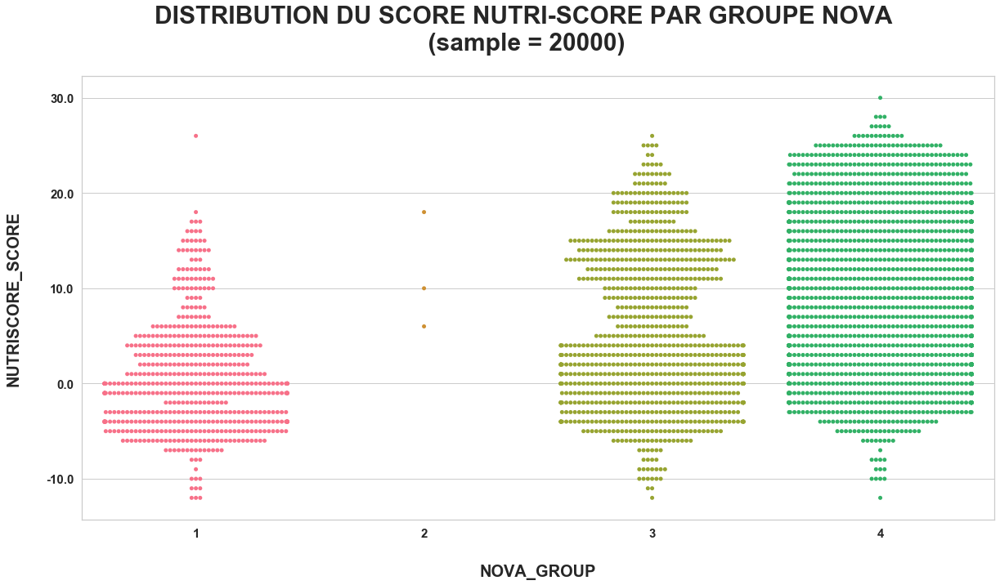

In [62]:
hf.plotSwarmplot(data, "nova_group", "nutriscore_score", 
              "DISTRIBUTION DU SCORE NUTRI-SCORE PAR GROUPE NOVA\n (sample = 20000)", 20, 10, 0)

On observe que : 
- **la majorité des produits les moins transformés ont un bon score Nutri-Score (entre 5 et -10)**
- **la majorité des produits ayant de mauvais scores Nutri-Score ( > 11 ) sont des produits ultra-transformés.**

In [63]:
data_df1 = data.query("nova_group == '1'")
data_df4 = data.query("nova_group == '4'")

_<u>TENEUR EN SUCRES</u>_

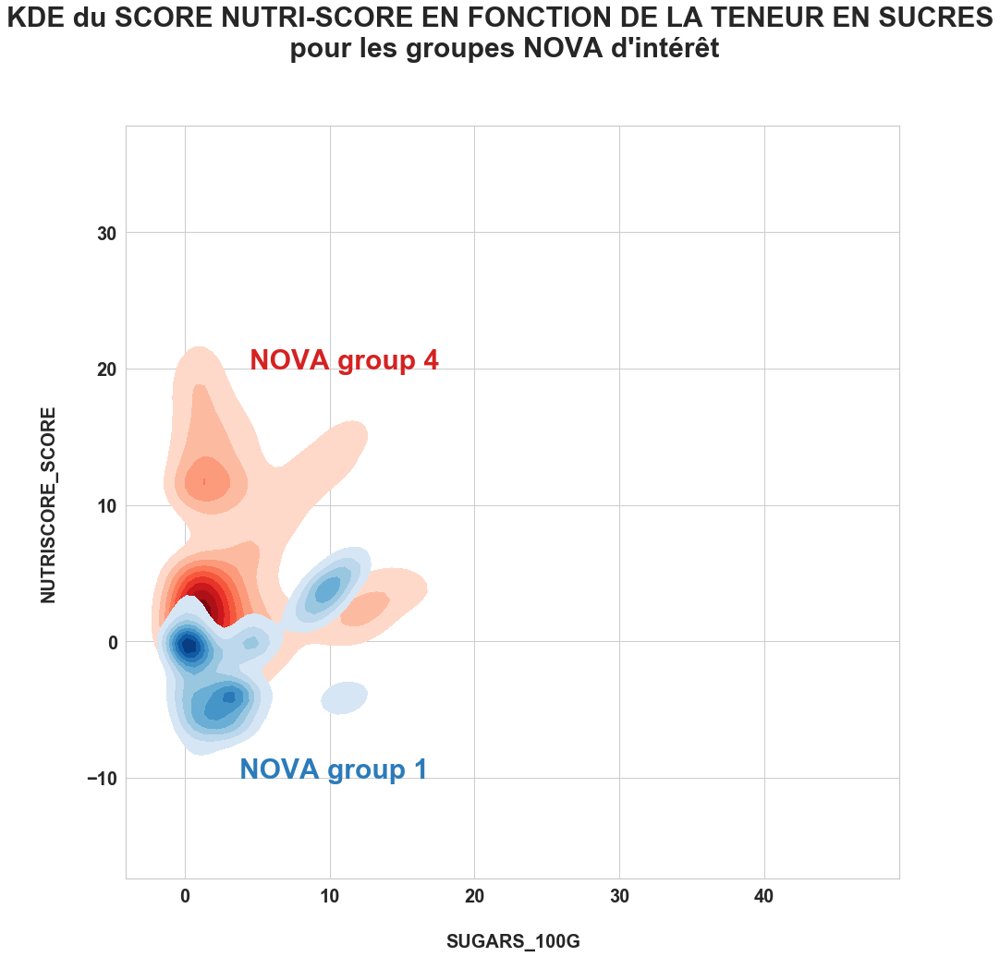

In [64]:
data_kdeplotShades = {
    
    "NOVA group 4":{"data":data_df4,
                    "legend_info" : (4.5, 20),
                    "palette": "Reds"},
    
    "NOVA group 1":{"data":data_df1,
                    "legend_info" : (3.8, -10),
                    "palette": "Blues"}
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "sugars_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SUCRES\n pour les groupes NOVA d'intérêt",
                          15, 15)

>- **Les observations semblent indiquer qu'à teneur égale en sucre, certains produits ultra transformés ont des scores Nutri-Score bien plus mauvais que ceux des produits bruts.**

_<u>TENEUR EN GRAISSES SATURÉES</u>_

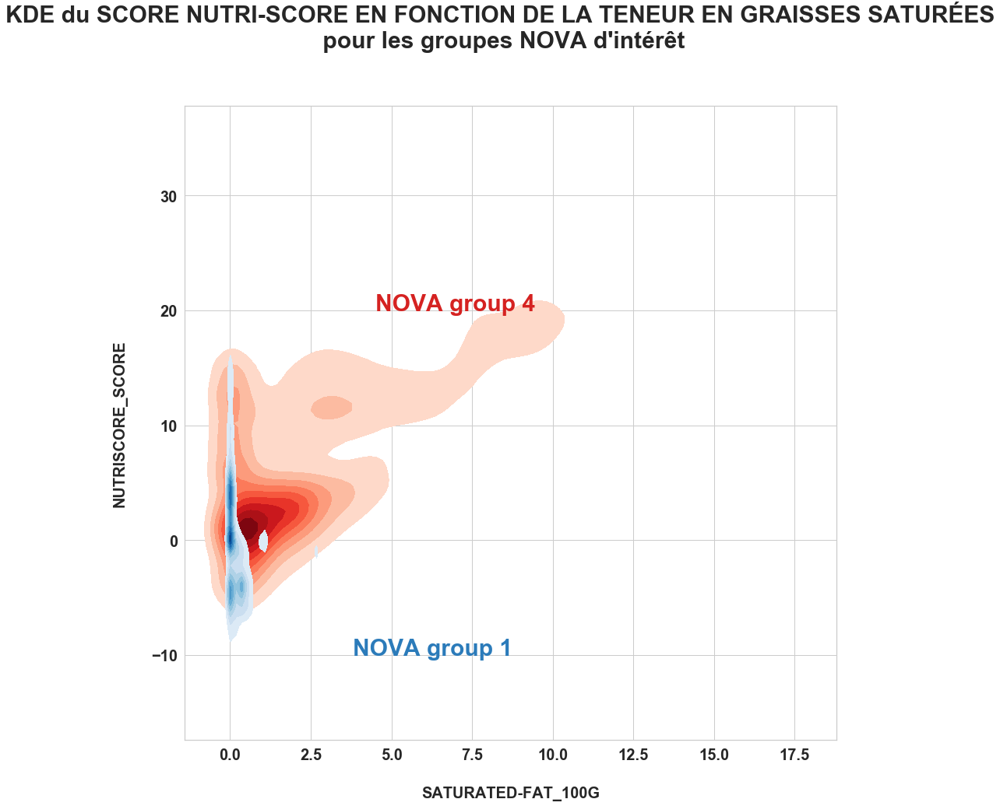

In [65]:
data_kdeplotShades = {
    
        
    "NOVA group 4":{"data":data_df4,
                    "legend_info" : (4.5, 20),
                    "palette": "Reds"},
    
    "NOVA group 1":{"data":data_df1,
                    "legend_info" : (3.8, -10),
                    "palette": "Blues"}

}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "saturated-fat_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN GRAISSES SATURÉES\n pour les groupes NOVA d'intérêt",
                          15, 15)

>- **Plus les produits contiennent de graisses saturées, plus leur score Nutri-Score est mauvais.**
- **La majorité des produits ultratransformés contient bien plus de graisses saturée que les produits bruts. Ceux-ci pourraient expliquer pourquoi certains produits ultratransformés, à tendance égale en sucre, avaient des scores Nutri-Score bien pires que ceux des produits bruts.**

_<u>TENEUR EN PROTÉINES</u>_

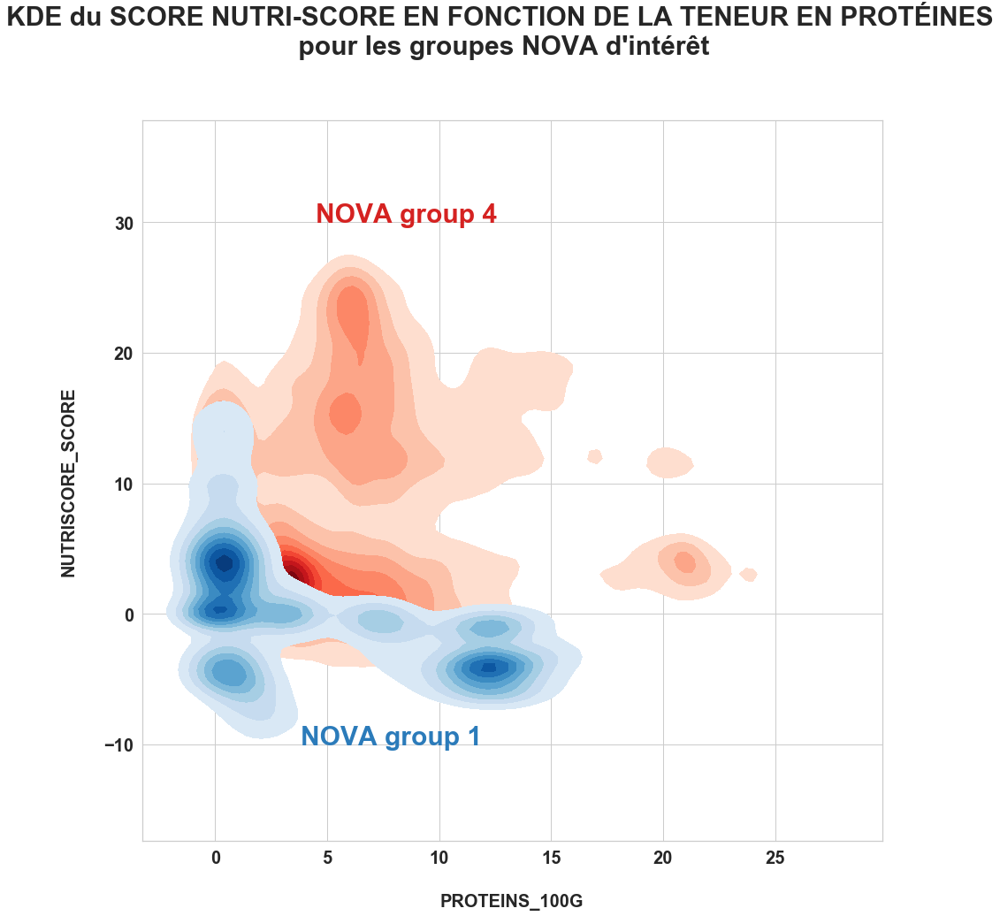

In [66]:
data_kdeplotShades = {
    
    "NOVA group 4":{"data":data_df4,
                    "legend_info" : (4.5, 30),
                    "palette": "Reds"},
    
    "NOVA group 1":{"data":data_df1,
                    "legend_info" : (3.8, -10),
                    "palette": "Blues"} 
    
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "proteins_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN PROTÉINES\n pour les groupes NOVA d'intérêt",
                          15, 15)

>- **À teneur en protéines égales, les produits ultratransformés ont des scores Nutri-Score bien plus mauvais que les produits bruts. Au vu des diagrammes précédents, cela s'explique probablement par leurs teneurs plus importantes en sucres et en graisses saturées.**
- **Les produits ultratransformés ont tendance à ne pas être très riches en protéines.**

_<u>TENEUR EN SEL</u>_

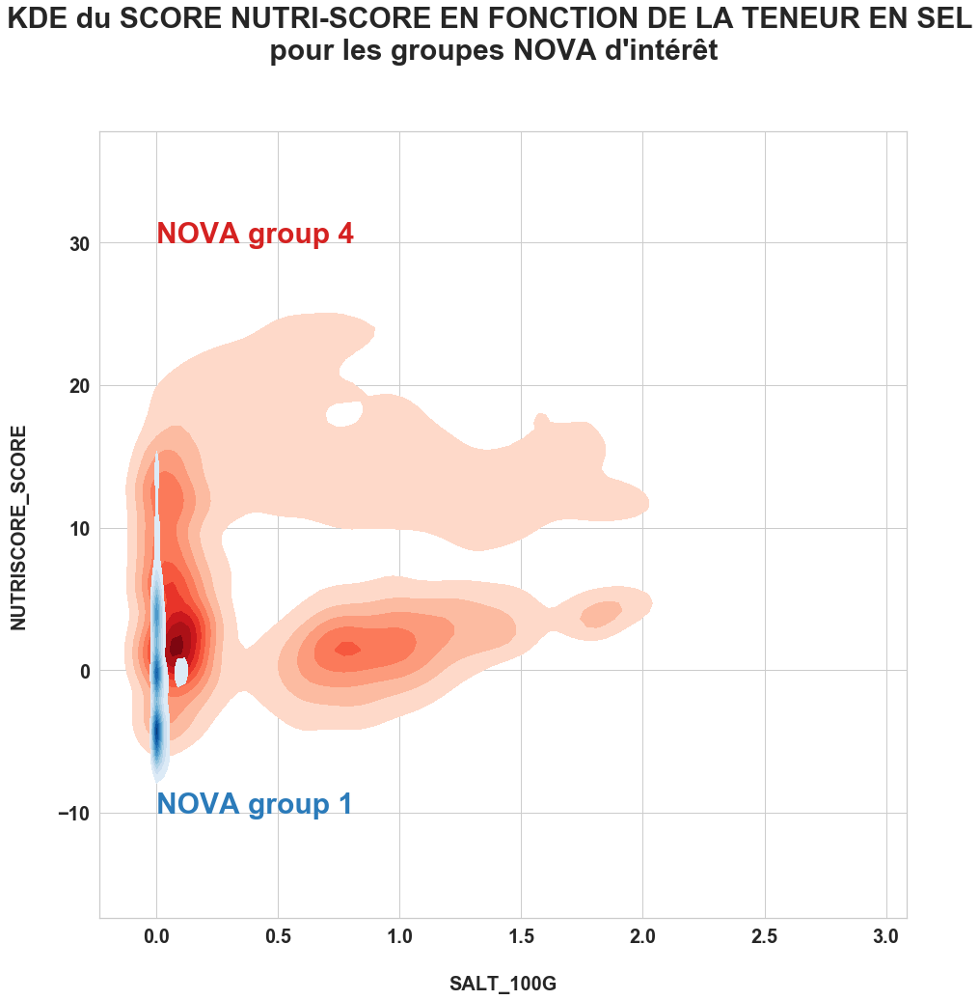

In [67]:
data_kdeplotShades = {
    
    "NOVA group 4":{"data":data_df4,
                    "legend_info" : (0, 30),
                    "palette": "Reds"},
    
    "NOVA group 1":{"data":data_df1,
                    "legend_info" : (0, -10),
                    "palette": "Blues"} 
    
}

hf.plotMultipleKDEplotShades(data_kdeplotShades, "salt_100g", "nutriscore_score", 1,
                          "KDE du SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SEL\n pour les groupes NOVA d'intérêt",
                          15, 15)

>- **À teneur en protéines égales, les produits ultratransformés ont des scores Nutri-Score bien plus mauvais que les produits bruts. Au vu des diagrammes précédents, cela s'explique probablement par leurs teneurs plus importantes en sucres et en graisses saturées.**
- **Les produits ultratransformés ont tendance à ne pas être très riches en protéines.**

<u>Carré du rapport de corrélation</u>

In [68]:
hf.eta_squared(data, "nova_group","nutriscore_score")

0.12461343001160732

>**La différence d'un groupe NOVA à un autre rend compte de 12,5% de la variabilité totale.**

**CONCLUSIONS PRÉLIMINAIRES**
- **Le groupe PNNS 2 est la variable qualitative ayant la relation la plus forte avec le score Nutri-Score.**
- **La teneur en graisses saturées semble être le facteur le plus important dans le calcul du Nutri-Score, suivi de la teneur en sucres.**
- **La teneur en protéines semble également jouer un rôle (mélioratif) moindre dans ce calcul.**

##### _<u>2.3.2 Entre les variables quantitatives et la lettre nutriscore</u>_

###### Diagramme par paire des variables quantitatives par lettre nutriscore

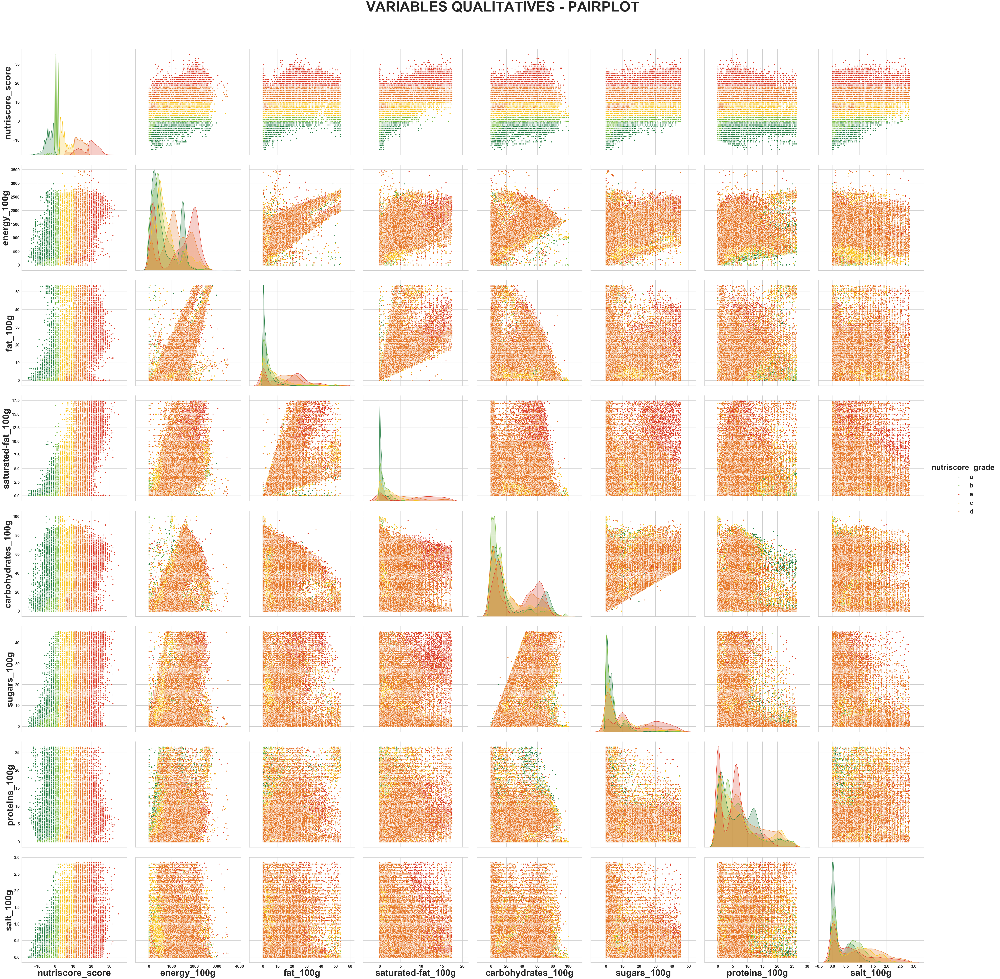

In [69]:
hf.plotPairplot(data[['nutriscore_score',
                       'energy_100g',
                       'fat_100g',
                       'saturated-fat_100g',
                       'carbohydrates_100g',
                       'sugars_100g',
                       'proteins_100g',
                       'salt_100g',
                       'nutriscore_grade']], 8, hue="nutriscore_grade")

Certaines tendances ressortent : 
- <i>graphique x = nutriscore_score, y = fat_100g</i>: 
> **Plus la teneur en graisses est importante, plus le score Nutri-Score est mauvais. <br> 
La proportion d'aliments classés "A" (bleu) et "E" respectivement semble confirmer cette tendance : plus la teneur en graisse augmente, plus la proportion d'aliments "A" diminue, et plus la proportion d'aliments "E" augmente.**
- <i>graphique x = nutriscore_score, y = saturated-fat_100g</i>: 
> **La tendance est la même que pour la teneur simple en graisse, en plus accentuée.**
- <i>graphique x = nutriscore_score, y = sugars_100g</i>: 
> **La tendance est la même que pour la teneur en graisse.**
- <i>graphique x = nutriscore_score, y = proteins_100g</i>: 
> **une légère augmentation des aliments classés "A", accompagnée d'une légère diminution des produits classés "E" est visible lorsque la teneur en protéines augmente.**
- <i>graphique x = nutriscore_score, y = salt_100g</i>: 
> **La proportion d'aliments classés "A" baisse drastiquement avec l'augmentation de la teneur en sel.**

_**Zoom sur les variables les plus corrélées**_

L'analyse des coefficients de corrélation de Pearson et Spearman avait permis de mettre en lumière une corrélation entre les variables :
- _nutriscore_score_ 
- _energy_100g_
- _fat_100g_ 
- _saturated-fat_100g_
- _sugars_100g_
- _proteins_100g_
- _salt_100g_

Intéressons-nous de plus près à ces variables.

_<u>ÉNERGIE ET SUCRES </u>_

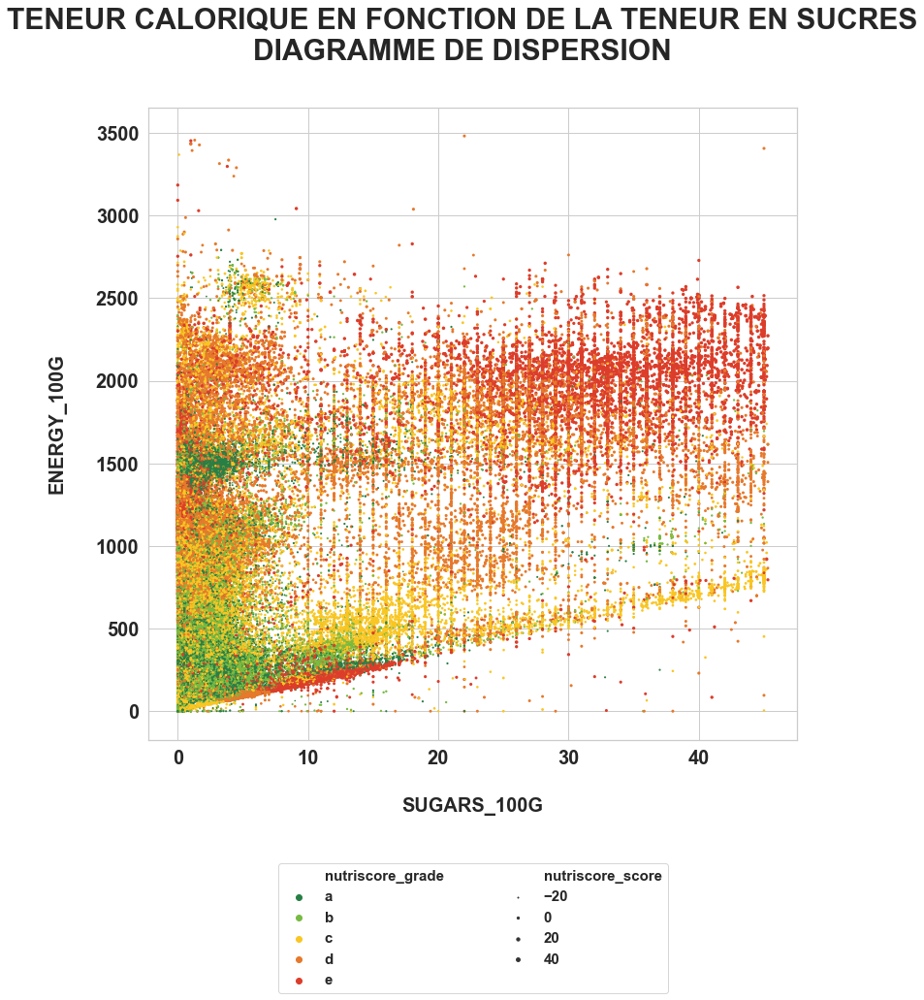

In [70]:
hf.plotScatterplotNutriScores(data, "sugars_100g","energy_100g",
                           "TENEUR CALORIQUE EN FONCTION DE LA TENEUR EN SUCRES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à droite du graphique.

> **Les aliments contenant un nombre élevé de calories et une teneur élevée en sucre ont tendance à avoir les  valeurs Nutri-Score les plus mauvaises ("E").**

_<u>ÉNERGIE ET GRAISSES SATURÉES</u>_

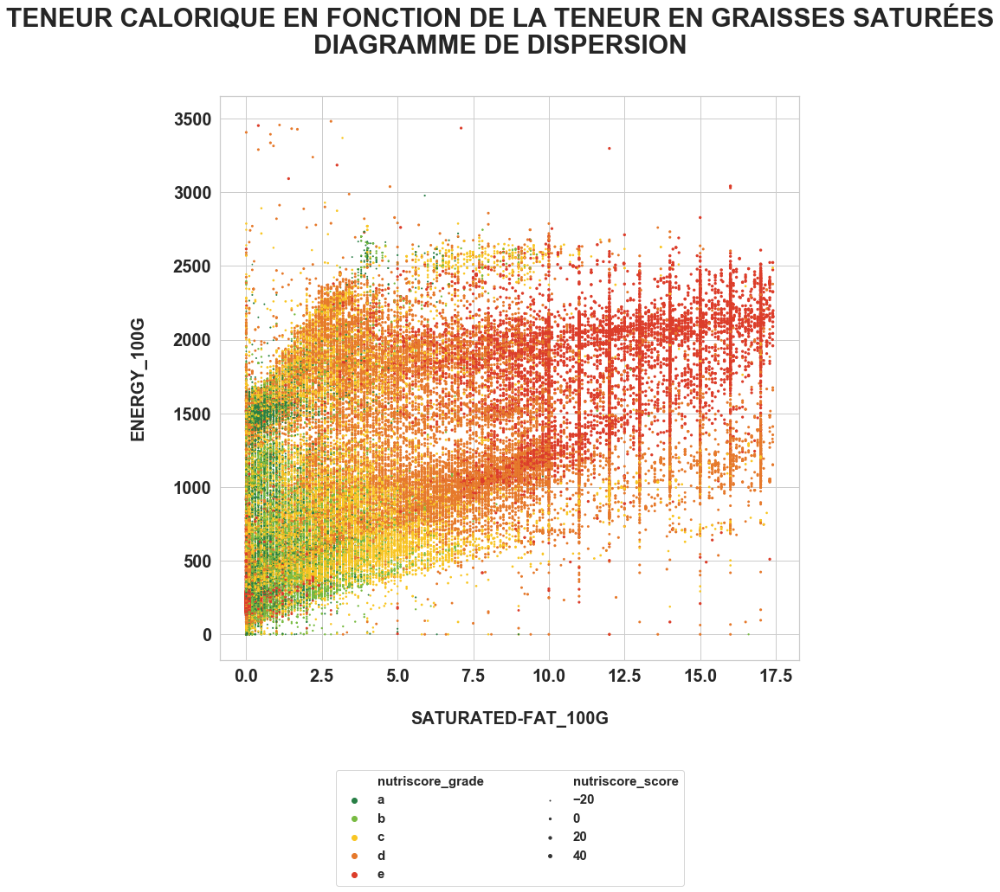

In [71]:
hf.plotScatterplotNutriScores(data, "saturated-fat_100g", "energy_100g",
                           "TENEUR CALORIQUE EN FONCTION DE LA TENEUR EN GRAISSES SATURÉES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à droite du graphique.

> **Le Nutri-Score empire avec le couple (teneur calorique, teneur en gras saturé).<br> 
Les aliments contenant un nombre de calories et une teneur en graisses saturées élevés ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>ÉNERGIE ET PROTÉINES</u>_

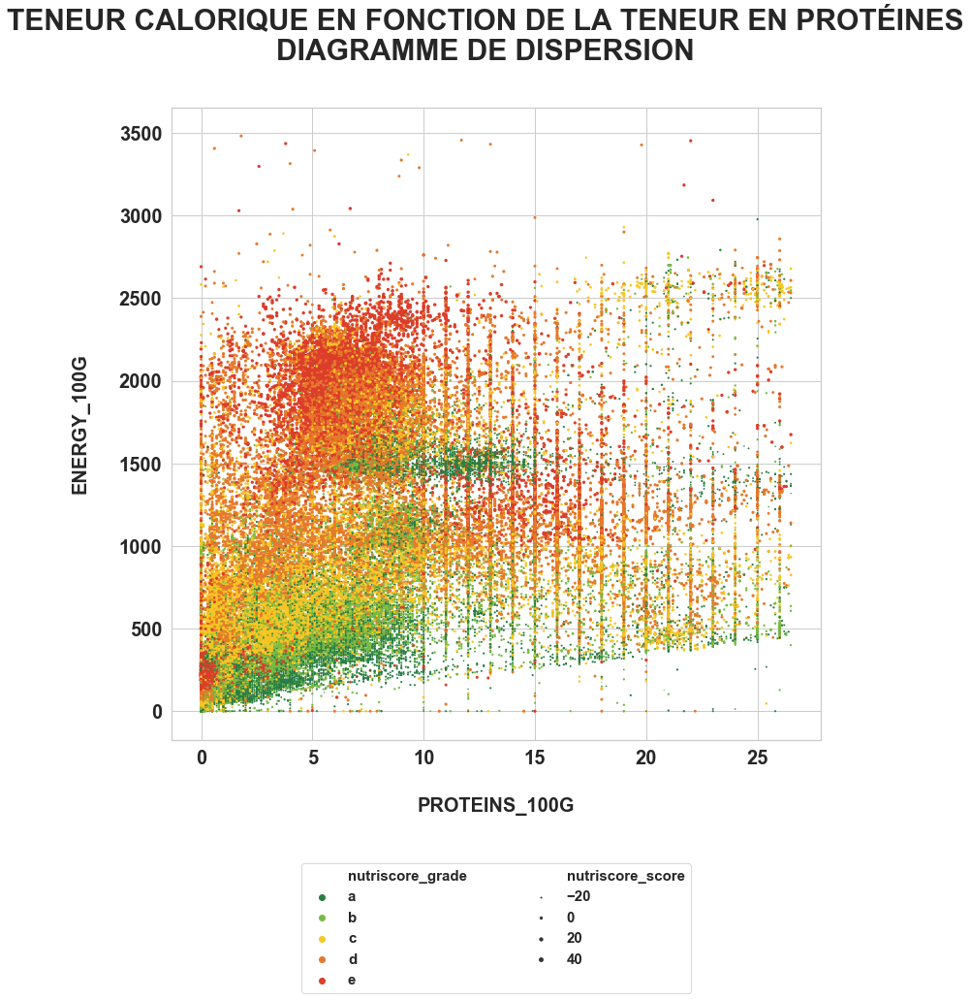

In [72]:
hf.plotScatterplotNutriScores(data, "proteins_100g", "energy_100g",
                           "TENEUR CALORIQUE EN FONCTION DE LA TENEUR EN PROTÉINES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la gauche du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à gauche du graphique.

> **Les aliments contenant un nombre de calories élevé pour une faible teneur en protéines ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>ÉNERGIE ET SEL</u>_

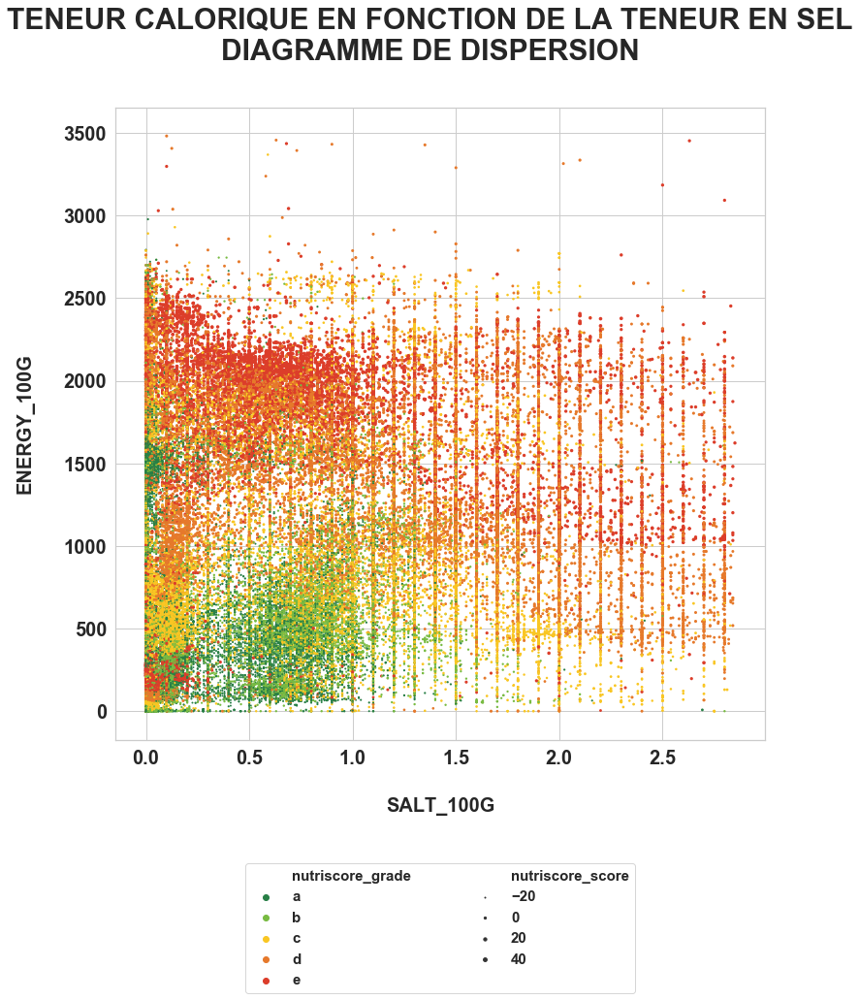

In [73]:
hf.plotScatterplotNutriScores(data, "salt_100g", "energy_100g",
                           "TENEUR CALORIQUE EN FONCTION DE LA TENEUR EN SEL\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "A" et "B" en vert sont concentrés dans le cadran en bas à gauche du graphique.

> **Les aliments dont les valeurs Nutri-Score sont les meilleurs ("A" et "B") ont tous de faibles teneurs en sel.**

_<u>GRAISSES SATURÉES ET TENEUR CALORIQUE</u>_

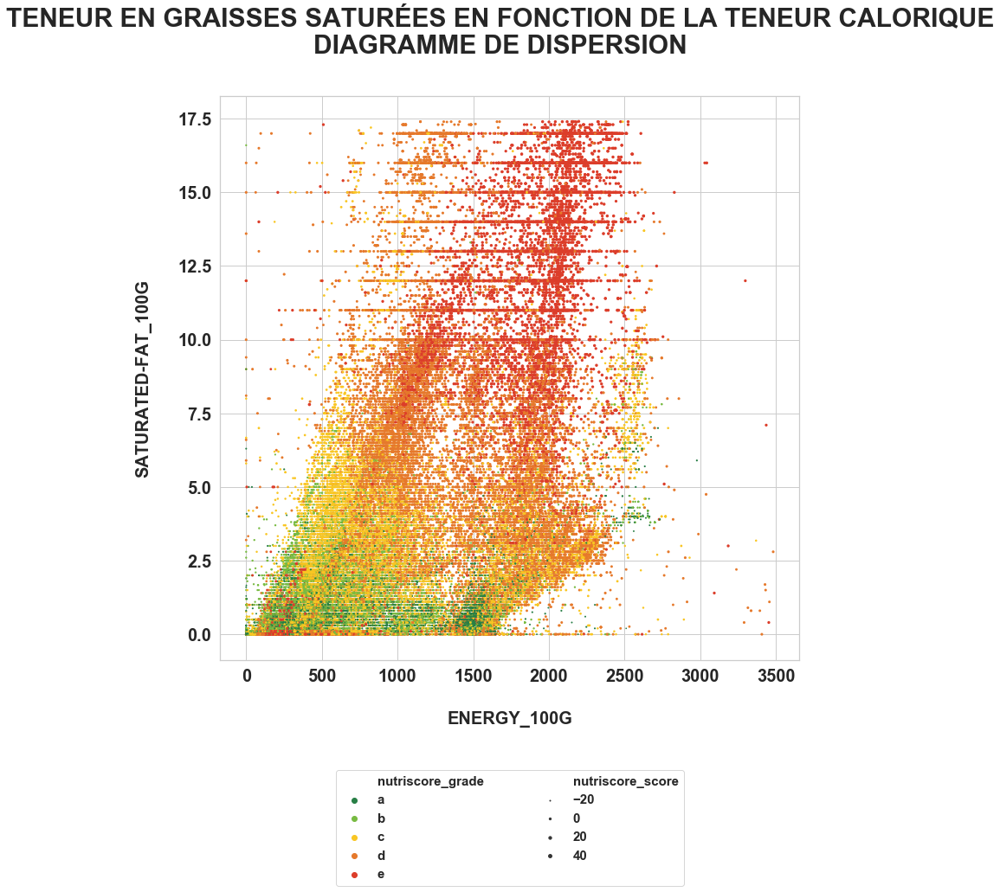

In [74]:
hf.plotScatterplotNutriScores(data, "energy_100g","saturated-fat_100g",
                           "TENEUR EN GRAISSES SATURÉES EN FONCTION DE LA TENEUR CALORIQUE\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la droite du graphique, plus les points sont gros et plus la proportion de points rougeâtres augmente, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à droite du graphique.

> **Les aliments dont les teneurs en sucre et caloriques sont élevées ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>GRAISSES SATURÉES ET SUCRES</u>_

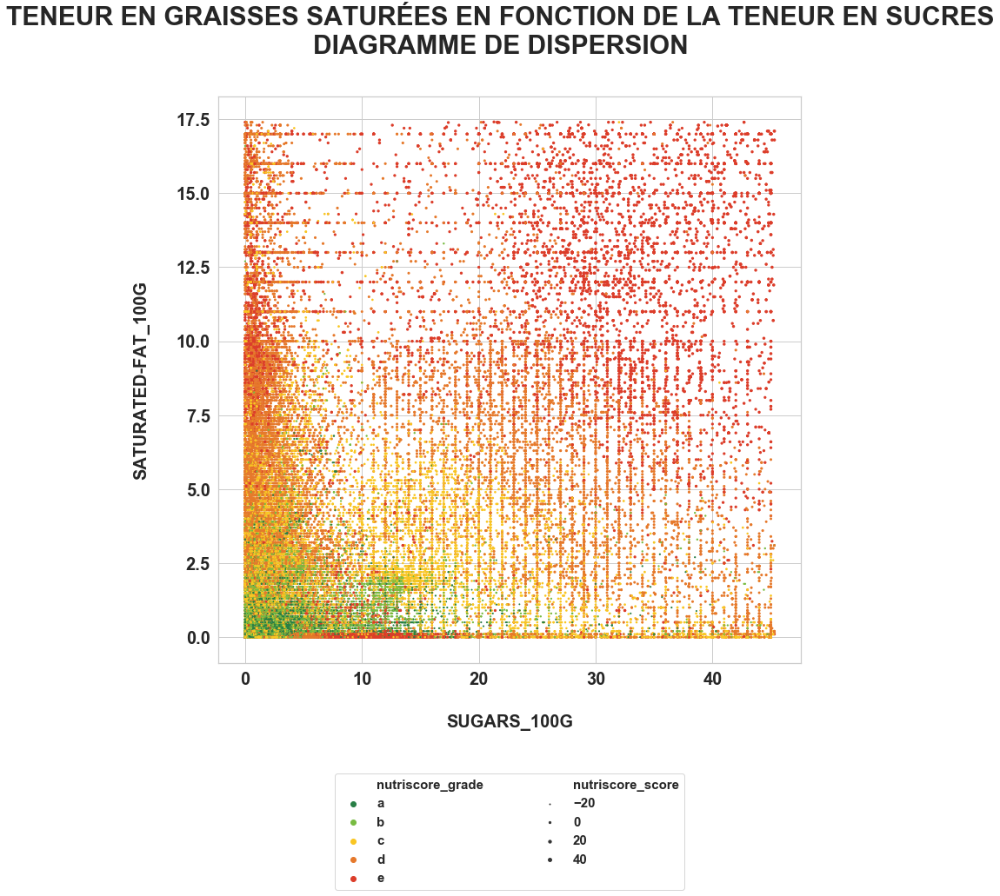

In [75]:
hf.plotScatterplotNutriScores(data, "sugars_100g","saturated-fat_100g",
                           "TENEUR EN GRAISSES SATURÉES EN FONCTION DE LA TENEUR EN SUCRES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la droite du graphique, plus les points sont gros et plus la proportion de points rougeâtres augmente, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à droite du graphique.

> **Les aliments dont les teneurs en sucre et en graisses saturées sont élevées ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>GRAISSES SATURÉES ET PROTÉINES</u>_

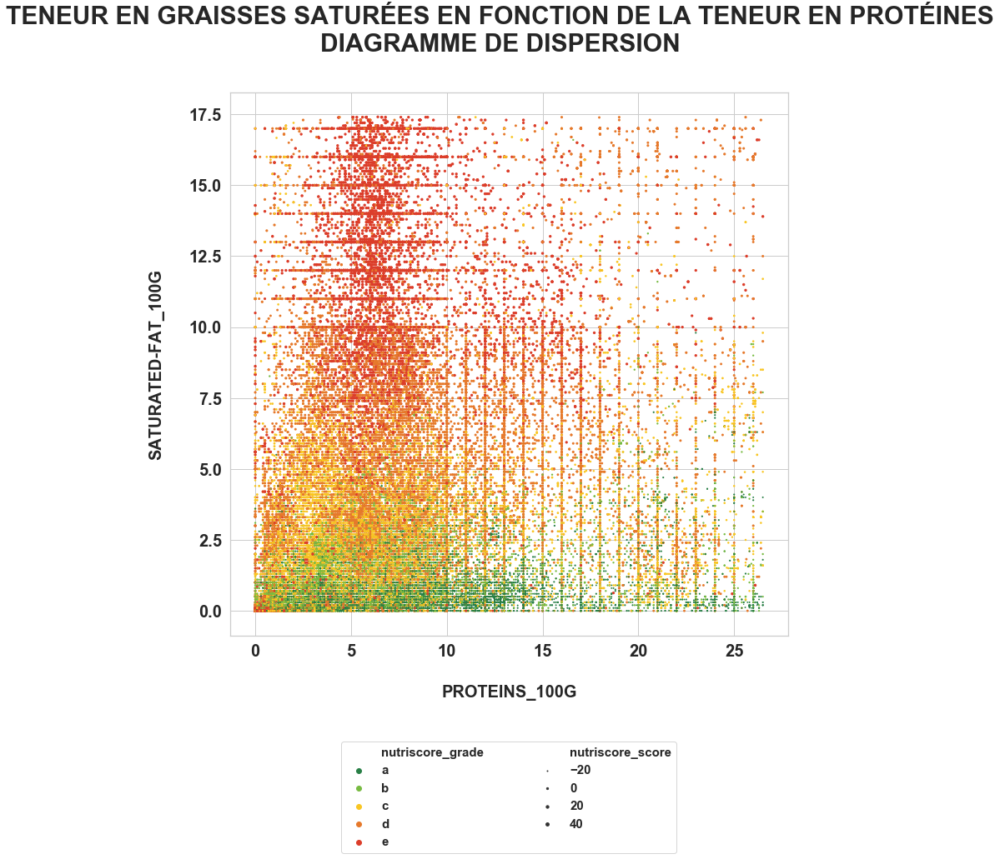

In [76]:
hf.plotScatterplotNutriScores(data, "proteins_100g","saturated-fat_100g",
                           "TENEUR EN GRAISSES SATURÉES EN FONCTION DE LA TENEUR EN PROTÉINES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le haut et la gauche du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en haut à gauche du graphique.

> **Les aliments dont la teneur en graisses saturées est élevée ont globalement de très mauvaises valeurs Nutri-Score. La teneur en protéines ne semble avoir d'influence que pour les valeurs les plus élevées, c'est-à-dire les produits très riches en protéines.**

_<u>GRAISSES SATURÉES ET SEL</u>_

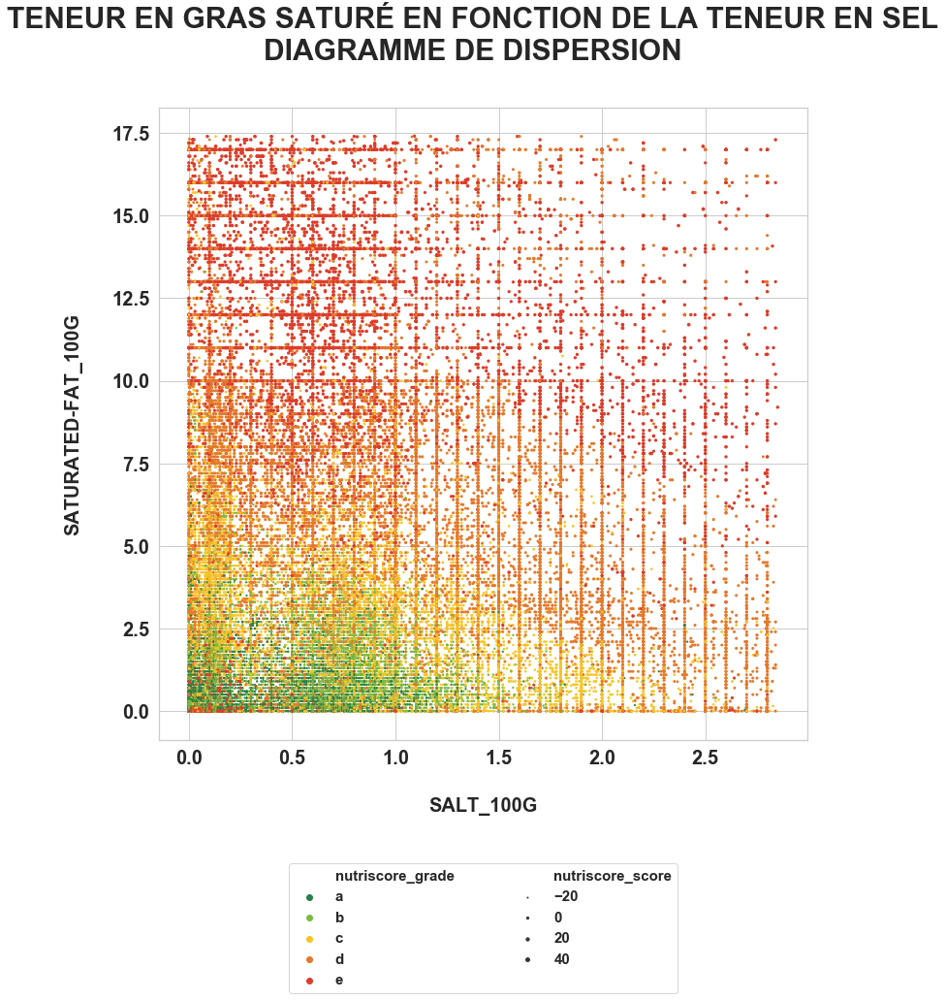

In [77]:
hf.plotScatterplotNutriScores(data, "salt_100g","saturated-fat_100g",
                           "TENEUR EN GRAS SATURÉ EN FONCTION DE LA TENEUR EN SEL\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont concentrés sur la droite du graphique.

> **Les aliments dont la teneur en graisses saturées est élevéeont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E") quelle que soit leur teneur en sel. <br>
On constate toutefois un léger accroissement des produits classés "E" pour les teneurs en sel les plus élevées.**

_<u>PROTÉINES ET TENEUR CALORIQUE</u>_

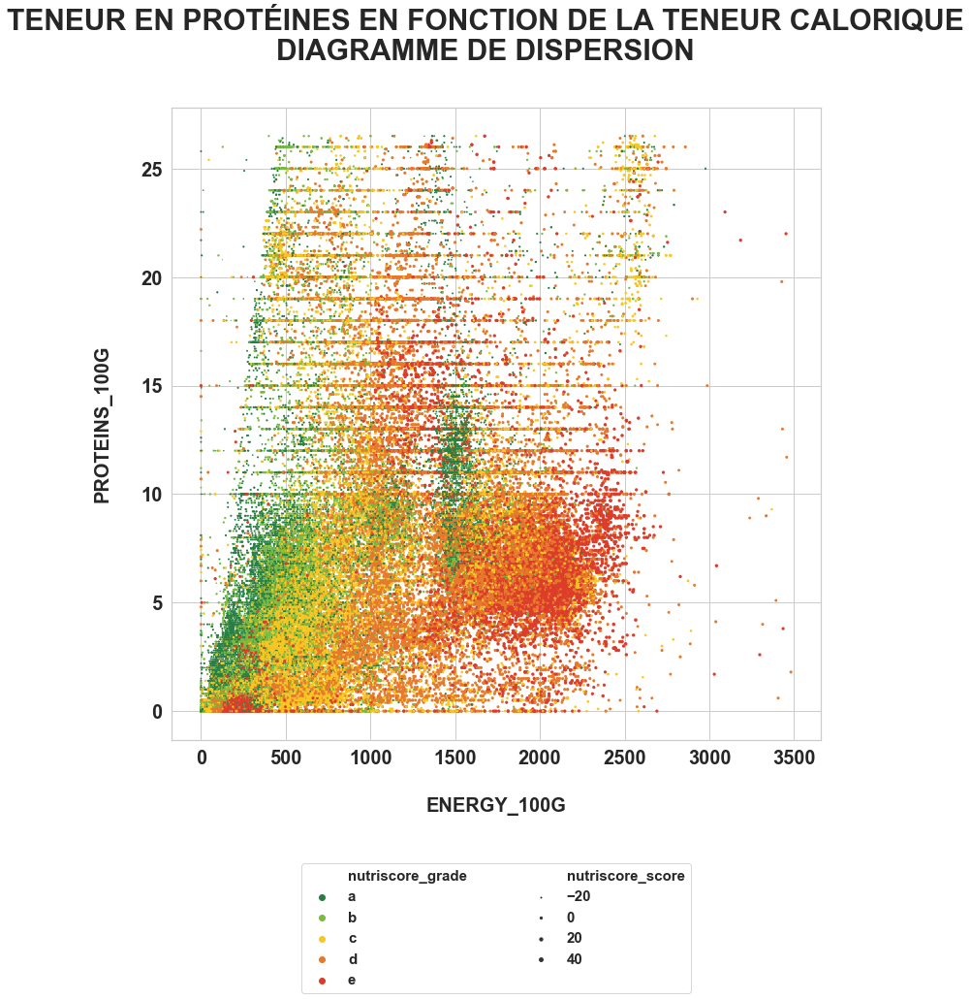

In [78]:
hf.plotScatterplotNutriScores(data, "energy_100g","proteins_100g",
                           "TENEUR EN PROTÉINES EN FONCTION DE LA TENEUR CALORIQUE\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le bas et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont essentiellement concentrés dans le cadran en bas à droite du graphique.

> **Les aliments dont la teneur calorique est élevée et la teneur en protéines est faible ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>PROTÉINES ET GRAISSES SATURÉES</u>_

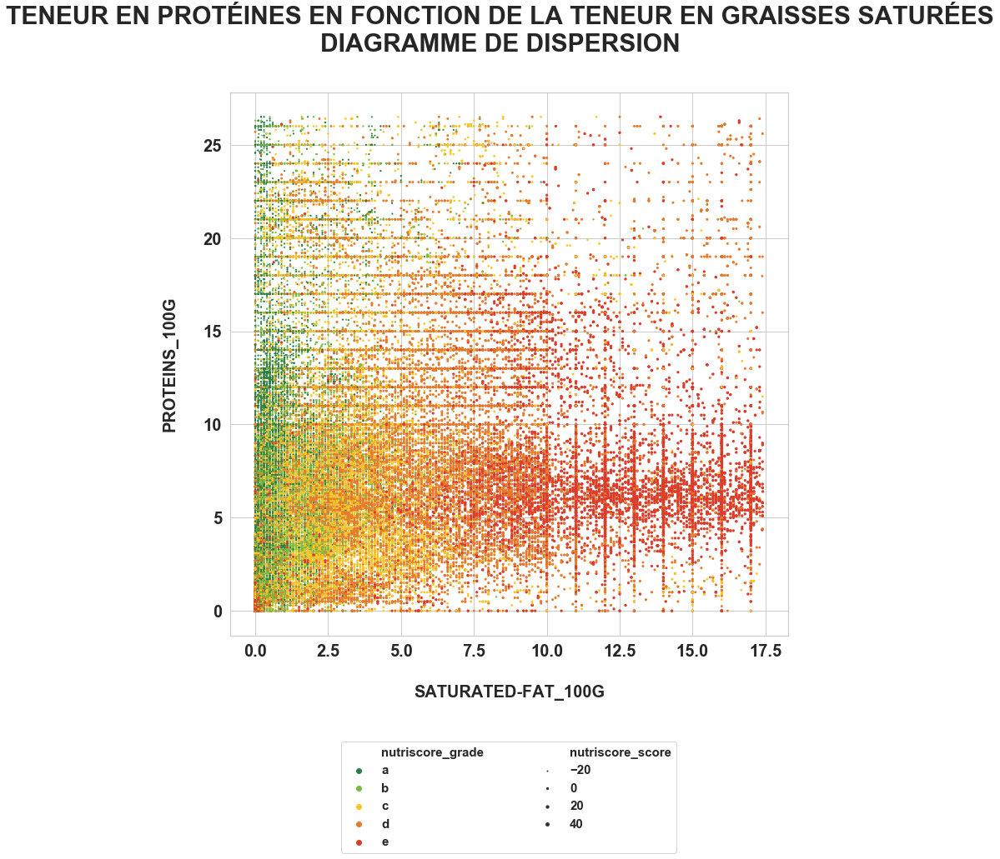

In [79]:
hf.plotScatterplotNutriScores(data, "saturated-fat_100g","proteins_100g",
                           "TENEUR EN PROTÉINES EN FONCTION DE LA TENEUR EN GRAISSES SATURÉES\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le bas et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont essentiellement concentrés dans le cadran en bas à droite du graphique.

> **Les aliments dont la teneur en sucre est élevée et la teneur en protéines est faible ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>PROTÉINES ET SUCRES</u>_

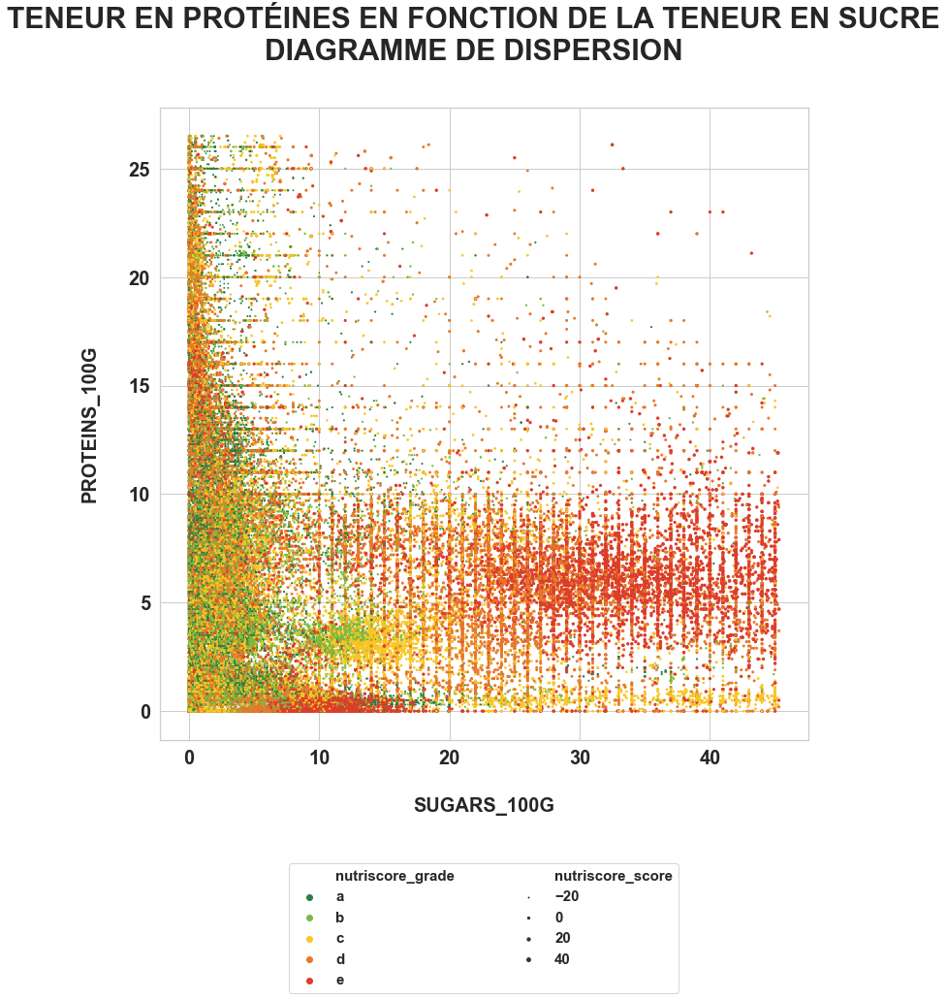

In [80]:
hf.plotScatterplotNutriScores(data, "sugars_100g","proteins_100g",
                           "TENEUR EN PROTÉINES EN FONCTION DE LA TENEUR EN SUCRE\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le bas et la droite du graphique, plus les points sont gros et rougeâtres, traduisant un Nutri-Score de plus en plus mauvais. <br>Les aliments classés "E" en rouge sont essentiellement concentrés dans le cadran en bas à droite du graphique.

> **Les aliments dont la teneur en sucre est élevée et la teneur en protéines est faible ont tendance à avoir les valeurs Nutri-Score les plus mauvaises ("E").**

_<u>PROTÉINES ET SEL</u>_

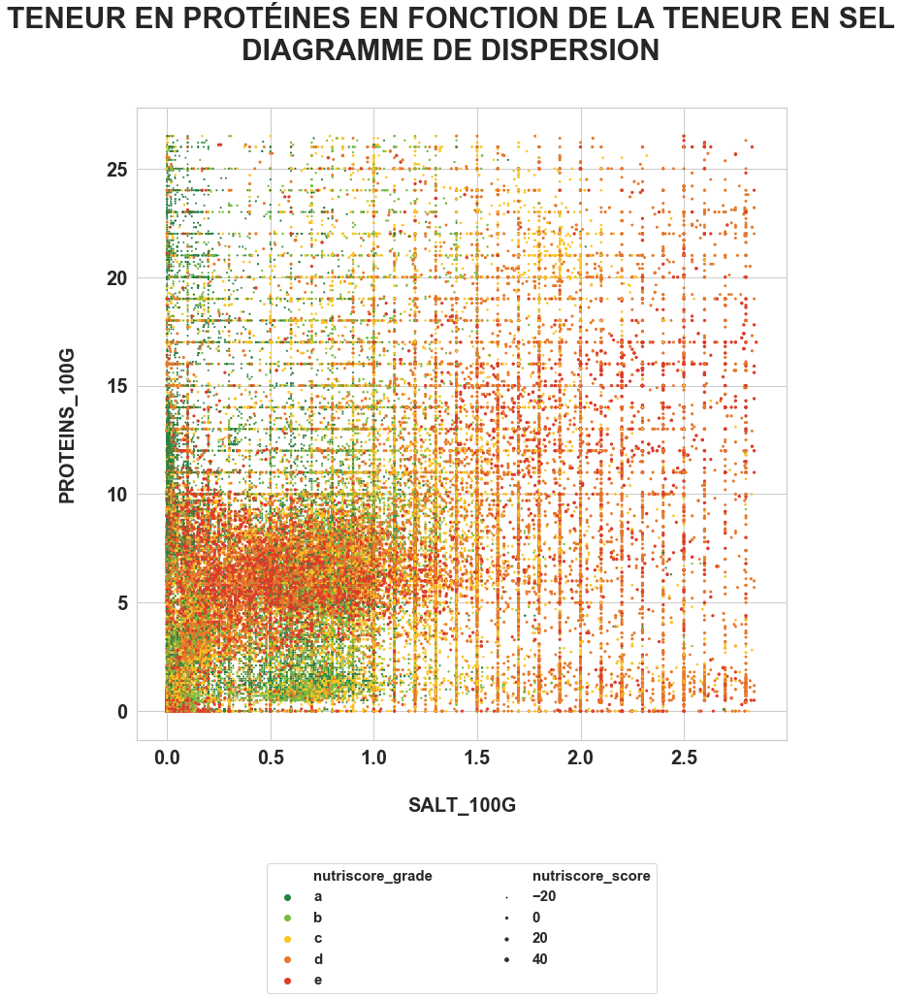

In [81]:
hf.plotScatterplotNutriScores(data, "salt_100g","proteins_100g",
                           "TENEUR EN PROTÉINES EN FONCTION DE LA TENEUR EN SEL\nDIAGRAMME DE DISPERSION",
                           12, 12)

Plus l'on se déplace vers le bas et la gauche du graphique, plus les points sont gros et rougeâtres, traduisant un score Nutri-Score de plus en mauvais. <br>Les aliments classés "E" en rouge sont concentrés dans le cadran en bas à gauche du graphique.

> **Les aliments dont la teneur en sel est faible et la teneur en protéines est faible ont tendance à avoir les scores Nutri-Score les plus mauvais.**

**CONCLUSIONS PRÉLIMINAIRES**
- **La teneur en graisses saturées semble être un facteur déterminant dans le calcul des valeurs Nutri-Score.**
- **Le nombre de calories ainsi que les teneurs en graisses saturées, sucres et sel sont des facteurs péjoratifs dans le calcul du Nutri-Score.**
- **La teneur en protéines semble être un facteur mélioratif dans le calcul du Nutri-Score.**

Ces observations peuvent être mises en lumière via un diagramme contenant uniquement la variable étudiée et le Nutri-Score (score numérique et lettre):

_<u>ENERGY_100g</u>_

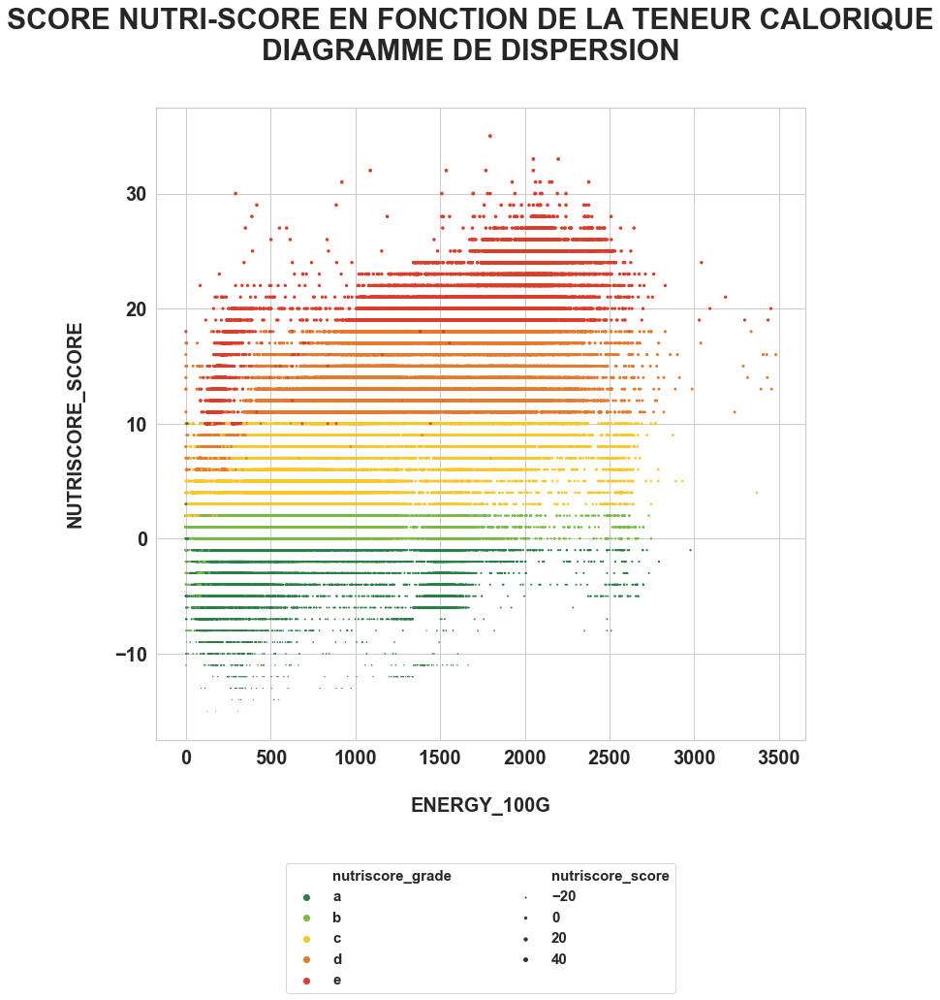

In [82]:
hf.plotScatterplotNutriScores(data, "energy_100g","nutriscore_score",
                           "SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR CALORIQUE\nDIAGRAMME DE DISPERSION",
                           12, 12)

> **La proportion d'aliments classés "E" augmente avec le nombre de calories, de même que la proportion d'aliments classés "A" diminue.**

<u>Carré du rapport de corrélation</u>

In [83]:
hf.eta_squared(data, "nutriscore_grade","energy_100g")

0.17247368042252056

>**La différence d'une note nutriscore à une autre rend compte de 17,2% de la variabilité totale de l'énergie.**

- **SATURATED-FAT_100g**

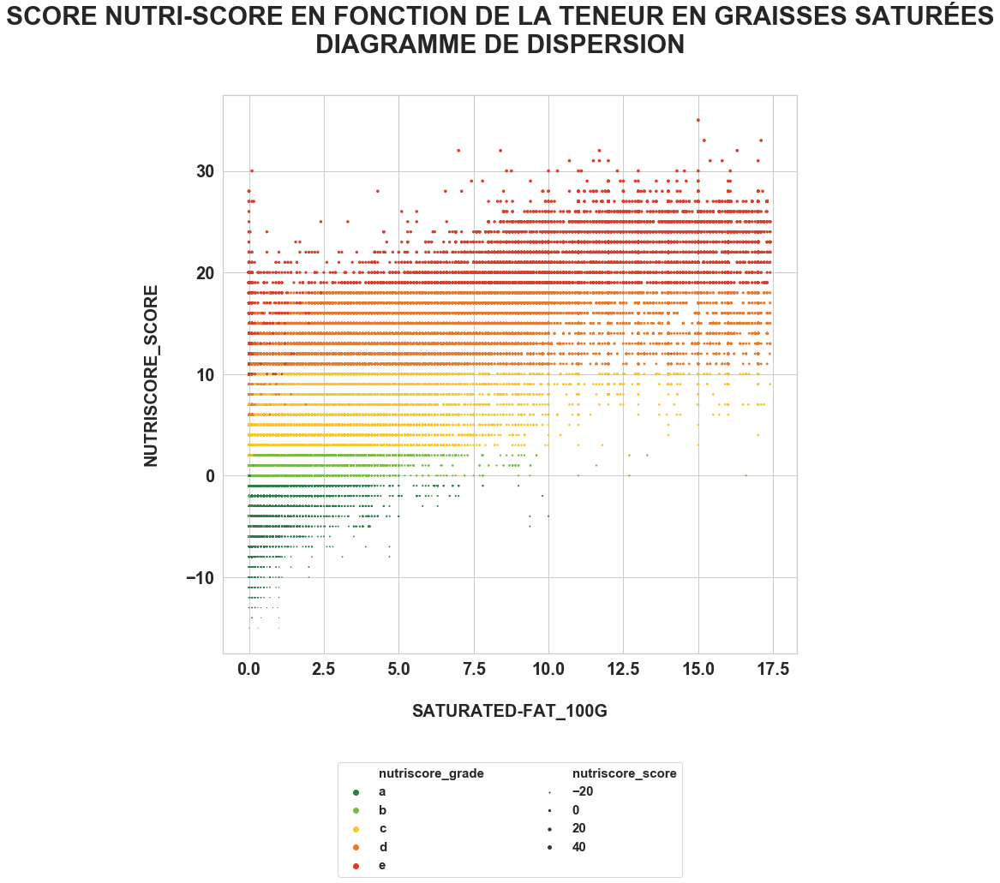

In [84]:
hf.plotScatterplotNutriScores(data, "saturated-fat_100g","nutriscore_score",
                           "SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN GRAISSES SATURÉES\nDIAGRAMME DE DISPERSION",
                           12, 12)

> **La proportion d'aliments classés "E" augmente significativement avec la teneur en graisses saturées, de même que la proportion d'aliments classés "A" diminue.**

<u>Carré du rapport de corrélation</u>

In [85]:
hf.eta_squared(data, "nutriscore_grade","saturated-fat_100g")

0.364921846635802

>**La différence d'une note nutriscore à une autre rend compte de 36.5% de la variabilité totale de la teneur en graisses saturées.**

- **SUGARS_100g**

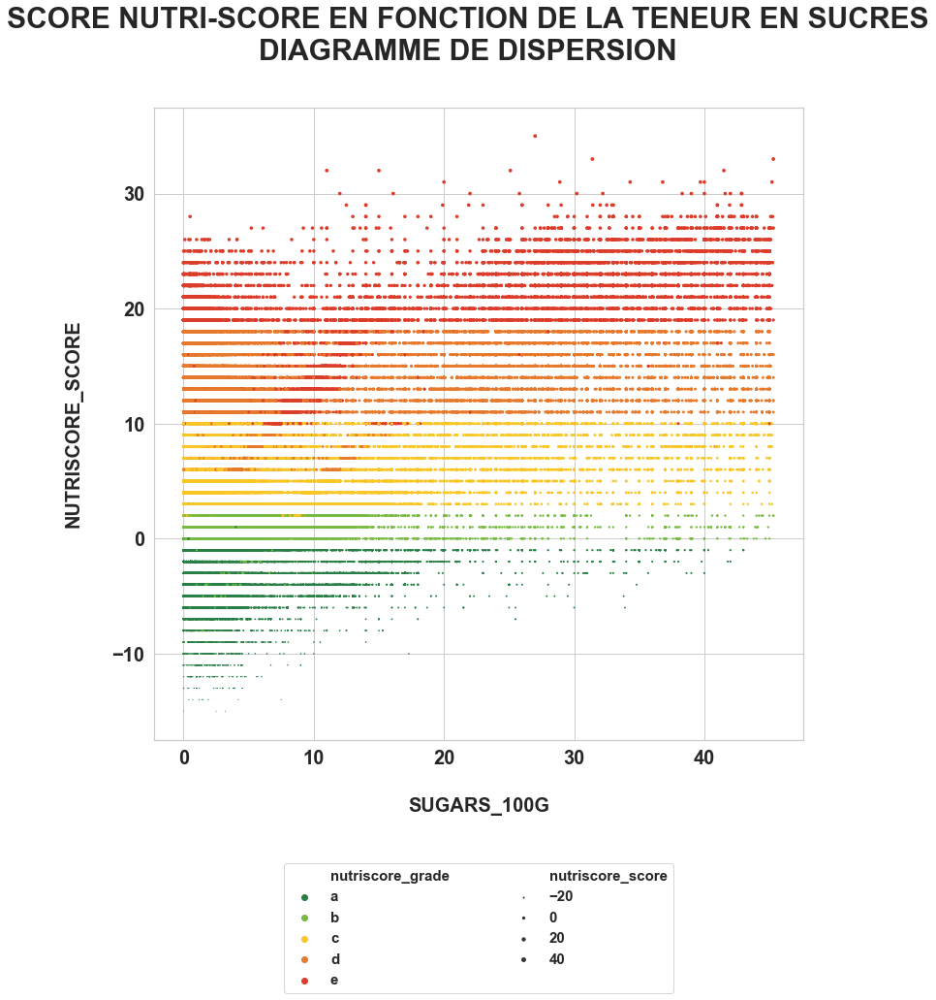

In [86]:
hf.plotScatterplotNutriScores(data, "sugars_100g","nutriscore_score",
                           "SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SUCRES\nDIAGRAMME DE DISPERSION",
                           12, 12)

> **La proportion d'aliments classés "E" augmente sensiblement avec la teneur en sucres, de même que la proportion d'aliments classés "A" diminue radicalement.**

<u>Carré du rapport de corrélation</u>

In [87]:
hf.eta_squared(data, "nutriscore_grade","sugars_100g")

0.19594503714642128

>**La différence d'une note nutriscore à une autre rend compte de 19.6% de la variabilité totale de la teneur en sucre.**

- **PROTEINS_100g**

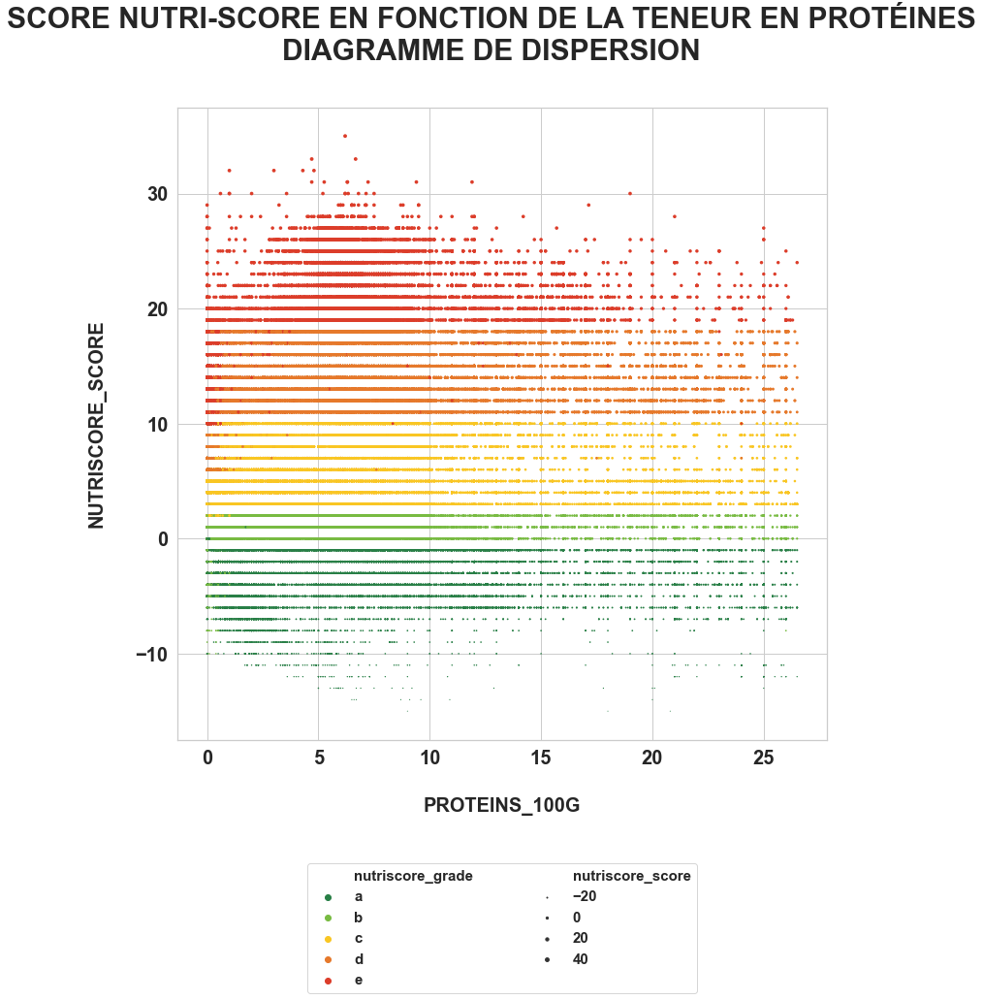

In [88]:
hf.plotScatterplotNutriScores(data, "proteins_100g","nutriscore_score",
                           "SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN PROTÉINES\nDIAGRAMME DE DISPERSION",
                           12, 12)

> **La proportion d'aliments classés "E" diminue sensiblement avec la teneur en protéines, de même que la proportion d'aliments classés "A" augmente sensiblement.**

<u>Carré du rapport de corrélation</u>

In [89]:
hf.eta_squared(data, "nutriscore_grade","proteins_100g")

0.023233742186710194

>**La différence d'une note nutriscore à une autre rend compte de 2,3% de la variabilité totale de la teneur en protéines.**

- **SALT_100g**

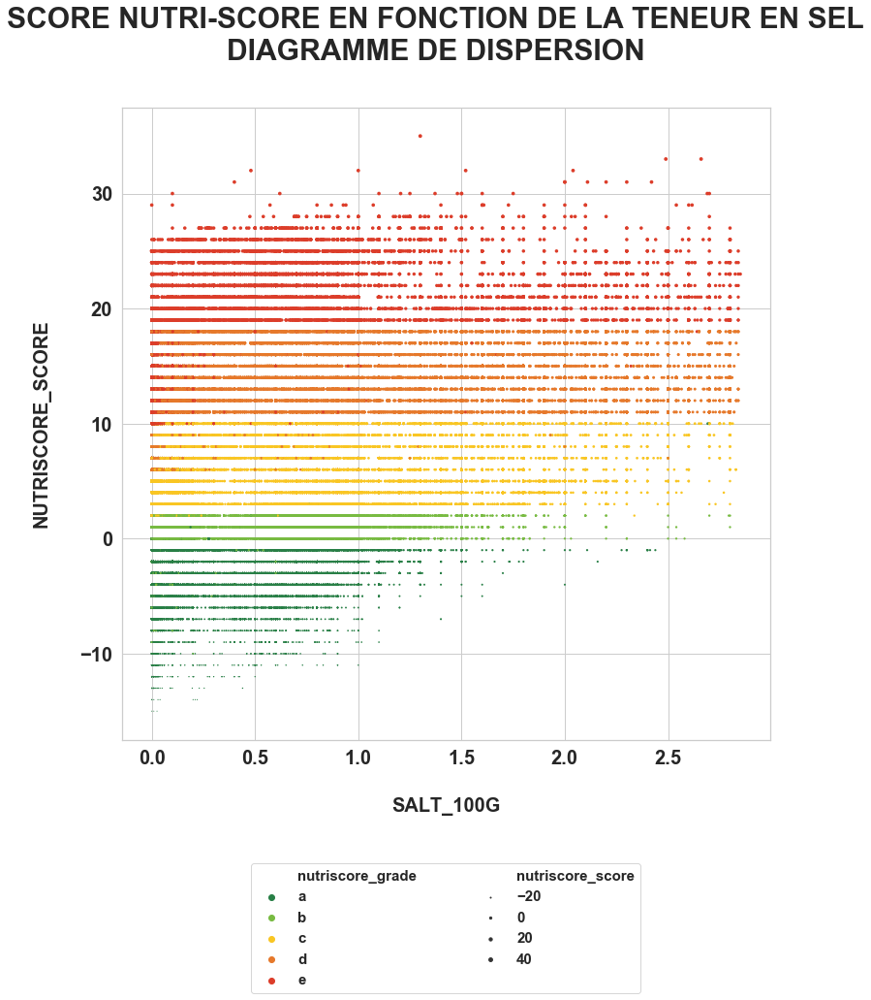

In [90]:
hf.plotScatterplotNutriScores(data, "salt_100g","nutriscore_score",
                           "SCORE NUTRI-SCORE EN FONCTION DE LA TENEUR EN SEL\nDIAGRAMME DE DISPERSION",
                           12, 12)

> **La proportion d'aliments classés "A" diminue avec l'augmentation de la teneur en sel.**

<u>Carré du rapport de corrélation</u>

In [91]:
hf.eta_squared(data, "nutriscore_grade","salt_100g")

0.14475484092720992

___
#### 2.4 CONCLUSION DE L'ANALYSE MULTIVARIÉE

L'analyse a permis d'établir une corrélation entre le Nutri-Score et plusieurs variables quantitatives et qualitatives. Il devrait donc être possible de créer un modèle qui permette de prédire celui-ci à l'aide de ces valeurs.<br>

**C'est donc l'idée que nous allons proposer : une application qui permette de prédire le Nutri-Score (note et lettre) d'un aliment en entrant certaines de ses valeurs nutritionnelles et son groupe PNNS 2.**

Dans cette optique, l'application mettra à profit les données nutritionnelles et de classification les plus corrélées établies dans cette analyse, à savoir : 
    - sa teneur calorique (energy_100g)
    - sa teneur en sucres (sugars_100g)
    - sa teneur en graisses saturées (saturated-fat_100g)
    - sa teneur en sel (salt_100g)
    - sa teneur en protéines (proteins_100g)
    - son classement PNN2 (pnns_groups_2)

### 3. Application

L'application procèdera en 2 étapes : 
   1. Régression linéaire pour prédire le score nutriscore sur la base des valeurs nutritionnelles et du groupe PNN2 par régression linéaire
   2. Classification Knn pour prédire la lettre nutriscore sur la base du score nutriscore

#### 3.1 PRÉDICTION DU SCORE NUTRISCORE : RÉGRESSION LINÉAIRE

##### _<u>3.1.1 Modèle global sur l'ensemble des données</u>_

In [92]:
xtrain, xtest, ytrain, ytest = train_test_split(data[["proteins_100g", "salt_100g", "energy_100g",
                                                      "saturated-fat_100g", "sugars_100g"]], 
                                                data[["nutriscore_score"]], 
                                                test_size=0.3)

In [93]:
lr = LinearRegression()
lr.fit(xtrain[["proteins_100g", "salt_100g", "energy_100g",
                       "saturated-fat_100g", "sugars_100g"]], ytrain)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [94]:
ypredicted = lr.predict(xtest[["proteins_100g", 
                      "salt_100g", 
                      "energy_100g", 
                      "saturated-fat_100g", 
                      "sugars_100g"]])

_<u>Évaluation de la qualité de la prédiction du modèle :</u>_

Calcul du coefficient de détermination R2 :

In [95]:
r2_score(ypredicted, ytest["nutriscore_score"])

0.6060767994503837

>**Le modèle a réussi à expliquer 60% des variations.**

##### _<u>3.1.2 Modèle amélioré avec composante sur chaque groupe PNN2 </u>_

La valeur qualitative que représente le groupe PNNS 2 de l'aliment ayant montré une forte relation au Nutri-Score, nous allons affiner et améliorer le modèle en lui donnant une composante pour chaque groupe PNNS 2.

In [96]:
xtrain, xtest, ytrain, ytest = train_test_split(data[["proteins_100g", "salt_100g", "energy_100g",
                                                      "saturated-fat_100g", "sugars_100g", 
                                                      "pnns_groups_2"]], 
                                                data[["nutriscore_score"]], 
                                                test_size=0.3)

In [97]:
# Génération d'un jeu de données par pnns_groups_2
lrs = {}
for i in np.unique(xtrain["pnns_groups_2"]):

    # On génère un jeu de données par arrondissement
    tr_arr = xtrain['pnns_groups_2']==i
    te_arr = xtest['pnns_groups_2']==i
    
    xtrain_arr = xtrain[tr_arr]
    ytrain_arr = ytrain[tr_arr]

    xtest_arr = xtest[te_arr]
    ytest_arr = ytest[te_arr]

    lr = LinearRegression()
    lr.fit(xtrain_arr[["proteins_100g", "salt_100g", "energy_100g",
                       "saturated-fat_100g", "sugars_100g"]], ytrain_arr)
    lrs[i] = lr

In [98]:
final_pred = []

for idx,val in xtest.iterrows():

    final_pred.append(lrs[val["pnns_groups_2"]].predict([val[["proteins_100g", 
                                                "salt_100g", 
                                                "energy_100g", 
                                                "saturated-fat_100g", 
                                                "sugars_100g"]]])[0][0])

_<u>Évaluation de la qualité de la prédiction du modèle :</u>_

Calcul du coefficient de détermination R2 :

In [99]:
r2_score(final_pred, ytest["nutriscore_score"])

0.9228709828329387

>**Le modèle amélioré a réussi à expliquer 92% des variations.**

##### _<u>3.1.3 Graphiques valeurs test et prédites </u>_

In [100]:
pred = xtest["energy_100g"].copy()
pred["final_pred"] = final_pred
pred["nutriscore_score"]=ytest["nutriscore_score"]

_<u>NUTRISCORE et ENERGIE</u>_

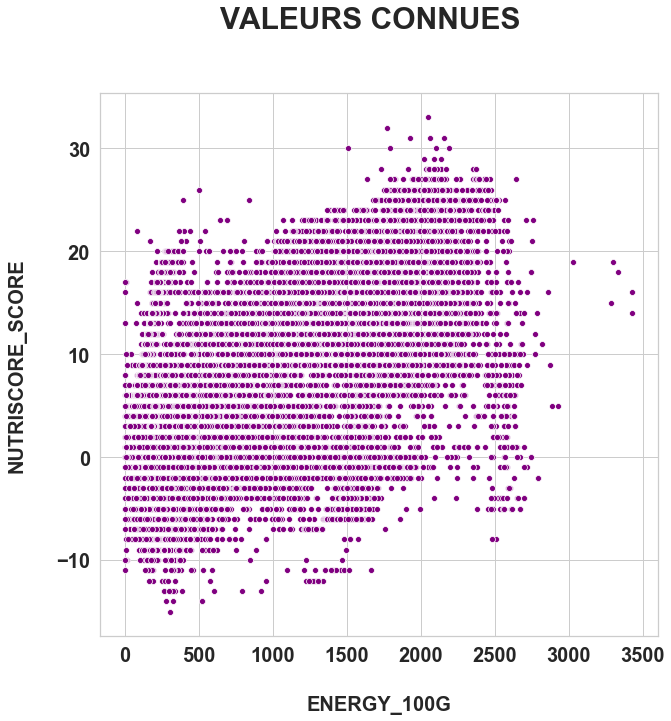

In [101]:
hf.plotSimpleScatterplot(xtest["energy_100g"], ytest["nutriscore_score"], "VALEURS CONNUES", 10, 10)

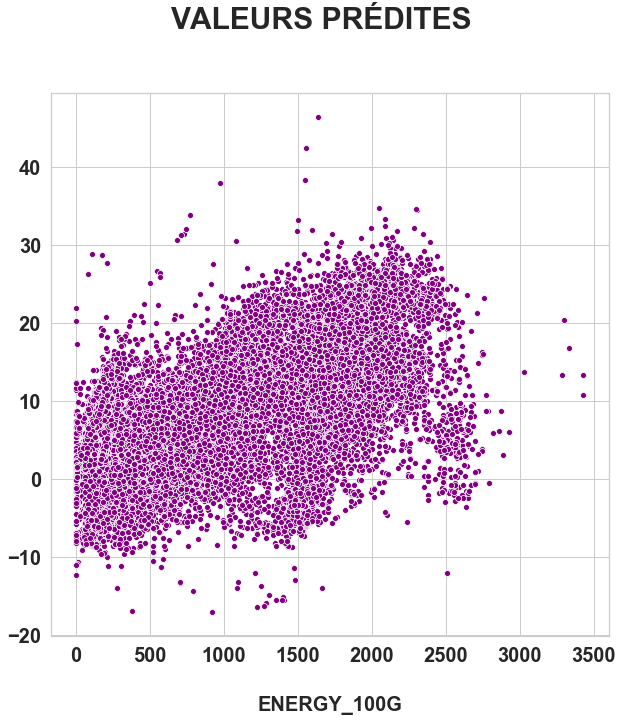

In [102]:
hf.plotSimpleScatterplot(xtest["energy_100g"], pred["final_pred"], "VALEURS PRÉDITES", 10, 10)

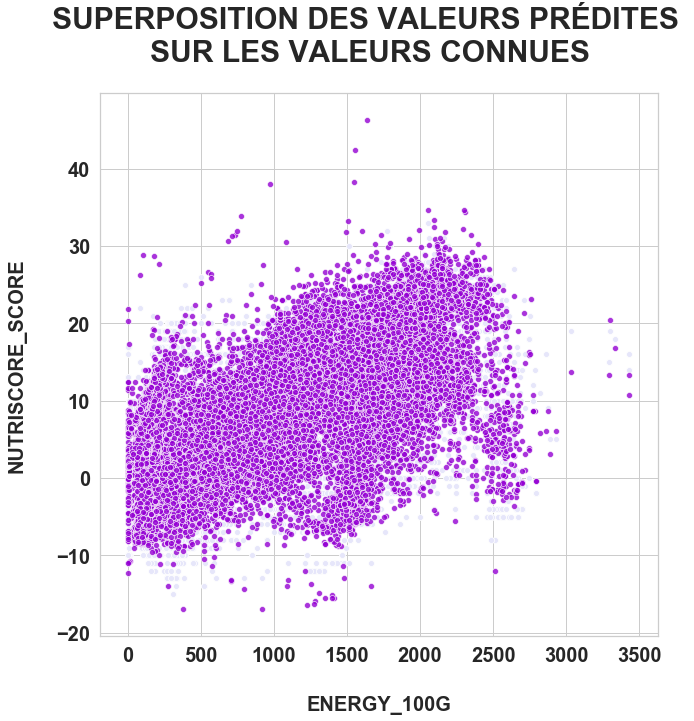

In [104]:
hf.plotSuperposedScatterplot(xtest["energy_100g"], ytest["nutriscore_score"], 
                          xtest["energy_100g"], final_pred, 
                          "SUPERPOSITION DES VALEURS PRÉDITES \nSUR LES VALEURS CONNUES", 10, 10)

_<u>NUTRISCORE et TENEUR EN GRAS SATURÉ</u>_

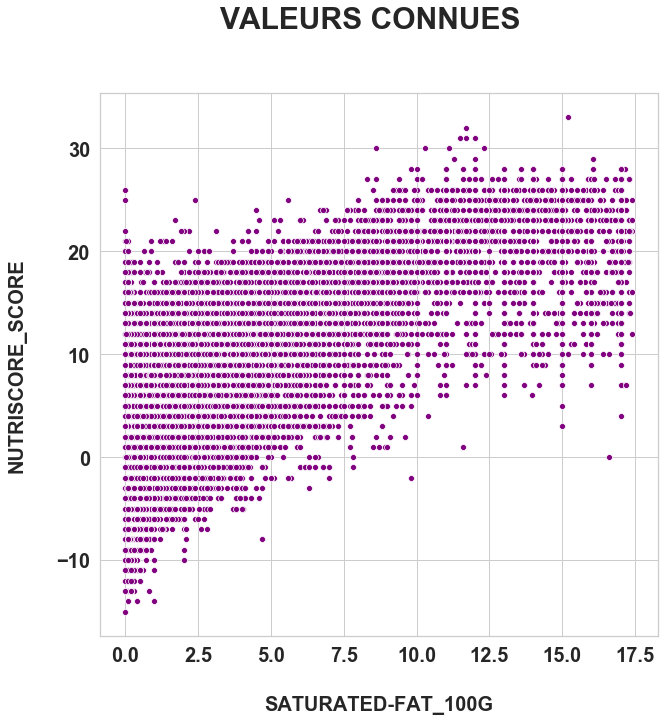

In [105]:
hf.plotSimpleScatterplot(xtest["saturated-fat_100g"], ytest["nutriscore_score"], "VALEURS CONNUES", 10, 10)

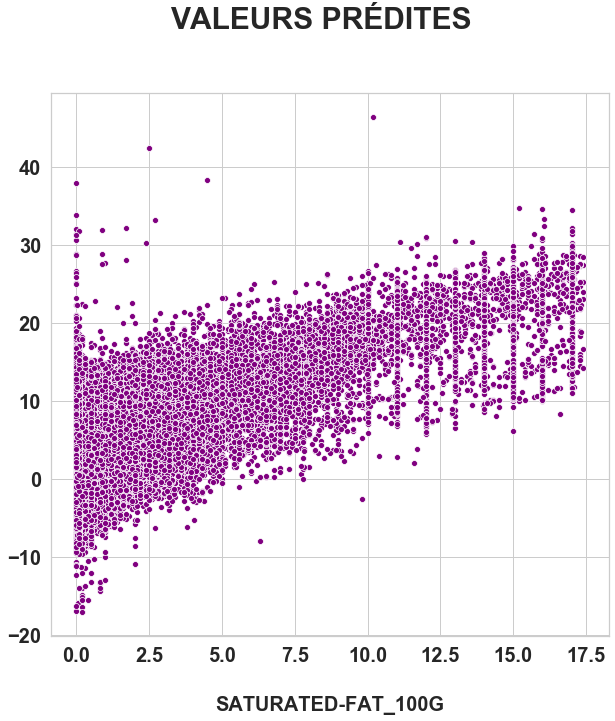

In [106]:
hf.plotSimpleScatterplot(xtest["saturated-fat_100g"], pred["final_pred"], "VALEURS PRÉDITES", 10, 10)

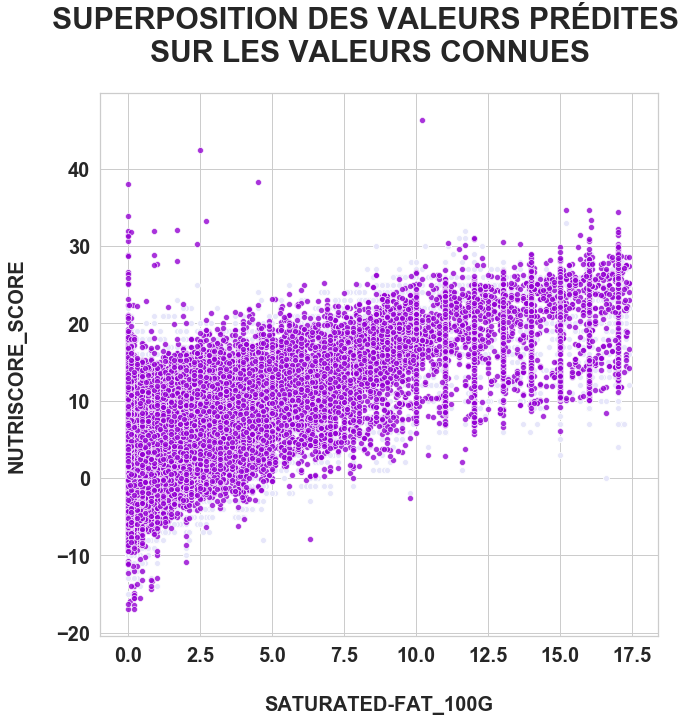

In [107]:
hf.plotSuperposedScatterplot(xtest["saturated-fat_100g"], ytest["nutriscore_score"], 
                          xtest["saturated-fat_100g"], final_pred, 
                          "SUPERPOSITION DES VALEURS PRÉDITES \nSUR LES VALEURS CONNUES", 10, 10)

_<u>NUTRISCORE et TENEUR EN SUCRES</u>_

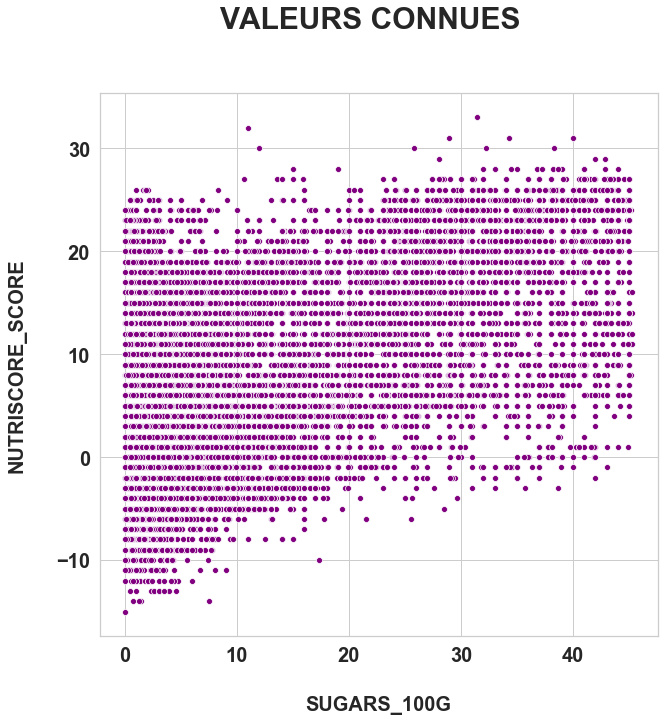

In [108]:
hf.plotSimpleScatterplot(xtest["sugars_100g"], ytest["nutriscore_score"], "VALEURS CONNUES", 10, 10)

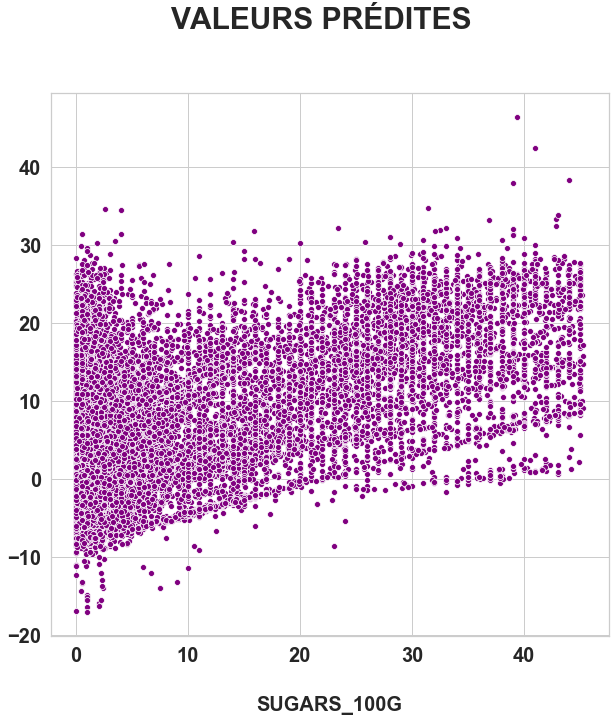

In [109]:
hf.plotSimpleScatterplot(xtest["sugars_100g"], pred["final_pred"], "VALEURS PRÉDITES", 10, 10)

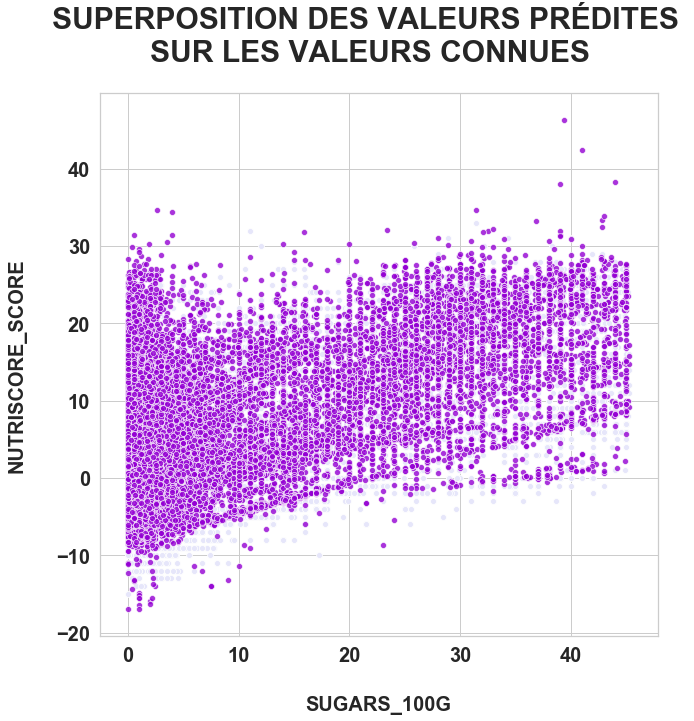

In [110]:
hf.plotSuperposedScatterplot(xtest["sugars_100g"], ytest["nutriscore_score"], 
                          xtest["sugars_100g"], final_pred, 
                          "SUPERPOSITION DES VALEURS PRÉDITES \nSUR LES VALEURS CONNUES", 10, 10)

_<u>NUTRISCORE et TENEUR EN SEL</u>_

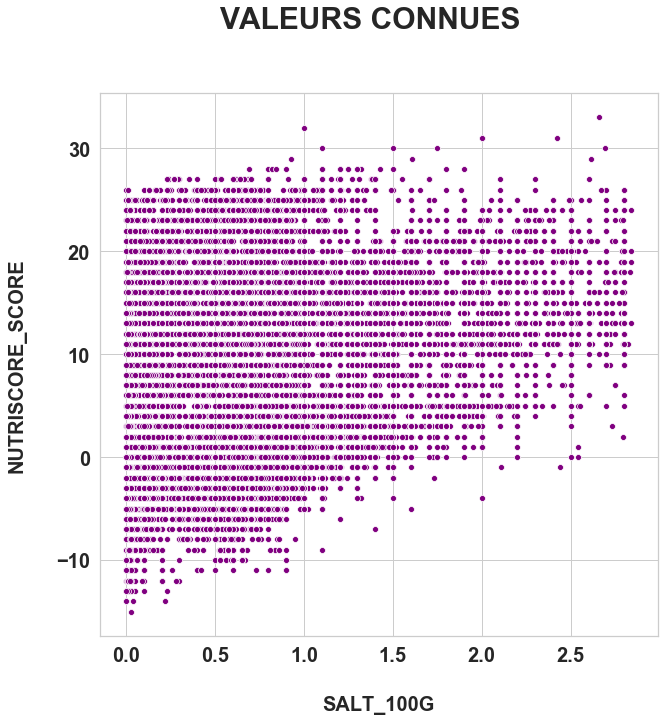

In [111]:
hf.plotSimpleScatterplot(xtest["salt_100g"], ytest["nutriscore_score"], "VALEURS CONNUES", 10, 10)

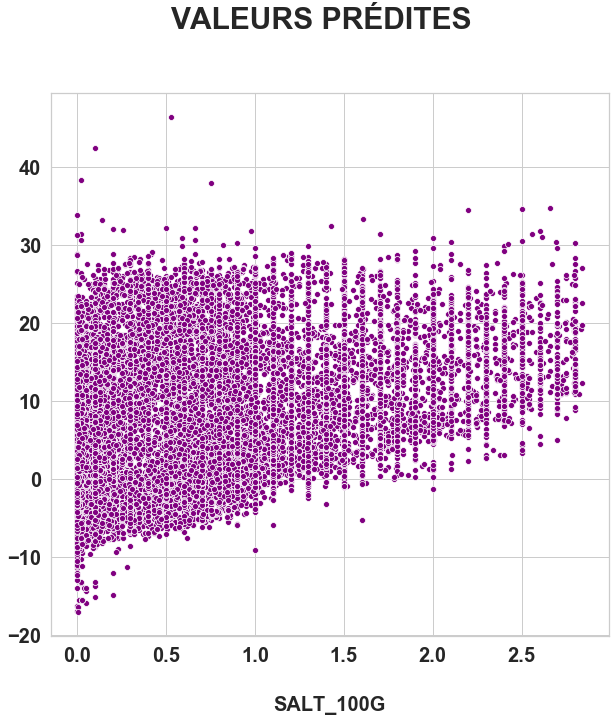

In [112]:
hf.plotSimpleScatterplot(xtest["salt_100g"], pred["final_pred"], "VALEURS PRÉDITES", 10, 10)

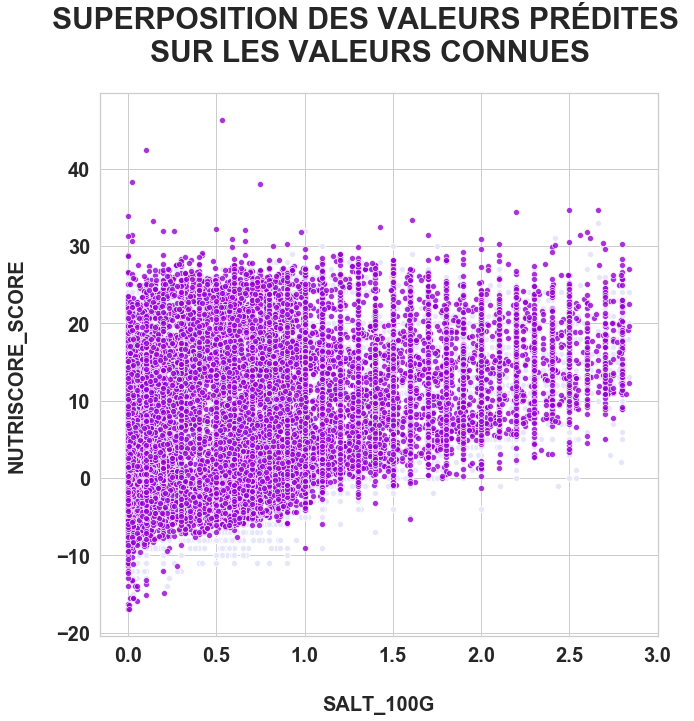

In [113]:
hf.plotSuperposedScatterplot(xtest["salt_100g"], ytest["nutriscore_score"], 
                          xtest["salt_100g"], final_pred, 
                          "SUPERPOSITION DES VALEURS PRÉDITES \nSUR LES VALEURS CONNUES", 10, 10)

_<u>NUTRISCORE et TENEUR EN PROTÉINES</u>_

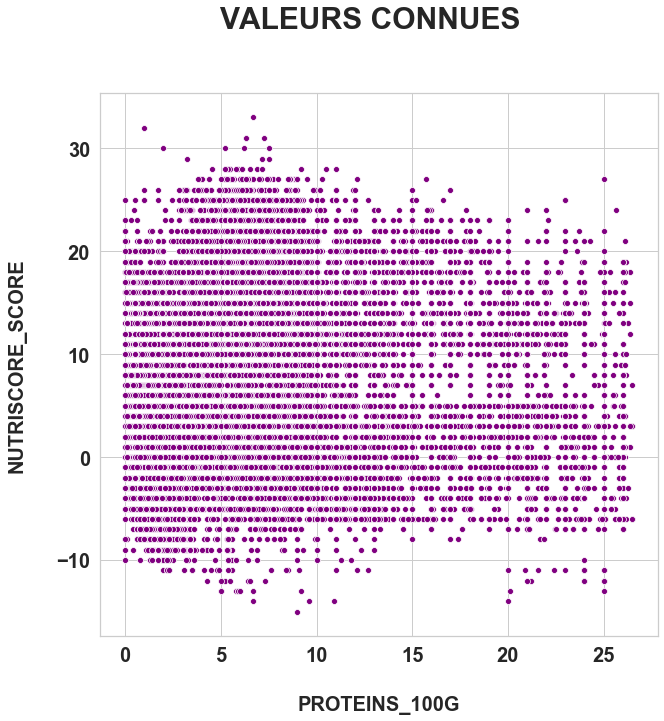

In [114]:
hf.plotSimpleScatterplot(xtest["proteins_100g"], ytest["nutriscore_score"], "VALEURS CONNUES", 10, 10)

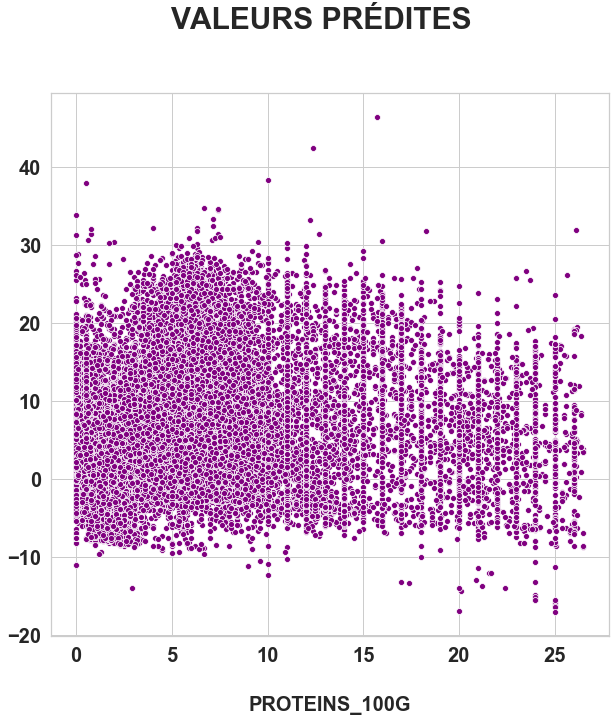

In [115]:
hf.plotSimpleScatterplot(xtest["proteins_100g"], pred["final_pred"], "VALEURS PRÉDITES", 10, 10)

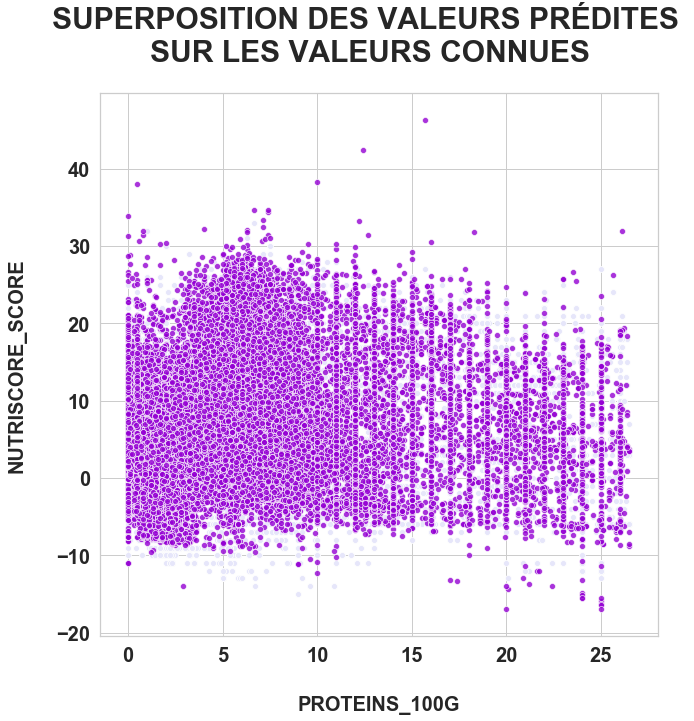

In [116]:
hf.plotSuperposedScatterplot(xtest["proteins_100g"], ytest["nutriscore_score"], 
                          xtest["proteins_100g"], final_pred, 
                          "SUPERPOSITION DES VALEURS PRÉDITES \nSUR LES VALEURS CONNUES", 10, 10)

_<u>NUTRISCORE CONNU ET PRÉDIT</u>_

In [117]:
pred["nutriscore_score"]=ytest["nutriscore_score"]

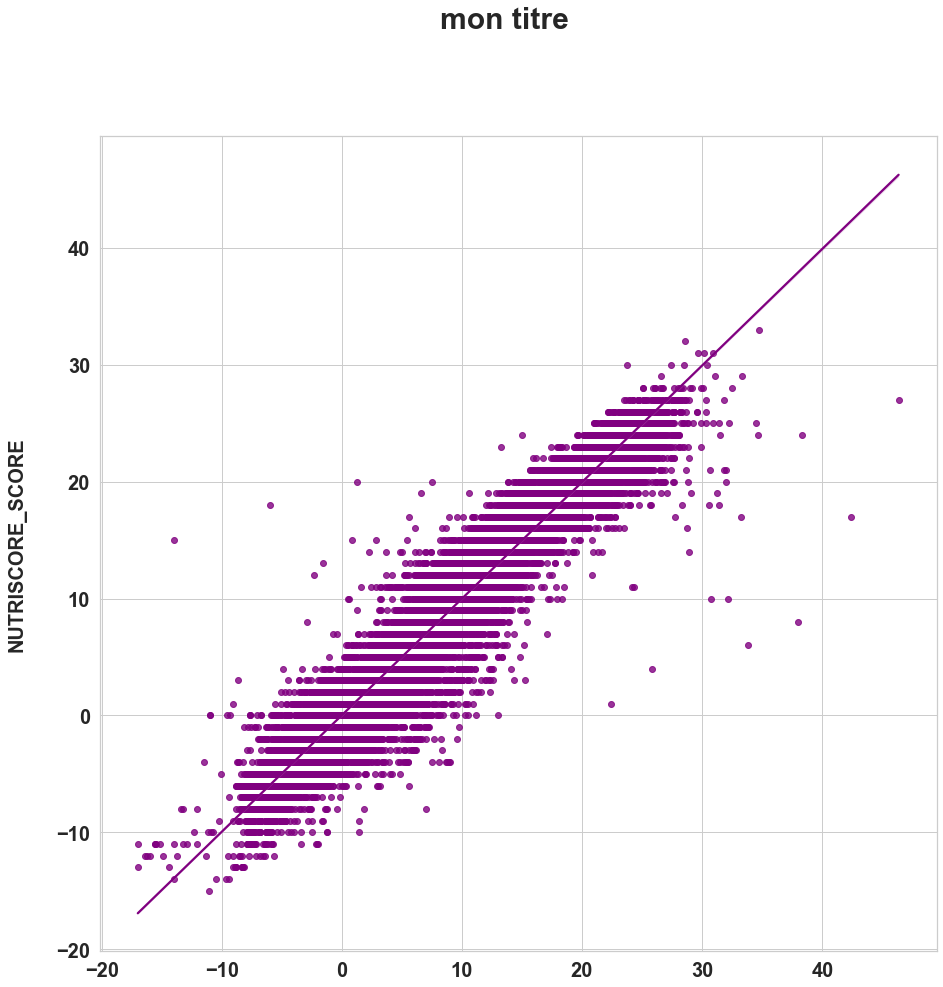

In [118]:
hf.plotRegplot(pred, "final_pred", "nutriscore_score", "mon titre", 15, 15)

#### 3.2 PRÉDICTION DE LA LETTRE NUTRISCORE : CLASSIFICATION

##### _<u>3.2.1 Classification Knn</u>_

###### <u>3.2.1.1 À partir des données nutritionnelles hors score nutriscore</u>

In [119]:
input_knn = data[["proteins_100g", "salt_100g", "energy_100g",
                  "saturated-fat_100g", "sugars_100g"]]

output_knn = data["nutriscore_grade"]

In [120]:
xtrain, xtest, ytrain, ytest = train_test_split(input_knn, output_knn, train_size=0.8)

_<u>Recherche du k optimal</u>_

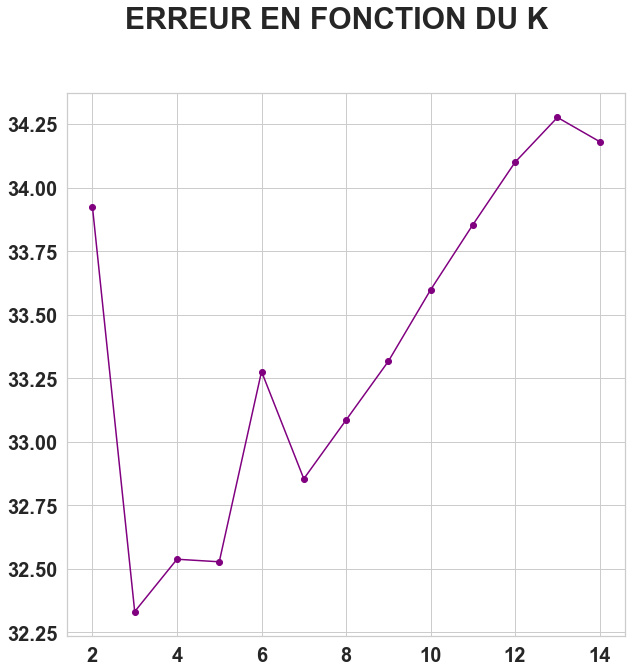

In [121]:
hf.plotOptimalK(xtrain, ytrain, xtest, ytest, 
             "ERREUR EN FONCTION DU K", 10, 10)

> Le k optimal vaut 3.

In [122]:
K_optimal = 3

knn = neighbors.KNeighborsClassifier(n_neighbors=K_optimal)
knn.fit(xtrain, ytrain)

# On récupère les prédictions sur les données test
predicted = knn.predict(xtest)

_<u>Évaluation de la qualité de la prédiction du modèle :</u>_

Calcul de l'exactitude moyenne :

In [123]:
knn.score(xtest, ytest)

0.6766788889446984

>**Le modèle est exact à 68%.**

_<u>Graphiques valeurs test et prédites</u>_

In [124]:
pred = ytest.copy()
pred["predicted"] = [predicted]
pred_df = pd.DataFrame(pred).rename(columns={"nutriscore_grade":"predicted_nutriscore_grade"})

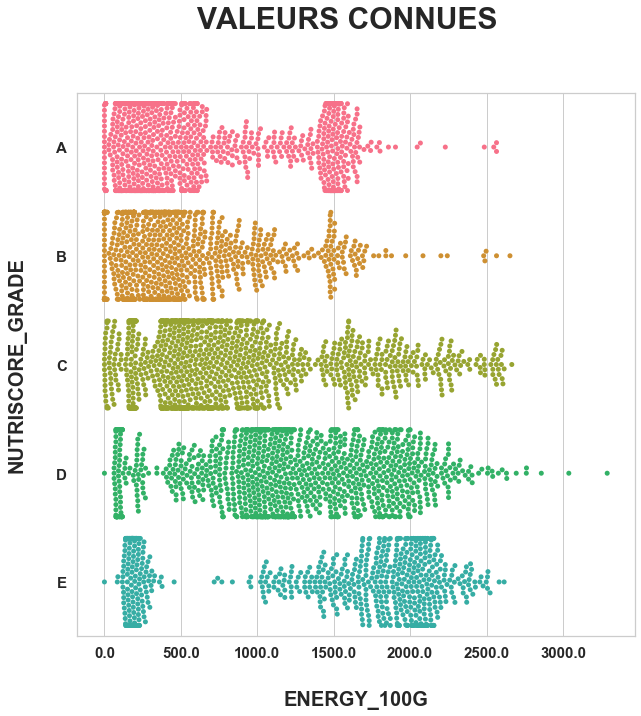

In [125]:
hf.plotSimpleSwarmplot(xtest["energy_100g"], ytest, "VALEURS CONNUES", 10, 10)

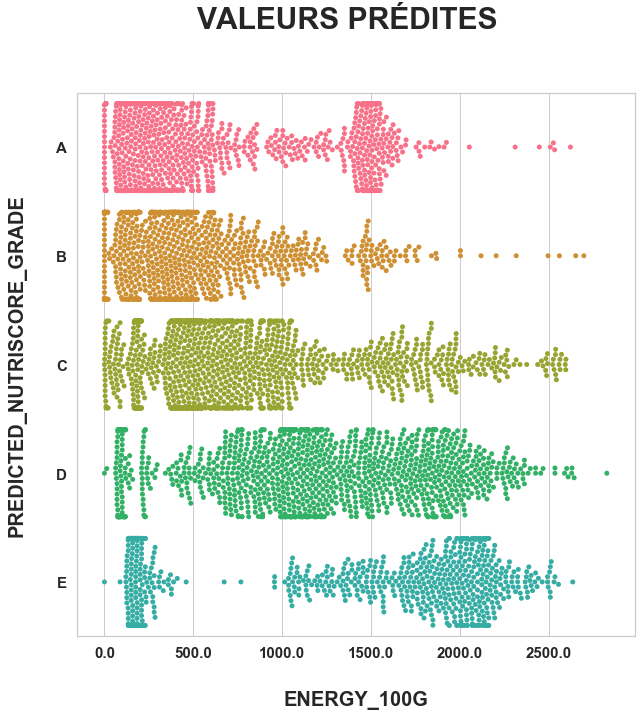

In [126]:
hf.plotSimpleSwarmplot(xtest["energy_100g"], pred_df["predicted_nutriscore_grade"], "VALEURS PRÉDITES", 10, 10)

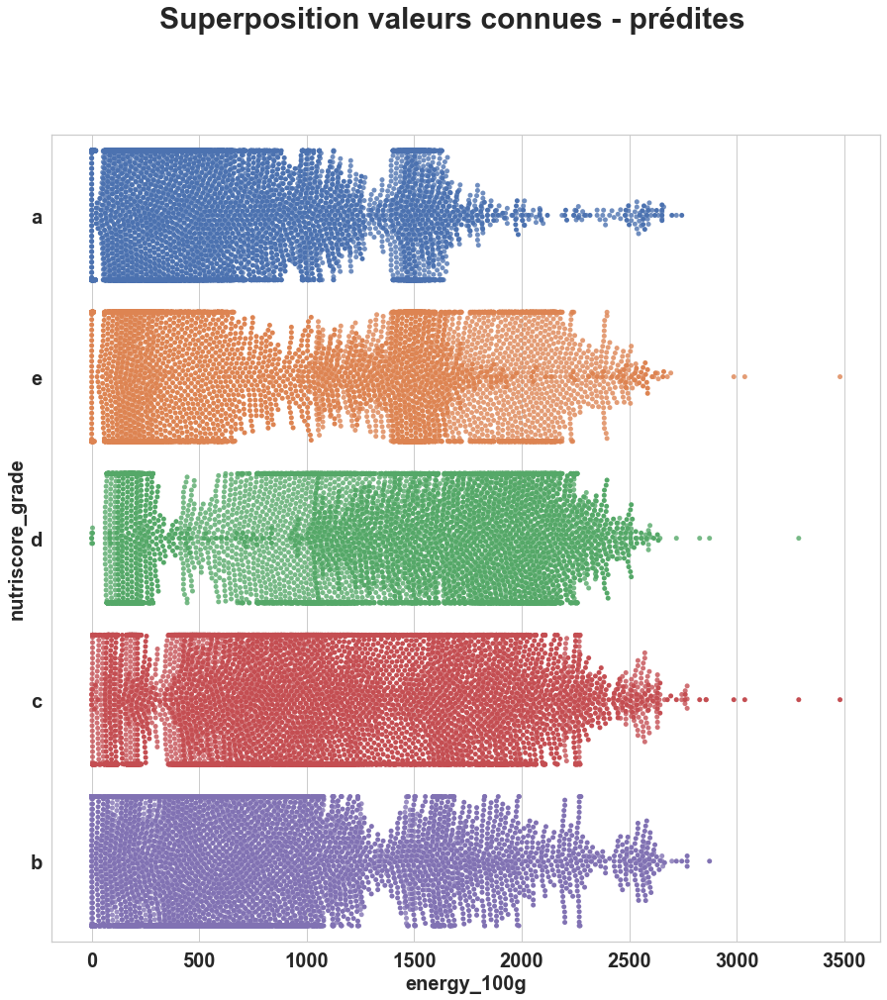

In [127]:
hf.plotSuperposedSwarmplot(xtest["energy_100g"], ytest,
                        xtest["energy_100g"], predicted, 
                        "Superposition valeurs connues - prédites", 15, 15)

###### <u>3.2.1.2 À partir du score nutriscore</u>

In [128]:
input_knn = data[["nutriscore_score"]]

output_knn = data["nutriscore_grade"]

In [129]:
xtrain, xtest, ytrain, ytest = train_test_split(input_knn, output_knn, train_size=0.8)

_<u>Recherche du k optimal</u>_

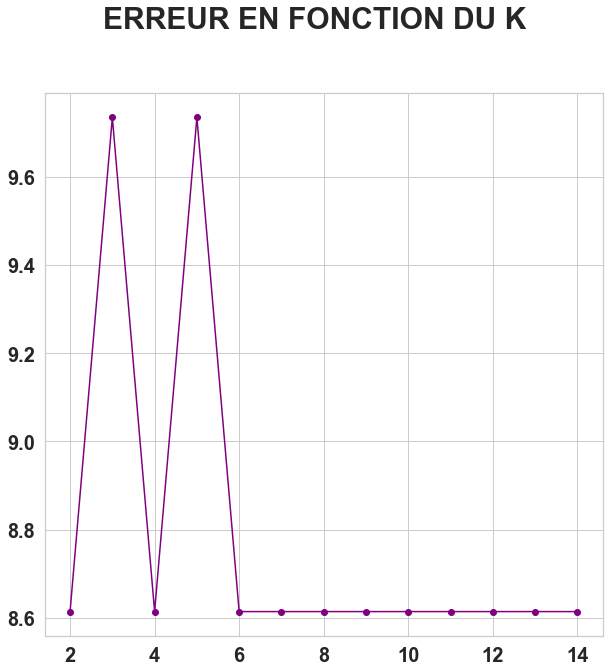

In [130]:
hf.plotOptimalK(xtrain, ytrain, xtest, ytest, 
             "ERREUR EN FONCTION DU K", 10, 10)

> On choisit k = 8 comme K optimal afin de minimiser le temps de calcul tout en conservant une erreur minimale.

In [131]:
K_optimal = 8

knn = neighbors.KNeighborsClassifier(n_neighbors=K_optimal)
knn.fit(xtrain, ytrain)

# On récupère les prédictions sur les données test
predicted = knn.predict(xtest)

_<u>Évaluation de la qualité de la prédiction du modèle :</u>_

Calcul de l'exactitude moyenne :

In [132]:
knn.score(xtest, ytest)

0.913858054146366

>**Le modèle est exact à 91%.**

_<u>Graphiques valeurs test et prédites</u>_

In [133]:
pred_2 = ytest.copy()
pred_2["predicted"] = [predicted]
pred_2_df = pd.DataFrame(pred).rename(columns={"nutriscore_grade":"predicted_nutriscore_grade"})

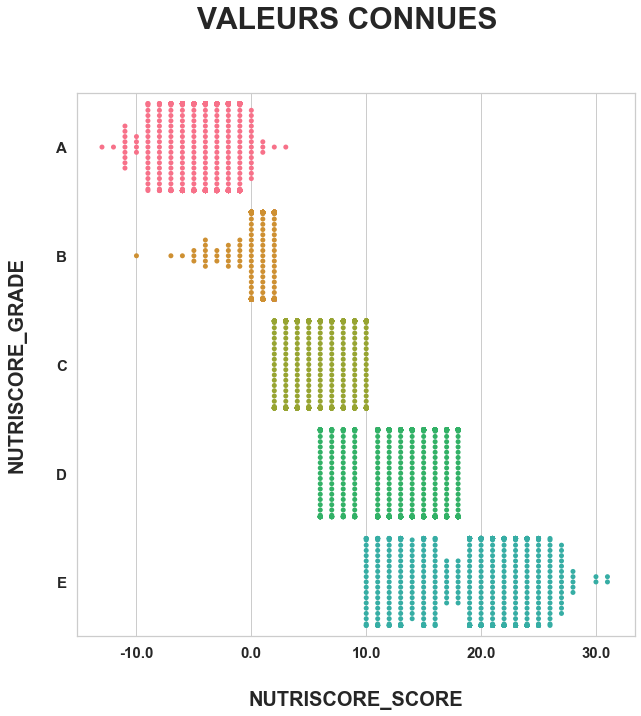

In [134]:
hf.plotSimpleSwarmplot(xtest["nutriscore_score"], ytest, "VALEURS CONNUES", 10, 10)

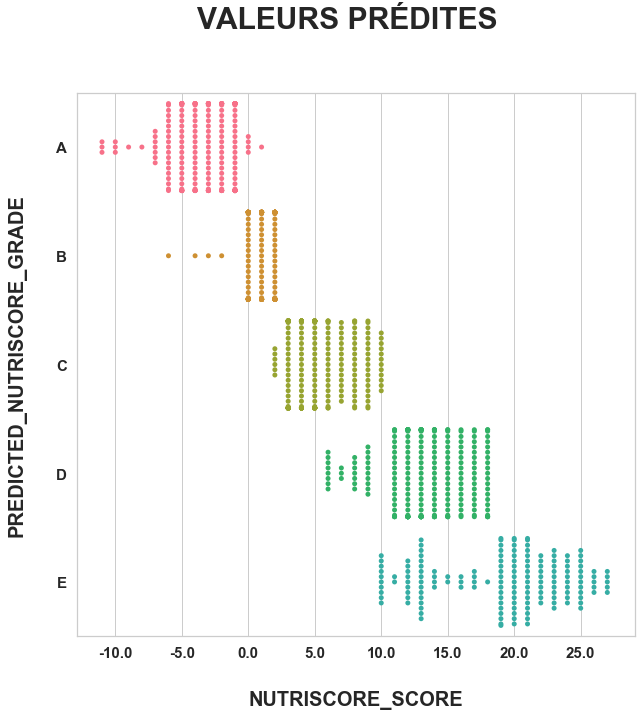

In [135]:
hf.plotSimpleSwarmplot(xtest["nutriscore_score"], pred_df["predicted_nutriscore_grade"], 
                       "VALEURS PRÉDITES", 10, 10)

___
#### 3.3 VALIDATION DU MODÈLE

Si le jeu de données le permet, nous pouvons tester le modèle sur d'autres données non utilisées.

##### _<u>3.3.1 Set de validation modèle de prédiction du score Nutri-Score</u>_

Afin de pouvoir valider la prédiction du score Nutri-Score, nous avons besoin de données où le score Nutri-Score est inconnu, mais la lettre Nutri-Score est connue.

In [136]:
# validation de la régression linéaire : lignes où la lettre nutriscore
# est connue mais pas le score

data_validation = food_data[(food_data["nutriscore_score"].isna()) & (food_data["nutriscore_grade"].notna())]

data_validation.shape

(0, 19)

>**Le jeu de données ne contient pas de produits alimentaires où la lettre Nutri-Score est connue mais pas le score Nutri-Score.<br>
Il n'est donc pas possible d'obtenir un set de validation pour la régression linéaire**

##### _<u>3.3.2 Set de validation classification</u>_

Afin de pouvoir valider la prédiction de la lettre Nutri-Score, nous avons besoin de données où la lettre Nutri-Score est inconnue, mais le score Nutri-Score est connu.

In [137]:
# validation de la classification : lignes où le score nutriscore
# est connu mais pas la lettre

data_validation = food_data[(food_data["nutriscore_grade"].isna()) & (food_data["nutriscore_score"].notna())].copy()

data_validation.shape

(3, 19)

>**le jeu de données contient trois lignes où le score Nutri-Score est connu mais pas la lettre Nutri-Score.<br>
Celles-ci peuvent être utilisées comme set de validation pour la classification.**

On va prédire la lettre du nutriscore pour ces données à partir du score Nutri-Score à l'aide de notre modèle de classification.

In [138]:
xvalidation = pd.DataFrame(data_validation["nutriscore_score"])

Pour comparer à la prédiction obtenue, on a implémenté une fonction de calcul de la lettre nutriscore suivant les directives de calcul données par l'organisme émetteur.<br>
On place le résultat du calcul dans la colonne "nutriscore_grade_calculated".

In [139]:
data_validation.loc[:,"nutriscore_grade_predicted"] = knn.predict(xvalidation)

On peut ensuite afficher la prédiction et le calcul pour chaque ligne, avec leurs groupes PNN1 et 2.

In [140]:
data_validation["nutriscore_grade_calculated"] = data_validation\
                                                 .apply(lambda x: hf.\
                                                       calculNutrigradeFromNutriscore(x['nutriscore_score'],
                                                                                      x['pnns_groups_1'],
                                                                                      x['pnns_groups_2']), 
                                                       axis=1)

In [141]:
if data_validation["nutriscore_grade_predicted"].equals(data_validation["nutriscore_grade_calculated"]):
    print("Toutes les prédictions sont correctes, y compris pour les boissons !")

Toutes les prédictions sont correctes, y compris pour les boissons !


In [142]:
data_validation[["pnns_groups_1", "pnns_groups_2", 
                 "nutriscore_score", 
                 "nutriscore_grade", 
                 "nutriscore_grade_predicted", "nutriscore_grade_calculated"]]

,pnns_groups_1,pnns_groups_2,nutriscore_score,nutriscore_grade,nutriscore_grade_predicted,nutriscore_grade_calculated
109403,Fruits and vegetables,Vegetables,-3.0,NaN,a,a
109405,Fish Meat Eggs,Fish and seafood,0.0,NaN,b,b
109407,Beverages,Fruit juices,3.0,NaN,c,c


___
#### 3.4 LE CAS DES BOISSONS ALCOOLISÉES

>**Les prédictions du modèle sont correctes, y compris pour les boissons, pour lesquelles la formule du calcul du nutriscore diffère légèrement de celle des aliments solides.**

Pour notre application, nous allons donc suivre ses recommandations et modifier la fonction de prédiction globale pour assigner "F" et un score Nutri-Score arbitraire de 60 à l'ensemble des boissons alcoolisées.

Pour citer Serge Hercberg, l'épidémiologiste spécialiste en nutrition créateur du Nutri-Score et président du Programme National Nutrition Santé : 
><i>"Il n'est pas normal que les boissons alcoolisées échappent au #NutriScore.  Pour donner de la cohérence à l'étiquetage nutritionnel, il suffit d'adapter le Nutri-Score avec l'ajout d'une pastille noire (lettre F) exclusivement réservée à l'étiquetage des boissons alcoolisées."</i><br>

31 décembre 2018

La fonction centrale de notre application devient donc la suivante:

##### _<u>3.4.1 Affinement du modèle pour tenir compte des boissons alcoolisées</u>_

##### _<u>3.4.2 Tests finaux</u>_

<i><u>Test avec un produit solide : une tablette de chocolat</u></i><br>

Tablette de Chocolat noir DESSERT NESTLE 205 g <br>
(https://www.carrefour.fr/p/chocolat-noir-dessert-nestle-7613035040823)

In [143]:
product_df = pd.DataFrame()
product_df["pnns_groups_1"] = ["Sugary snacks"]
product_df["pnns_groups_2"] = ["Chocolate products"]
product_df["energy_100g"] = [553] 
product_df["saturated-fat_100g"] = [20]
product_df["sugars_100g"] = [46]
product_df["proteins_100g"] = [5.9]
product_df["salt_100g"] = [0.01]

In [144]:
NutriScore_score, NutriScore_letter = hf.getNutriScore(product_df, lrs)

In [145]:
NutriScore_score[0]

20.61442695978655

In [146]:
NutriScore_letter[0].upper()

'E'

**Ce produit est effectivement classifié "E".**

<i><u>Test avec un produit liquide : une bouteille de jus</u></i><br>

Jus multifruits pur jus CARREFOUR<br> (https://www.carrefour.fr/p/jus-multifruits-pur-jus-carrefour-3560070215713)

In [147]:
product_df = pd.DataFrame()
product_df["pnns_groups_1"] = ["Beverages"]
product_df["pnns_groups_2"] = ["Fruit juices"]
product_df["energy_100g"] = [45] 
product_df["saturated-fat_100g"] = [0.0]
product_df["sugars_100g"] = [10]
product_df["proteins_100g"] = [0]
product_df["salt_100g"] = [0.0]

In [148]:
NutriScore_score, NutriScore_letter = hf.getNutriScore(product_df, lrs)

In [149]:
NutriScore_score[0]

2.6665781371564687

In [150]:
NutriScore_letter[0].upper()

'C'

**Ce produit est effectivement classifié "C".**

_<u>Test avec un produit liquide : une bouteille de rhum</u>_

In [151]:
product_df = pd.DataFrame()
product_df["pnns_groups_1"] = ["Beverages"]
product_df["pnns_groups_2"] = ["Alcoholic Beverages"]
product_df["energy_100g"] = [""] 
product_df["saturated-fat_100g"] = [""]
product_df["sugars_100g"] = [""]
product_df["proteins_100g"] = [""]
product_df["salt_100g"] = [""]

In [152]:
NutriScore_score, NutriScore_letter = hf.getNutriScore(product_df, lrs)

In [153]:
NutriScore_score[0]

60

In [154]:
NutriScore_letter[0]

'F'

**Ce produit devrait effectivement être classifié "F".**

___
### Annexes

In [ ]:
##########################################
#                                        #
# Fonctions de calcul et de descriptions #
#                                        #
##########################################

def getMissingValuesPercentPer(data):
    ''' 
        Calculates the mean percentage of missing values
        in a given pandas dataframe per unique value 
        of a given column
        
        Parameters
        ----------------
        data   : pandas dataframe
                 The dataframe to be analyzed
        
        Returns
        ---------------
        A pandas dataframe containing:
            - a column "column"
            - a column "Percent Missing" containing the percentage of 
              missing value for each value of column     
    '''
    
    missing_percent_df = pd.DataFrame({'Percent Missing':data.isnull().sum()/len(data)*100})

    missing_percent_df['Percent Filled'] = 100 - missing_percent_df['Percent Missing']

    missing_percent_df['Total'] = 100

    percent_missing = data.isnull().sum() * 100 / len(data.columns)
    
    return missing_percent_df


#------------------------------------------

def descriptionJeuDeDonnees(sourceFiles):
    ''' 
        Outputs a presentation pandas dataframe for the dataset.
        
        Parameters
        ----------------
        A dictionary with:
        - keys : the names of the files
        - values : a list containing two values : 
            - the dataframe for the data
            - a brief description of the file
        
        Returns
        ---------------
        A pandas dataframe containing:
            - a column "Nom du fichier" : the name of the file
            - a column "Nb de lignes"   : the number of rows per file 
            - a column "Nb de colonnes" : the number of columns per file
            - a column "Description"    : a brief description of the file     
    '''

    print("Les données se décomposent en {} fichier(s): \n".format(len(sourceFiles)))

    filenames = []
    files_nb_lines = []
    files_nb_columns = []
    files_descriptions = []

    for filename, file_data in sourceFiles.items():
        filenames.append(filename)
        files_nb_lines.append(len(file_data[0]))
        files_nb_columns.append(len(file_data[0].columns))
        files_descriptions.append(file_data[1])

        
    # Create a dataframe for presentation purposes
    presentation_df = pd.DataFrame({'Nom du fichier':filenames, 
                                    'Nb de lignes':files_nb_lines, 
                                    'Nb de colonnes':files_nb_columns, 
                                    'Description': files_descriptions})

    presentation_df.index += 1

    
    return presentation_df

#------------------------------------------

def getBootstrapMean(X, numberb):
    '''
        Calculate the bootstrap mean for a column
        Source : Introduction to Data Science,
        
        Parameters
        ----------------
        - X       : the data series to calculate the
                    bootstrap mean on
        - numberb : the number of samplings to perform
        
        Returns
        ---------------
        The bootstrap men of the column
    '''
    
    x = [0] * numberb
    
    for i in range(numberb):
        sample = [X[j]
                  for j
                  in np.random.randint(len(X), size=len(X))
                 ]
        x[i] = np.mean(sample)
    return mean(x)
    
#------------------------------------------

#-----------------------------------------------------------------
# WARNING : only works if 2 doublons
# TODO : Systemize function below to work for 3 or more doublons
#-----------------------------------------------------------------

def fuseDoublonRows(data, criteria_doublon):
    '''
        Returns a dataframe containing one fused row
        instead of two doublons rows for each couple of doublons
        
        ----------------
        - data             : DataFrame containing doublon rows
        - criteria_doublon : the name of the column to determine if
                             two rows are doublons
        
        Returns
        ---------------
        The dataframe with the fused rows, without the doublons
    '''
    
    duplicates = data[data[criteria_doublon].duplicated()][criteria_doublon]
    data_duplicates = data[data[criteria_doublon].isin(duplicates)]

    #-----------------------------------------------------------------
    # Merging the data from the doublons :
    # the new row becomes the first one, with its NaN values replaced
    # by the non NaN values of the second row
    #-----------------------------------------------------------------

    merged_duplicates = pd.DataFrame()

    for criteria_duplicate in duplicates:
        tmp_df = data_duplicates[data_duplicates[criteria_doublon]==criteria_duplicate]

        obj_df = tmp_df.select_dtypes(include=[np.object])
        num_df = tmp_df.select_dtypes(exclude=[np.object])

        merged_row = pd.concat([obj_df.head(1).fillna(obj_df.tail(1)).reset_index(drop=True),
                                num_df.max().to_frame().T.reset_index(drop=True)], axis=1)

        merged_duplicates = pd.concat([merged_duplicates, merged_row])

    #-----------------------------------------------------------------
    # Creating a new dataframe without the doublons, but with the
    # newly merged rows
    #-----------------------------------------------------------------

    return pd.concat([data[~data[criteria_doublon].isin(duplicates)],
                            merged_duplicates])
     
#------------------------------------------

def replaceValues(data, column, values):
    '''
        Replaces in place the given values by the given replacement
        values in a column of a dataframe
        
        ----------------
        - data   : DataFrame containing the values to
                   replace
        - column : The name of the column containing the values
                    to replace
        - values : A dictionary containing the values to replace
                   as keys, and the replacement values as values
        
        Returns
        ---------------
        _
    '''
    
    for value_error, value_correct in values.items():
        data.loc[data[column] == value_error, column] = value_correct
        
#------------------------------------------

def replaceNaNValues(data, cols, criterion, valueType):
    '''
        Replaces in place the NaN values in the list of columns given
        grouped by criterion if given, by the mode or the mean
        depending on the valueType given ("QUAL" or "QUANT")
        
        ----------------
        - data      : DataFrame containing the NaN values
        - cols      : A list containing the names of the columns in which
                      to replace the NaN values
        - criterion : The name of the column to groupby on for the calculation
                      of the mean
        - valueType : The type of values contained in the columns listed in
                      "cols" : "QUAL" or "QUANT"
        
        Returns
        ---------------
        _
    '''
    
    for column in cols:
        if criterion != None:
            value_per_criterion = {}

            for val_criterion, data_df in data.groupby([criterion]):
                if valueType == "QUAL":
                    value_per_criterion[val_criterion] = data_df[column].mode()[0]
                elif valueType == "QUANT":
                    value_per_criterion[val_criterion] = data_df[column].mean()

            for criterion_value, value in value_per_criterion.items():
                data.loc[data[criterion] == criterion_value, column] \
                = \
                data.loc[data[criterion] == criterion_value, column].fillna(value)
        else:
            if valueType == "QUAL":
                value = data[column].mode()[0]
            elif valueType == "QUANT":
                value = data[column].mean()
            else:
                raise Exception("Invalid value type :" + valueType)

            data[column] = data.loc[:, column].fillna(value)
    
#------------------------------------------

def replaceNaNQualitative(data, qualitative_cols, criterion=None):
    '''
        ** ONLY FOR COLUMNS CONTAINING QUALITATIVE INFO **
        
        Replaces in place the NaN values in the list of columns given
        by the mean of the column, grouped by criterion if given
        
        ----------------
        - data             : DataFrame containing the NaN values
        - qualitative_cols : A list containing the names of the
                             columns in which to replace the NaN
                             values
        - criterion        : The name of the column to groupby on for the
                             calculation of the mean
        
        Returns
        ---------------
        _
    '''
    
    replaceNaNValues(data, qualitative_cols, criterion, "QUAL")

#------------------------------------------

def replaceNaNQuantitative(data, quantitative_cols, criterion=None):
    '''
        ** ONLY FOR COLUMNS CONTAINING QUANTITATIVE INFO **
        
        Replaces in place the NaN values in the list of columns given
        by the mode of the column, grouped by criterion if given
        
        ----------------
        - data              : DataFrame containing the NaN values
        - quantitative_cols : A list containing the names of the
                              columns in which to replace the NaN
                              values
        - criterion         : The name of the column to groupby on for the
                              calculation of the mode
        
        Returns
        ---------------
        _
    '''
    
    replaceNaNValues(data, quantitative_cols, criterion, "QUANT")
              
#------------------------------------------

def removeOutlierValues(data, quantitative_columns, criterion=None):
    '''
        Removes the outliers in the given dataframe, grouped by criterion
        if given, in the given columns containing quantitative data
        
        ----------------
        - data                : The dataframe from which outliers need to
                                be removed
        - qualitative_columns : A list containing the names of the
                                columns in which to replace the NaN
                                values
        - criterion            : The name of the column to groupby and
                                 determine the outliers on
        
        Returns
        ---------------
        _ filtered_df : the dataframe without the outliers
    '''
    
    filtered_df = data.copy()

    if criterion != None:
        ## TODO : IMPLEMENT
        #for criterion_value, data_criterion in filtered_df.groupby([criterion]):
        print("TO IMPLEMENT")
        
    else:
        for column in quantitative_columns:
            Q1 = filtered_df[column].quantile(0.25)
            Q3 = filtered_df[column].quantile(0.75)
            IQR = Q3 - Q1
            
            # Filtering Values between Q1-1.5IQR and Q3+1.5IQR
            filtered_df = filtered_df.query('(@Q1 - 1.5 * @IQR) <= '+ str(column) +' <= (@Q3 + 1.5 * @IQR)')
          
    return filtered_df

#------------------------------------------

def getContingencyTable(data, x, y):
    '''
        Returns a dataframe containing the contingency
        table for the heatmap
        
        ----------------
        - data : The dataframe from which the table will be calculated
        - x    : The name of the 1st variable (columns)
        - y    : The name of the 2nd variable (rows)
        
        Returns
        ---------------
        data_df_contingency : a dataframe containing the contingency table
    '''
    
    data_df_contingency = pd.crosstab(data[y], data[x])
    data_df_contingency["Total"] = data_df_contingency.sum(axis=1)
    index_columns = data_df_contingency.index.tolist()
    data_df_contingency = data_df_contingency.append(data_df_contingency.sum(numeric_only=True),
                                                                             ignore_index=True)
    data_df_contingency[y]= index_columns + ["Total"]
    data_df_contingency = data_df_contingency.set_index(y)

    return data_df_contingency

#------------------------------------------

def getKhi2TableAndData(data_contingency):
    '''
        Carries out a Khi-2 test on a contingency dataframe.
        
        ----------------
        - data_contingency : The dataframe containing the contingency
                             table
        
        Returns
        ---------------
        A tuple containing :
            - table : the Khi-2 table
            - stat  : the result of the Khi-2 test
            - p     : the p-value
            - expected : the expected table in case of H0
    '''
    
    stat, p, dof, expected = chi2_contingency(data_contingency)

    measure = (data_contingency-expected)**2/expected
    table = measure/stat

    return (table, stat, p, dof, expected)

#------------------------------------------

def getContingencyKhi2Data(data, x, y):
    '''
        Calculates the contingency table for a given dataframe
        and couple of variables, then carries out a Khi-2 test
        on this contingency table.
        
        ----------------
        - data_contingency : The dataframe containing the contingency
                             table
        
        Returns
        ---------------
        A tuple containing :
            - contingency_table : the contingency table
            - table             : the Khi-2 table
            - stat              : the result of the Khi-2 test
            - p                 : the p-value
            - expected          : the expected table in case of H0
    '''
    
    contingency_table = getContingencyTable(data, x, y)
    
    (table_khi2, stat, p, dof, expected_table) = getKhi2TableAndData(contingency_table)
    
    return (contingency_table, table_khi2, stat, p, dof, expected_table)
    
#------------------------------------------

def areDependent_withStatTest(stat, dof, prob=0.95):
    '''
        Checks independence of variables using Khi-2
        test value
        
        ----------------
        - stat : The Khi-2
        - dof  : degrees of freedom
        - prob : probability to be right rejecting H0
        
        Returns
        ---------------
        True  : H0 can be rejected with 1-prob chances
                to be wrong
        False : H0 could not be rejected for the prob
                given
    '''
    
    return abs(stat) >= chi2.ppf(prob, dof)

#------------------------------------------

def areDependent_withPValue(p, prob=0.95):
    '''
        Checks independence of variables using p-value
        from Khi-2 test
        
        ----------------
        - p : p-value from Khi-2 test
        - prob : probability to be wrong rejecting H0
        
        Returns
        ---------------
        True  : H0 can be rejected with prob chances
                to be right
        False : H0 could not be rejected for the prob
                given
    '''
    
    return p < 1.0 - prob
    
#------------------------------------------

def areDependent(stat, dof, p_value, prob=0.95):
    '''
        Checks independence of variables examining
        Khi-2 and p-values.
        
        ----------------
        - stat : The Khi-2
        - dof  : degrees of freedom
        - p_value : p-value
        - prob : probability to be right rejecting H0
        
        Returns
        ---------------
        True  : H0 can be rejected with 1-prob chances
                to be wrong
        False : H0 could not be rejected for the prob
                given
    '''
    
    if areDependent_withStatTest(stat, dof) and areDependent_withPValue(p_value):
        print("The variables are dependent - H0 rejected")
    elif ~areDependent_withStatTest(stat, dof):
        print("The stat test has failed to reject H0 - variables may be independent")
    elif ~areDependent_withPValue(p_value):
        print("The p-value test has failed to reject H0 - variables may be independent")
    else:
        print("The variables are independent - Fail to reject H0")

#------------------------------------------

def eta_squared(data, x_qualit,y_quantit):
    '''
        Calculate the proportion of variance
        in the given quantitative variable for
        the given qualitative variable
        
        ----------------
        - data      : The dataframe containing the data
        - x_quantit : The name of the qualitative variable
        - y_quantit : The name of the quantitative variable
        
        Returns
        ---------------
        Eta_squared
    '''
    
    sous_echantillon = data.copy().dropna(how="any")

    x = sous_echantillon[x_qualit]
    y = sous_echantillon[y_quantit]

    moyenne_y = y.mean()
    classes = []
    for classe in x.unique():
        yi_classe = y[x==classe]
        classes.append({'ni': len(yi_classe),
                        'moyenne_classe': yi_classe.mean()})
    SCT = sum([(yj-moyenne_y)**2 for yj in y])
    SCE = sum([c['ni']*(c['moyenne_classe']-moyenne_y)**2 for c in classes])
    return SCE/SCT
    
#------------------------------------------

def calculNutrigradeFromNutriscore(nscore, pnns_group_1, pnns_group_2):
    '''
        Determines the Nutri-Score letter from the Nutri-Score score
        and the pnns groups
        
        ----------------
        - nscore       : The Nutri-Score score of the product
        - pnns_group_1 : The PNNS group 1 of the product
        - pnns_group_2 : The PNNS group 2 of the product
        
        Returns
        ---------------
        The Nutri-Score letter for the product
    '''
    
    if pnns_group_1 != "Beverages":
        if nscore <=-1:
            return "a"
        elif nscore >= 0 and nscore <= 2:
            return "b"
        elif nscore >= 3 and nscore <= 10:
            return "c"
        elif nscore >= 11 and nscore <= 18:
            return "d"
        else:
            return "e"
    else:
        if pnns_group_2 == "Waters and flavored waters":
            return "a"
        elif pnns_group_2 == "Alcoholic beverages":
            return "f"
        elif nscore <=-1:
            return "b"
        elif nscore >= 2 and nscore <= 5:
            return "c"
        elif nscore >= 6 and nscore <= 9:
            return "d"
        else:
            return "e"
 
#------------------------------------------

def getLorenzGini(data):
    '''
        Calculate the lorenz curve and Gini coeff
        for a given variable
        
        ----------------
        - data       : data series
        
        Returns
        ---------------
        A tuple containing :
        - lorenz_df : a list containing the values for the
                   Lorenz curve
        - gini_coeff : the associated Gini coeff
        
        Source : www.openclassrooms.com
    '''
    
    dep = data.dropna().values
    n = len(dep)
    lorenz = np.cumsum(np.sort(dep)) / dep.sum()
    lorenz = np.append([0],lorenz) # La courbe de Lorenz commence à 0

    #---------------------------------------------------
    # Gini :
    # Surface sous la courbe de Lorenz. Le 1er segment
    # (lorenz[0]) est à moitié en dessous de 0, on le
    # coupe donc en 2, on fait de même pour le dernier
    # segment lorenz[-1] qui est à 1/2 au dessus de 1.
    #---------------------------------------------------

    AUC = (lorenz.sum() -lorenz[-1]/2 -lorenz[0]/2)/n
    # surface entre la première bissectrice et le courbe de Lorenz
    S = 0.5 - AUC
    gini_coeff = [2*S]
         
    return (lorenz, gini_coeff)
    
#------------------------------------------

def getLorenzsGinis(data):
    '''
        Calculate the lorenz curve and Gini coeffs
        for all columns in the given dataframe
        
        ----------------
        - data       : dataframe
        
        Returns
        ---------------
        A tuple containing :
        - lorenz_df : a dataframne containing the values for the
                      Lorenz curve for each column of the given
                      dataframe
        - gini_coeff : a dataframe containing the associated Gini
                       coeff for each column of the given dataframe
    '''
    
    ginis_df = pd.DataFrame()
    lorenzs_df = pd.DataFrame()

    for ind_quant in data.columns.unique().tolist():
        lorenz, gini = getLorenzGini(data[ind_quant])
        ginis_df[ind_quant] = gini
        lorenzs_df[ind_quant] = lorenz

    n = len(lorenzs_df)
    xaxis = np.linspace(0-1/n,1+1/n,n+1)
    lorenzs_df["index"]=xaxis[:-1]
    lorenzs_df.set_index("index", inplace=True)
    
    ginis_df = ginis_df.T.rename(columns={0:'Indice Gini'})
    
    return (lorenzs_df, ginis_df)

#------------------------------------------

def getNutriScore(product_df, lrs, knn=None):
    '''
        Determines the Nutri-Score (grade and score) from
        a linear regression model trained on key nutritional
        values as well as the key nutritional and pnns groups
        values for each given product
        
        ----------------
        - product_df   : dataframe containing the key nutritional
                         values and the pnns groups for the products
        - lrs          : trained linear regression model
        - knn          : trained knn classifeir. If given, the Nutri-Score
                         grade is predicted via this knn from the Nutri-Score
                         score
        
        Returns
        ---------------
        The Nutri-Score (grade and score) for the products
    '''
    
    scores_predicted = []
    letters_predicted = []
        
    for idx,val in product_df.iterrows():
            
        if val["pnns_groups_2"] == "Alcoholic Beverages":
            return ([60], ["F"])
        else:
            # Predict Nutri-Score score
            score_predicted = lrs[val["pnns_groups_2"]].predict([val[["proteins_100g",
                                                                        "salt_100g",
                                                                        "energy_100g",
                                                                        "saturated-fat_100g",
                                                                        "sugars_100g"]]])[0][0]
            scores_predicted.append(score_predicted)
                                                                        
            letters_predicted.append(calculNutrigradeFromNutriscore(score_predicted, val["pnns_groups_1"],
                                                                                    val["pnns_groups_2"]))
            
    if knn != None :
        # Predict Nutri-Score letter
        letters_predicted = knn.predict([score_predicted])

    return scores_predicted, letters_predicted
    
##########################################
#                                        #
# Fonctions de graphiques                #
#                                        #
##########################################

def plotPercentageMissingValuesFor(data, long, larg):
    ''' 
        Plots the proportions of filled / missing values for each unique value
        in column as a horizontal bar chart.
        
        Parameters
        ----------------
        data : pandas dataframe with:
                - a column column
                - a column "Percent Filled"
                - a column "Percent Missing"
                - a column "Total"
                                 
       long : int
            The length of the figure for the plot
        
        larg : int
               The width of the figure for the plot
                                  
        
        Returns
        ---------------
        -
    '''
    
    data_to_plot = getMissingValuesPercentPer(data).sort_values("Percent Filled").reset_index()

    TITLE_SIZE = 60
    TITLE_PAD = 100
    TICK_SIZE = 50
    TICK_PAD = 20
    LABEL_SIZE = 50
    LABEL_PAD = 50
    LEGEND_SIZE = 50


    sns.set(style="whitegrid")

    #sns.set_palette(sns.dark_palette("purple", reverse=True))

    # Initialize the matplotlib figure
    f, ax = plt.subplots(figsize=(long, larg))

    plt.title("PROPORTIONS DE VALEURS RENSEIGNÉES / NON-RENSEIGNÉES PAR COLONNE",
              fontweight="bold",
              fontsize=TITLE_SIZE, pad=TITLE_PAD)

    # Plot the Total values
    b = sns.barplot(x="Total", y="index", data=data_to_plot,label="non renseignées", color="thistle", alpha=0.3)
    b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)
    _, ylabels = plt.yticks()
    _, xlabels = plt.xticks()
    b.set_yticklabels(ylabels, size=TICK_SIZE)


    # Plot the Percent Filled values
    c = sns.barplot(x="Percent Filled", y="index", data=data_to_plot,label="renseignées", color="darkviolet")
    c.set_xticklabels(c.get_xticks(), size = TICK_SIZE)
    c.set_yticklabels(ylabels, size=TICK_SIZE)


    # Add a legend and informative axis label
    ax.legend(bbox_to_anchor=(1.04,0), loc="lower left", borderaxespad=0, ncol=1, frameon=True,
             fontsize=LEGEND_SIZE)

    ax.set(ylabel="Colonnes",xlabel="Pourcentage de valeurs (%)")

    lx = ax.get_xlabel()
    ax.set_xlabel(lx, fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    ly = ax.get_ylabel()
    ax.set_ylabel(ly, fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:2d}'.format(int(x)) + '%'))
    ax.tick_params(axis='both', which='major', pad=TICK_PAD)

    sns.despine(left=True, bottom=True)

    plt.savefig('missingPercentagePerColumn.png')

    # Display the figure
    plt.show()

#------------------------------------------

def plotPieChart(data, groupby_col, long, larg, title, title_fig_save):
    ''' 
        Plots a pie chart of the proportion of each modality for groupby_col
        with the dimension (long, larg), with the given title and saved figure
        title.
        
        Parameters
        ----------------
        data           : pandas dataframe containing the data, with a "groupby_col"
                         column
        
        groupby_col    : the name of the quantitative column of which the modality
                         frequency should be plotted.
                                  
        long           : int
                         The length of the figure for the plot
        
        larg           : int
                         The width of the figure for the plot
        
        title          : title for the plot
        
        title_fig_save : title under which to save the figure
                 
        Returns
        ---------------
        -
    '''
    
    TITLE_SIZE = 25
    TITLE_PAD = 60

    # Initialize the figure
    f, ax = plt.subplots(figsize=(long, larg))


    # Set figure title
    # Set figure title
    plt.title(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, pad=TITLE_PAD,)
       
    # Put everything in bold
    #plt.rcParams["font.weight"] = "bold"


    # Create pie chart for topics
    a = data[groupby_col].value_counts(normalize=True).plot(kind='pie',
                                                        autopct=lambda x:'{:2d}'.format(int(x)) + '%', 
                                                        fontsize =20)
    # Remove y axis label
    ax.set_ylabel('')
    
    # Make pie chart round, not elliptic
    plt.axis('equal') 
    
    # Save the figure 
    plt.savefig(title_fig_save)
    
    # Display the figure
    plt.show()

#------------------------------------------

def plotQualitativeDist(data, long, larg):
    '''
        Displays a bar chart showing the frequency of the modalities
        for each column of data.
        
        Parameters
        ----------------
        data : dataframe containing exclusively qualitative data
                                 
        long : int
               The length of the figure for the plot
        
        larg : int
               The width of the figure for the plot
                                  
        
        Returns
        ---------------
        -
    '''

    TITLE_SIZE = 45
    TITLE_PAD = 1.05
    TICK_SIZE = 25
    TICK_PAD = 20
    LABEL_SIZE = 30
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5

    nb_rows = 2
    nb_cols = 2

    f, axes = plt.subplots(nb_rows, nb_cols, figsize=(long, larg))

    f.suptitle("DISTRIBUTION DES VALEURS QUALITATIVES", fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)


    row = 0
    column = 0

    for ind_qual in data.columns.tolist():
        
        data_to_plot = data.sort_values(by=ind_qual).copy()
        
        ax = axes[row, column]
        
        if ind_qual == "nutriscore_grade":
            nutri_colors = ["#287F46", "#78BB42", "#F9C623", "#E6792B", "#DC3D2A"]
            b = sns.countplot(y=ind_qual, data=data_to_plot, palette=sns.color_palette(nutri_colors),ax=ax)
        elif ind_qual == "nova_group":
            b = sns.countplot(y=ind_qual, data=data_to_plot, palette="Purples", ax=ax)
        else:
            b = sns.countplot(y=ind_qual, data=data_to_plot,
                              color="darkviolet",
                              ax=ax,
                              order = data_to_plot[ind_qual].value_counts().index)


        plt.tight_layout()
        
        plt.subplots_adjust(left=None,
                            bottom=None,
                            right=None,
                            top=None,
                            wspace=1.4, hspace=0.2)

        b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)
        
        if ind_qual == "nova_group":
            ylabels = [item.get_text()[0] for item in ax.get_yticklabels()]
        else:
            ylabels = [item.get_text().upper() for item in ax.get_yticklabels()]
        b.set_yticklabels(ylabels, size=TICK_SIZE, weight="bold")

        lx = ax.get_xlabel()
        ax.set_xlabel(lx, fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
        ly = ax.get_ylabel()
        ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

        ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:d}'.format(int(x))))
        
        ax.xaxis.grid(True)

        if column < nb_cols-1:
            column += 1
        else:
            row += 1
            column = 0
        
#------------------------------------------

def plotDistplotsWithRug(data, long, larg, nb_rows, nb_cols):
    '''
        Plots the distribution of all columns in the given
        dataframe (must be quantitative columns only) coupled
        with a rug plot of the distribution
        
        Parameters
        ----------------
        data : dataframe containing exclusively quantitative data
                                 
        long : int
               The length of the figure for the plot
        
        larg : int
               The width of the figure for the plot
               
        nb_rows : int
                  The number of rows in the subplot
        
        nb_cols : int
                  The number of cols in the subplot
                                 
        Returns
        ---------------
        -
    '''
        
    TITLE_SIZE = 30
    TITLE_PAD = 1.05
    TICK_SIZE = 15
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5

    sns.set_palette(sns.dark_palette("purple", reverse="True"))

    f, axes = plt.subplots(nb_rows, nb_cols, figsize=(long, larg))

    f.suptitle("DISTRIBUTION DES VALEURS QUANTITATIVES", fontweight="bold",
               fontsize=TITLE_SIZE, y=TITLE_PAD)

    row = 0
    column = 0

    for ind_quant in data.columns.tolist():

        sns.despine(left=True)

        ax = axes[row, column]

        b = sns.distplot(data[ind_quant], ax=ax, rug=True)

        b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)
        b.set_xlabel(ind_quant,fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

        if ind_quant in ["saturated-fat_100g", "salt_100g"]:
            ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.2f}'.format(float(x))))
        else:
            ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:d}'.format(int(x))))

        plt.setp(axes, yticks=[])

        plt.tight_layout()

        if column < nb_cols-1:
            column += 1
        else:
            row += 1
            column = 0

#------------------------------------------

def plotDistplotWithRug(data, column, long, larg):
    '''
        Plots the distribution of the column variable
        in the given dataframe (must be a quantitative column)
        
        Parameters
        ----------------
        data   : dataframe containing a column named column
        
        column : the column for which the distribution should
                 be drawn
                                 
        long   : int
                 The length of the figure for the plot
        
        larg   : int
                  The width of the figure for the plot
                                 
        Returns
        ---------------
        -
    '''
        
    TITLE_SIZE = 30
    TITLE_PAD = 1.05
    TICK_SIZE = 15
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5

    f, axes = plt.subplots(figsize=(long, larg))

    f.suptitle(column + " - DISTRIBUTION", fontweight="bold",
               fontsize=TITLE_SIZE, y=TITLE_PAD)

    sns.despine(left=True)
    
    sns.set_palette(sns.dark_palette("purple", reverse="True"))

    b = sns.distplot(data[column], rug=True)

    b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)
    b.set_xlabel(column,fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    if column in ["saturated-fat_100g", "salt_100g"]:
        axes.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.2f}'.format(float(x))))
    else:
        axes.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:d}'.format(int(x))))

    plt.setp(axes, yticks=[])

    plt.tight_layout()

#------------------------------------------

def plotBoxPlots(data, long, larg, nb_rows, nb_cols):
    '''
        Displays a boxplot for each column of data.
        
        Parameters
        ----------------
        data : dataframe containing exclusively quantitative data
                                 
        long : int
               The length of the figure for the plot
        
        larg : int
               The width of the figure for the plot
               
        nb_rows : int
                  The number of rows in the subplot
        
        nb_cols : int
                  The number of cols in the subplot
                                  
        Returns
        ---------------
        -
    '''

    TITLE_SIZE = 35
    TITLE_PAD = 1.05
    TICK_SIZE = 15
    TICK_PAD = 20
    LABEL_SIZE = 25
    LABEL_PAD = 10
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5

    f, axes = plt.subplots(nb_rows, nb_cols, figsize=(long, larg))

    f.suptitle("VALEURS QUANTITATIVES - DISTRIBUTION", fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)


    row = 0
    column = 0

    for ind_quant in data.columns.tolist():
        ax = axes[row, column]

        sns.despine(left=True)

        b = sns.boxplot(x=data[ind_quant], ax=ax, color="darkviolet")

        plt.setp(axes, yticks=[])

        plt.tight_layout()

        b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)

        lx = ax.get_xlabel()
        ax.set_xlabel(lx, fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
        if ind_quant == "salt_100g":
            ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.2f}'.format(float(x))))
        else:
            ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:d}'.format(int(x))))

        ly = ax.get_ylabel()
        ax.set_ylabel(ly, fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

        ax.tick_params(axis='both', which='major', pad=TICK_PAD)

        ax.xaxis.grid(True)
        ax.set(ylabel="")

        if column < nb_cols-1:
            column += 1
        else:
            row += 1
            column = 0
                    
#------------------------------------------

def plotLorenz(lorenz_df, long, larg):
    '''
        Plots a Lorenz curve with the given title
        
        ----------------
        - lorenz_df : a dataframe containing the Lorenz values
                      one column = lorenz value for a variable
        - long       : int
                       The length of the figure for the plot
        
        - larg       : int
                       The width of the figure for the plot
        
        Returns
        ---------------
        _
    '''
    
    TITLE_SIZE = 60
    TITLE_PAD = 100
    TICK_SIZE = 50
    TICK_PAD = 20
    LABEL_SIZE = 50
    LABEL_PAD = 50
    LEGEND_SIZE = 50


    sns.set(style="whitegrid")
    
    f, ax = plt.subplots(figsize=(long, larg))
    
    plt.rcParams["font.weight"] = "bold"
    plt.rcParams["axes.labelweight"] = "bold"
    
    plt.title("VARIABLES QUANTITATIVES - COURBES DE LORENZ",
              fontweight="bold",
              fontsize=TITLE_SIZE, pad=TITLE_PAD)

    # Plot the Total values
    sns.set_color_codes("pastel")
    
    b = sns.lineplot(data=lorenz_df, palette="pastel", linewidth=5, dashes=False)
    
    b.set_xticklabels(b.get_xticks(), size = TICK_SIZE)

    b.set_yticklabels(b.get_yticks(), size = TICK_SIZE)

    
    ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.2f}'.format(float(x))))

    ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: '{:.2f}'.format(float(x))))
    
    ax.tick_params(axis='both', which='major', pad=TICK_PAD)

    ax.set_xlabel("")

    # Add a legend and informative axis label
    leg = ax.legend(bbox_to_anchor=(1.04,0), loc="lower left", borderaxespad=0, ncol=1, frameon=True,
             fontsize=LEGEND_SIZE)
    
    for legobj in leg.legendHandles:
        legobj.set_linewidth(5.0)


    # Display the figure
    plt.show()
 
#------------------------------------------
    
def plotContingencyTableHeatmap(data_contingency, data_khi2, long, larg):
    '''
        Plots a heatmap of the Khi-2 table given
        in data_khi2 with annotations from the contingency table
        given in data_contingency
        
        ----------------
        - data : a dataframe containing the Lorenz values
                 one column = lorenz value for a variable
        - long : int
                 The length of the figure for the plot
        
        - larg : int
                 The width of the figure for the plot
        
        Returns
        ---------------
        _
    '''
    TITLE_SIZE = 30
    TITLE_PAD = 0.95
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 25
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5

    f, axes = plt.subplots(figsize=(long, larg))

    f.suptitle("TABLEAU DE CONTINGENCE\nAVEC MISE EN LUMIÈRE DES RELATIONS PROBABLES (KHI-2)", fontweight="bold",
               fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.heatmap(data=data_khi2.iloc[:-1, :-1], annot=data_contingency.iloc[:-1, :-1], annot_kws={"fontsize":20}, fmt="d")

    xlabels = [item.get_text().upper() for item in axes.get_xticklabels()]
    b.set_xticklabels(xlabels, size=TICK_SIZE, weight="bold")
    b.set_xlabel(data_khi2.iloc[:-1, :-1].columns.name.upper(),fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    ylabels = [item.get_text() for item in axes.get_yticklabels()]
    b.set_yticklabels(ylabels, size=TICK_SIZE, weight="bold")
    b.set_ylabel(data_khi2.iloc[:-1, :-1].index.name.upper(),fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()
    
#------------------------------------------
    
def plotPairplot(data, height, hue=None):
    '''
        Plots a pairplot of all the quantitative variables
        in data
        
        ----------------
        - data   : a dataframe containing the data
        - height : an int for the height of the plot
        - hue    : qualitative column in data. If given,
                   plot will be colorized according to the
                   values in the hue column.
        
        Returns
        ---------------
        _
    '''
    TITLE_SIZE = 70
    TITLE_PAD = 1.05
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 45
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5
            
    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)  # fontsize of the figure title

    test_palette = {"a":"#287F46", "b":"#78BB42", "c":"#F9C623", "d":"#E6792B", "e":"#DC3D2A"}

    plt.rcParams["font.weight"] = "bold"

    if hue == None:
        b = sns.pairplot(data=data, height=height)
    else:
        b = sns.pairplot(data=data, hue=hue, height=height, palette=test_palette)

    b.fig.suptitle("VARIABLES QUALITATIVES - PAIRPLOT",
                   fontweight="bold",
                   fontsize=TITLE_SIZE, y=TITLE_PAD)



#------------------------------------------

def plotCorrelationHeatMap(data, corr_method, long, larg):
    '''
        Plots a heatmap of the correlation coefficients
        between the quantitative columns in data
        
        ----------------
        - data : a dataframe containing the data
        - corr : the correlation method ("pearson" or "spearman")
        - long : int
                 The length of the figure for the plot
        
        - larg : int
                 The width of the figure for the plot
        
        Returns
        ---------------
        _
    '''
    
    TITLE_SIZE = 40
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 45
    LABEL_PAD = 30
    LEGEND_SIZE = 30
    LINE_WIDTH = 3.5
    
    corr = data.corr(method = corr_method)

    f, ax = plt.subplots(figsize=(long, larg))
                
    f.suptitle("COEFFICIENT DE CORRÉLATION DE " + corr_method.upper(), fontweight="bold",
               fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool),
                    cmap=sns.diverging_palette(220, 10, as_cmap=True), square=True, ax=ax,
                    annot=corr, annot_kws={"fontsize":20}, fmt=".2f")

    xlabels = [item.get_text() for item in ax.get_xticklabels()]
    b.set_xticklabels(xlabels, size=TICK_SIZE, weight="bold")
    b.set_xlabel(data.columns.name,fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    ylabels = [item.get_text() for item in ax.get_yticklabels()]
    b.set_yticklabels(ylabels, size=TICK_SIZE, weight="bold")
    b.set_ylabel(data.index.name,fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()
                
#------------------------------------------

def plotKDE(data, column, groupby_col, long, larg):
    '''
        Plots a KDE plot of column in data, grouped by
        groupby_col.
        
        ----------------
        - data : a dataframe containing the data
        - column : the correlation method ("pearson" or "spearman")
        - groupby_col : int
                 The length of the figure for the plot
        
        - larg : int
                 The width of the figure for the plot
        
        Returns
        ---------------
        _
    '''
    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 30
    TICK_PAD = 20
    LABEL_SIZE = 25
    LABEL_PAD = 30
    LEGEND_SIZE = 15
    LINE_WIDTH = 3.5

    sns.set(style="whitegrid")

    sns.despine(left=True)

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle("DISTRIBUTION DU NUTRISCORE PAR GROUPE PNNS 1",
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    plt.setp(ax, yticks=[])

    for groupby_criterion, data_df in data.groupby([groupby_col]):
        sns.kdeplot(data=data_df[column],
                    label= groupby_criterion, shade=True)
        
    ax.xaxis.grid(False)

    plt.legend()

#------------------------------------------
def plotSwarmplot(data, x_col, y_col, title, long, larg, rot=None):
    '''
        Plots a swarmplot of the columns x_col and y_col in data
        
        ----------------
        - data  : a dataframe containing the data
        - x_col : the name of a quantitative column in data
        - y_col : the name of a qualitative column in data
        - title : the title of the figure
        - long  : the length of the figure
        - larg  : the widht of the figure
        - rot   : the rotation to apply to the x tick labels
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 15
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    sns.set_palette("husl", 8)

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)
    
    if x_col != "nova_group":
        b = sns.swarmplot(x=data[x_col].sample(n=20000),
                          y=data[y_col].sample(n=20000),
                          order=data[y_col].sort_values().unique())
    else:
        b = sns.swarmplot(x=data[x_col].sample(n=20000),
                          y=data[y_col].sample(n=20000))
    
    
    if rot != None:
        plt.xticks(rotation=rot)
    
    if x_col != "nova_group":
        b.set_xticklabels(b.get_xticks(), weight="bold")

        ylabels = [item.get_text().upper() for item in ax.get_yticklabels()]
        b.set_yticklabels(ylabels,weight="bold")
    else:
        b.set_yticklabels(b.get_yticks(), weight="bold")

        xlabels = [item.get_text()[0] for item in ax.get_xticklabels()]
        b.set_xticklabels(xlabels,weight="bold")

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()

#------------------------------------------

def plotMultipleKDEplotShades(datas, col_x, col_y, alpha, title, long, larg):
    '''
        Plots KDE for the given data with the values of col_x as x axis and
        the values of col_y as y axis
        
        ----------------
        - data  : a dictionary containing :
                    - as keys : the name of the group to plot
                    - as values : a dictionary containing :
                            - the keys : data, legend_info and palette
                            - the values :
                                - the data pertaining to the group
                                - the position of the legend for the group
                                - the palette to be used for the group
                            
        - col_x : the name of a column present in each group data
        - col_y : the name of a column present in each group data
        - title : the title of the figure
        - long  : the length of the figure
        - larg  : the widht of the figure
        
        Returns
        ---------------
        _
    '''
    
    sns.set(style="whitegrid")

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    # Set up the figure
    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    for group, group_data in datas.items():
        data_to_plot = group_data["data"]
        palette_name = group_data["palette"]
        legend_x = group_data["legend_info"][0]
        legend_y = group_data["legend_info"][1]
        
        ax=sns.kdeplot(data_to_plot[col_x], data_to_plot[col_y],
                       cmap = palette_name,
                       shade=True, shade_lowest=False, alpha=alpha)

        lx = ax.get_xlabel()
        ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
        ly = ax.get_ylabel()
        ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

        ax.text(legend_x, legend_y, group, size=16,
                color=sns.color_palette(palette_name)[-2], fontsize=LEGEND_SIZE)
         
#------------------------------------------

def plotScatterplotNutriScores(data, col_x, col_y, title, long, larg):
    '''
        Plots a scatterplot of col_y as a function of col_x with the
        data in data
        
        ----------------
        - data  : a dataframe containing the col_x and col_y columns
        - col_x : the name of a column present in data
        - col_y : the name of a column present in data
        - title : the title of the figure
        - long  : the length of the figure
        - larg  : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 15

    sns.set(style="whitegrid")

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    nutri_colors = ["#287F46", "#78BB42", "#F9C623", "#E6792B", "#DC3D2A"]

    b = sns.scatterplot(x=col_x, y=col_y,
                        hue="nutriscore_grade", hue_order=['a', 'b', 'c', 'd', 'e'],
                        size="nutriscore_score", sizes=(1, 15),
                        linewidth=0, palette=sns.color_palette(nutri_colors),
                        data=data)

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    ax.legend(bbox_to_anchor=(0.2,-0.4,0.6,0.2), loc="lower left", mode="expand",
              borderaxespad=0, ncol=2, frameon=True, fontsize=LEGEND_SIZE)

    plt.show()

#------------------------------------------

def plotSimpleScatterplot(col_x, col_y, title, long, larg):
    '''
        Plots a scatterplot of col_y as a function of col_x
        
        ----------------
        - col_x : the name of a column
        - col_y : the name of a column
        - title : the title of the figure
        - long  : the length of the figure
        - larg  : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    sns.set_palette(sns.dark_palette("purple", reverse=True))

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.scatterplot(x=col_x, y=col_y)

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()

#------------------------------------------

def plotRegplot(data, col_x, col_y, title, long, larg):
    '''
        Plots a regression plot of the columns col_y and
        col_x in data
        
        ----------------
        - data  : a dataframe containing the col_x and col_y columns
        - col_x : the name of a column present in data
        - col_y : the name of a column present in data
        - title : the title of the figure
        - long  : the length of the figure
        - larg  : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    sns.set_palette(sns.dark_palette("purple", reverse=True))

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.regplot(x=col_x, y=col_y, data=data)

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()

#------------------------------------------

def plotOptimalK(xtrain, ytrain, xtest, ytest, title, long, larg):
    '''
        Plots the error as a function of K
        
        ----------------
        - xtrain : x in training set
        - ytrain : y in training set
        - xtest  : x in test set
        - ytest  : y in test set
        - title  : the title of the figure
        - long   : the length of the figure
        - larg   : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    sns.set_palette(sns.dark_palette("purple", reverse=True))

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    errors = []
    for k in range(2,15):
        knn = neighbors.KNeighborsClassifier(k)
        errors.append(100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest)))
        
    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)
              
    plt.plot(range(2,15), errors, 'o-')

    plt.show()

#------------------------------------------

def plotSimpleSwarmplot(col_x, col_y, title, long, larg):
    '''
        Plots a simple swarmplot of col_y as a function
        of col_x
        
        ----------------
        - col_x : a data series
        - col_y : a data series
        - title  : the title of the figure
        - long   : the length of the figure
        - larg   : the widht of the figure
        
        Returns
        ---------------
        _
    '''


    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 15
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    sns.set_palette("husl", 8)

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.swarmplot(x=col_x.sample(n=10000),
                      y=col_y.sample(n=10000),
                      order = ['a', 'b', 'c', 'd', 'e'])

    b.set_xticklabels(b.get_xticks(), weight="bold")

    ylabels = [item.get_text().upper() for item in ax.get_yticklabels()]
    b.set_yticklabels(ylabels,weight="bold")

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()

#------------------------------------------

def plotSuperposedScatterplot(data1_x, data1_y, data2_x, data2_y, title, long, larg):
    '''
        Plots a superposed scatterplot of the two given (x,y) pairs
        
        ----------------
        - data1_x : a dataseries
        - data1_y : a dataseries
        - data2_x : a dataseries
        - data2_y : a dataseries
        - title  : the title of the figure
        - long   : the length of the figure
        - larg   : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.scatterplot(x=data1_x, y=data1_y, color="lavender")
    c = sns.scatterplot(x=data2_x, y=data2_y, color="darkviolet", alpha=0.8)

    lx = ax.get_xlabel()
    ax.set_xlabel(lx.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")
        
    ly = ax.get_ylabel()
    ax.set_ylabel(ly.upper(), fontsize=LABEL_SIZE, labelpad=LABEL_PAD, fontweight="bold")

    plt.show()
    
#------------------------------------------

def plotSuperposedSwarmplot(data1_x, data1_y, data2_x, data2_y, title, long, larg):
    '''
        Plots a superposed swarmplot of the two given (x,y) pairs
        
        ----------------
        - data1_x : a dataseries
        - data1_y : a dataseries
        - data2_x : a dataseries
        - data2_y : a dataseries
        - title  : the title of the figure
        - long   : the length of the figure
        - larg   : the widht of the figure
        
        Returns
        ---------------
        _
    '''

    TITLE_SIZE = 30
    TITLE_PAD = 1
    TICK_SIZE = 20
    TICK_PAD = 20
    LABEL_SIZE = 20
    LABEL_PAD = 30
    LINE_WIDTH = 3.5
    LEGEND_SIZE = 30

    sns.set(style="whitegrid")

    plt.rcParams["font.weight"] = "bold"

    plt.rc('font', size=LABEL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=LABEL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=LABEL_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=TICK_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=LEGEND_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=TITLE_SIZE)

    f, ax = plt.subplots(figsize=(long, larg))

    f.suptitle(title,
              fontweight="bold",
              fontsize=TITLE_SIZE, y=TITLE_PAD)

    b = sns.swarmplot(x=data1_x, y=data1_y)
    c = sns.swarmplot(x=data2_x, y=data2_y,alpha=0.8)

    plt.show()
